<a href="https://colab.research.google.com/github/juliachirkova/hse_ml/blob/main/Hw5_Chirkova.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Анализ и прогнозирование неоднородных временных рядов, БИ

## НИУ ВШЭ, 2022-23 учебный год

### Домашнее задание №5. Анализ и прогнозирование временных рядов

Задание выполнил(а): Чиркова Юлия

### Общая информация

__Дата выдачи:__ 10.12.2022

__Дедлайн:__ 04:00 18.12.2022

### Оценивание и штрафы

Каждое задание оценивается в разное количество баллов. Балл за задание указан в скобках после номера задания.

Общая максимальная сумма баллов по всем заданиям составляет: 138 баллов и 73 бонусных балла.

Оценка за ДЗ вычисляется по следующей формуле:

$$
s_{\text{ts}} \times 10/138 ,
$$

где $s_{\text{ts}}$  — количество баллов, которое вы набрали в сумме по всем заданиям.

При этом, поскольку бонусные баллы суммируются вместе с обычными, имеется возможность получить оценку выше 10 за это ДЗ. Таким образом, исходя из общей суммы баллов, максимально возможная оценка за ДЗ составляет 15,28.

За сдачу домашнего задания позже срока на итоговую оценку за задание накладывается штраф в размере 1 **вторичный** балл в день, но  задержка не может быть больше **трех дней**.

*Примечание. Домашнее задание из-за своего объема весит как два домашних задания в итоговой формуле оценки.*

__Внимание!__ Домашнее задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов.

### Формат сдачи

Загрузка файлов с решениями происходит в системе [Anytask](https://anytask.org/). Необходимо загружать файл с расширением .ipynb (питоновский ноутбук)

Инвайт для подключения к странице курса в системе - указан для каждой группы в нашем телеграмм-канале

### О задании

Проблемой короновируса COVID-19, беспокоившего весь мир на протяжении последних нескольких лет, занимались и занимаются ученые по всему миру. В стороне не осталось и комьюнити Data scientist-ов, которые не только пытались в момент пандемии предсказать ее развитие, но также старались помочь определить наиболее значимые факторы, влияющие на распространение заразы. Например на небезызвестном [Kaggle](https://www.kaggle.com/tags/covid19).

В данном домашнем задании вы попрактикуетесь в анализе и прогнозировании временных рядов, работая с ежедневно обновлявшимися во время пандемии данными из [репозитория](https://github.com/datasets/covid-19), а конкретно [time-series-19-covid-combined.csv](https://github.com/datasets/covid-19/blob/master/data/time-series-19-covid-combined.csv).

Вам предстоит изучить имеющиеся данные, попробовать найти некоторые закономерности и ответить на вопросы. Ниже представлены задания как исследовательского характера, где приветствуется инициативность, так и чисто тренировочного характера - где необходимо использовать изученные на семинаре инструменты для работы с временными рядами. **Не забывайте сопровождать ваш код развернутыми комментариями и выводами.** Чем их больше и чем они качественнее, тем лучше и выше вероятность получения максимальной оценки за домашнее задание. Не болейте!

In [ ]:
!pip install orbit-ml
!pip install orbit
!pip install prophet
!pip install sktime[all_extras]

zsh:1: no matches found: sktime[all_extras]


In [ ]:
import os
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import statsmodels.api as sma
import statsmodels.formula.api as smfa
import statsmodels.tsa.stattools as smstt
%matplotlib inline

pd.options.display.float_format = '{:.2f}'.format

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (15, 15)

In [ ]:
df = pd.read_csv('time-series-19-covid-combined.csv')
df.tail()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths
231739,2022-04-12,Zimbabwe,NaN,247094,0.00,5460
231740,2022-04-13,Zimbabwe,NaN,247160,0.00,5460
231741,2022-04-14,Zimbabwe,NaN,247208,0.00,5462
231742,2022-04-15,Zimbabwe,NaN,247237,0.00,5462
231743,2022-04-16,Zimbabwe,NaN,247237,0.00,5462


## Раздел 1. Первичный анализ временных рядов (45 баллов и 15 бонусных баллов)

#### 1.1. (5 баллов)

Определите границы исследуемого периода, количество заболевших, погибших, выздоровивших. Отобразите на карте распространение болезни. Что вы видите? Какие выводы можно сделать?

In [ ]:
(df.Date.min(), df.Date.max())

('2020-01-22', '2022-04-16')

Границы с 22 января 2020 года до 16 апреля 2022 года

In [ ]:
df.groupby('Country/Region').Confirmed.max().sum()

496679936

In [ ]:
df.groupby('Country/Region').Recovered.max().sum()

135699576.0

In [ ]:
df.groupby('Country/Region').Deaths.max().sum()

6159555

In [ ]:
import plotly as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [ ]:
dfnew = df[df.Confirmed > 0]
aggf = {'Confirmed':'sum'}
dfnew = dfnew.groupby(['Date', 'Country/Region']).agg(aggf).reset_index()
dfnew

,Date,Country/Region,Confirmed
0,2020-01-22,China,548
1,2020-01-22,Japan,2
2,2020-01-22,"Korea, South",1
3,2020-01-22,Taiwan*,1
4,2020-01-22,Thailand,4
...,...,...,...
148450,2022-04-16,West Bank and Gaza,656617
148451,2022-04-16,Winter Olympics 2022,535
148452,2022-04-16,Yemen,11817
148453,2022-04-16,Zambia,318467


In [ ]:
figure = px.choropleth(dfnew,
                    locations="Country/Region",
                    locationmode = "country names",
                    color="Confirmed", color_continuous_scale="dense",
                    hover_name="Country/Region",
                    animation_frame="Date", scope ='world'
                   )
figure.update_layout(
    title_text = 'Случаи заражения коронавирусом',
geo=dict(
        showcoastlines = False,
    ))

figure.show()

#### 1.2. (5 баллов)

Определите количество стран, которые подтвердили случаи заражения
- на 1 марта 2020 года
- на 1 июня 2020 года
- на 1 октября 2020 года
- на 1 января 2021 года
- на 1 января 2022 года
- на момент окончания исследуемого периода.

Визуализируйте рост количества стран, подтвердивших случаи заражения
- по дням
- по неделям
- по месяцам.


Какие выводы можно сделать из этих графиков?

  *Примечание. В анализе временных рядов иногда необходимо изменить частоту дискретизации (Resampling). Такая операция может понадобится, когда имеющихся данных недостаточно или их, наоборот, слишком много. Может не устраивать имеющаяся частота или просто хочется посмотреть на данные с более общего ракурса.*

  *Различают два вида изменения частоты: повышение (Upsampling) и понижение (Downsampling). При повышении временной ряд пересчитывается с низкой частоы на более высокую частоту (например от годовой до месячной частоты). В таком случае процесс включает в себя заполнение или интерполяцию появившихся пропусков в данных. При понижении временной ряд передискретизируется с высокой частоты на низкую (наример с еженедельной на месячную частоту). Это включает в себя агрегацию существующих данных.*

In [ ]:
df['Country/Region'].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antarctica', 'Antigua and Barbuda', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin',
       'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana',
       'Brazil', 'Brunei', 'Bulgaria', 'Burkina Faso', 'Burma', 'Burundi',
       'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
       'Comoros', 'Congo (Brazzaville)', 'Congo (Kinshasa)', 'Costa Rica',
       "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark',
       'Diamond Princess', 'Djibouti', 'Dominica', 'Dominican Republic',
       'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea',
       'Estonia', 'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France',
       'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece',
       'Grenada', 'Gua

Создаю новый датасет, в котором убираю не страны (регион Канады Даймонд Принцесс, Зимняя и Летняя Олимпиады и круизный лайнер MS Zaandam)

In [ ]:
drop = df[(df['Country/Region'] != 'Diamond Princess') & (df['Country/Region'] != 'MS Zaandam') & (df['Country/Region'] != 'Summer Olympics 2020') & (df['Country/Region'] != 'Winter Olympics 2022')]

In [ ]:
dfdr = df[(df['Country/Region'] != 'Diamond Princess') & (df['Country/Region'] != 'MS Zaandam') & (df['Country/Region'] != 'Summer Olympics 2020') & (df['Country/Region'] != 'Winter Olympics 2022')]

In [ ]:
dfdr['Country/Region'].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antarctica', 'Antigua and Barbuda', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin',
       'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana',
       'Brazil', 'Brunei', 'Bulgaria', 'Burkina Faso', 'Burma', 'Burundi',
       'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
       'Comoros', 'Congo (Brazzaville)', 'Congo (Kinshasa)', 'Costa Rica',
       "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark',
       'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon',
       'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Grenada',
       'Guatemala', 'Guinea', '

In [ ]:
dfdr[(dfdr['Date'] == '2020-03-01') & (dfdr.Confirmed > 0)]['Country/Region'].nunique()

66

 Кол-во стран, подтвердивших забоолевания на 1 марта 2020 года

In [ ]:
dfdr[(dfdr['Date'] == '2020-06-01') & (dfdr.Confirmed > 0)]['Country/Region'].nunique()

185

Кол-во стран, подтвредивших заболевания на 1 июня 2020 года (тк счетчик Confirmed идет по возрастанию, то можно ставить ==)

In [ ]:
dfdr[(dfdr['Date'] == '2020-10-01') & (dfdr.Confirmed > 0)]['Country/Region'].nunique()

185

Кол-во стран, подтвредивших заболевания на 1 октября 2020 года

In [ ]:
dfdr[(dfdr['Date'] == '2021-01-01') & (dfdr.Confirmed > 0)]['Country/Region'].nunique()

189

Кол-во стран, подтвердивших заболевания на 1 января 2021 года

In [ ]:
dfdr[(dfdr['Date'] == '2022-01-01') & (dfdr.Confirmed > 0)]['Country/Region'].nunique()

194

Кол-во стран, подтвердивших заболевания на 1 января 2022 года

In [ ]:
dfdr[(dfdr['Date'] == '2022-04-16') &(dfdr.Confirmed > 0)]['Country/Region'].nunique()

194

Кол-во стран, подтвердивших заболевания на 16 апреля 2022 года - конец периода

Проверим индексацию сейчас и установим по дням

In [ ]:
dfdr.index

Int64Index([     0,      1,      2,      3,      4,      5,      6,      7,
                 8,      9,
            ...
            231734, 231735, 231736, 231737, 231738, 231739, 231740, 231741,
            231742, 231743],
           dtype='int64', length=228480)

In [ ]:
dfdr.index = pd.DatetimeIndex(dfdr.Date)
dfdr.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths
Date,,,,,,
2020-01-22,2020-01-22,Afghanistan,NaN,0,0.00,0
2020-01-23,2020-01-23,Afghanistan,NaN,0,0.00,0
2020-01-24,2020-01-24,Afghanistan,NaN,0,0.00,0
2020-01-25,2020-01-25,Afghanistan,NaN,0,0.00,0
2020-01-26,2020-01-26,Afghanistan,NaN,0,0.00,0


In [ ]:
dfdr.index.rename('date', inplace=True)
dfdr = dfdr.sort_values(by = "Date")

Для того, чтобы построить график зависимости по месяцам, неделям и дням, добавим столбцы и с месяцами и неделями

In [ ]:
dfdr['month_year'] = pd.to_datetime(dfdr.Date).dt.to_period('M')
dfdr['week'] = pd.to_datetime(dfdr.Date).dt.to_period('W')
dfdr.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week
date,,,,,,,,
2020-01-22,2020-01-22,Afghanistan,NaN,0,0.00,0,2020-01,2020-01-20/2020-01-26
2020-01-22,2020-01-22,China,Hebei,1,0.00,0,2020-01,2020-01-20/2020-01-26
2020-01-22,2020-01-22,China,Hainan,4,0.00,0,2020-01,2020-01-20/2020-01-26
2020-01-22,2020-01-22,Tanzania,NaN,0,0.00,0,2020-01,2020-01-20/2020-01-26
2020-01-22,2020-01-22,China,Guizhou,1,0.00,0,2020-01,2020-01-20/2020-01-26


Создадим агрегирующую функцию, которая будет считать своим значением кол-во уникальных стран

In [ ]:
agg_func_cnt = {'Country/Region':['nunique']}

Создаем срез, в котором кол-во подтвержденных случаев больше 0 и группируем по дате согласно нашей агрегирующей функции

In [ ]:
df1 = dfdr[dfdr.Confirmed > 0]
df1.groupby('Date').agg(agg_func_cnt)

,Country/Region
,nunique
Date,
2020-01-22,6
2020-01-23,9
2020-01-24,10
2020-01-25,12
2020-01-26,13
...,...
2022-04-12,194
2022-04-13,194


<Figure size 1000x1000 with 0 Axes>

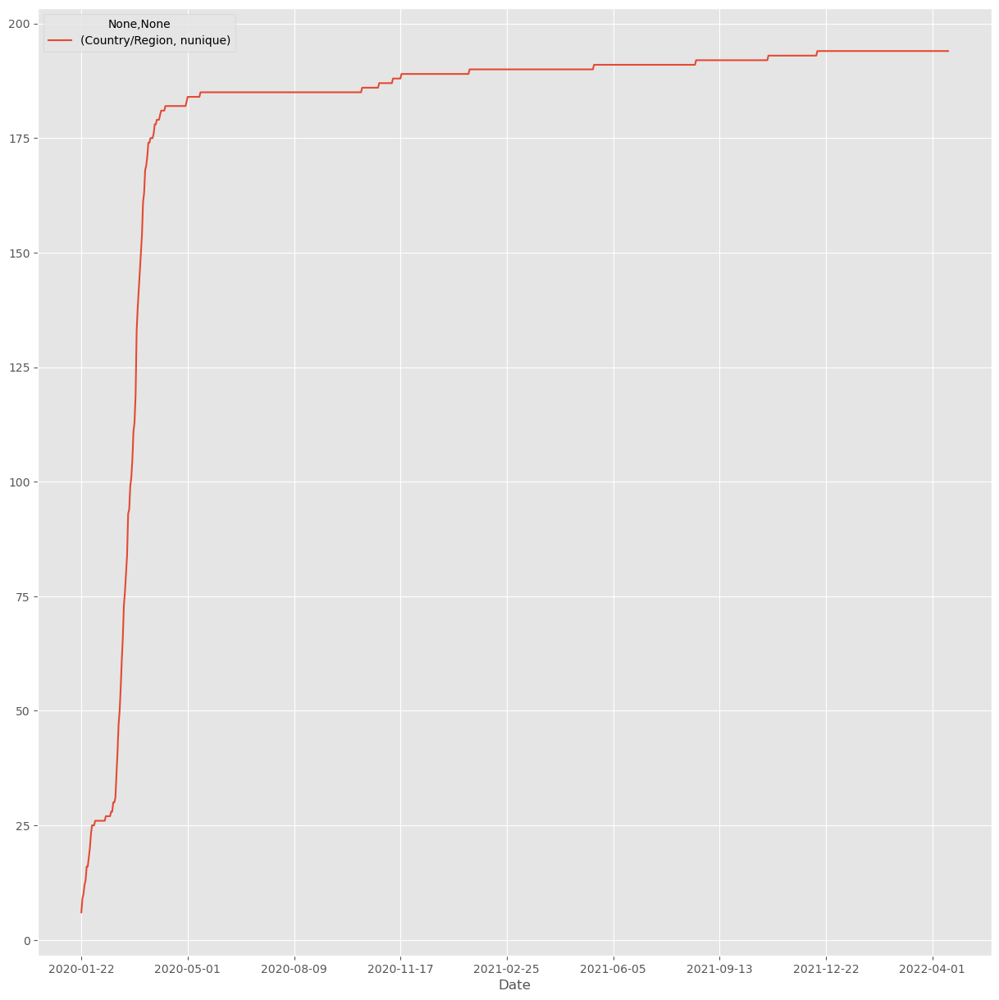

<Figure size 1000x1000 with 0 Axes>

In [ ]:
df1.groupby('Date').agg(agg_func_cnt).plot()
plt.figure(figsize=(10, 10))

Аналогично формируем срез и группируем уже по месяцам и строим график

In [ ]:
df2 = dfdr[dfdr.Confirmed > 0]
df2.groupby(df2.month_year).agg(agg_func_cnt)

,Country/Region
,nunique
month_year,
2020-01,23
2020-02,61
2020-03,178
2020-04,183
2020-05,185
2020-06,185
2020-07,185
2020-08,185


<Figure size 1000x1000 with 0 Axes>

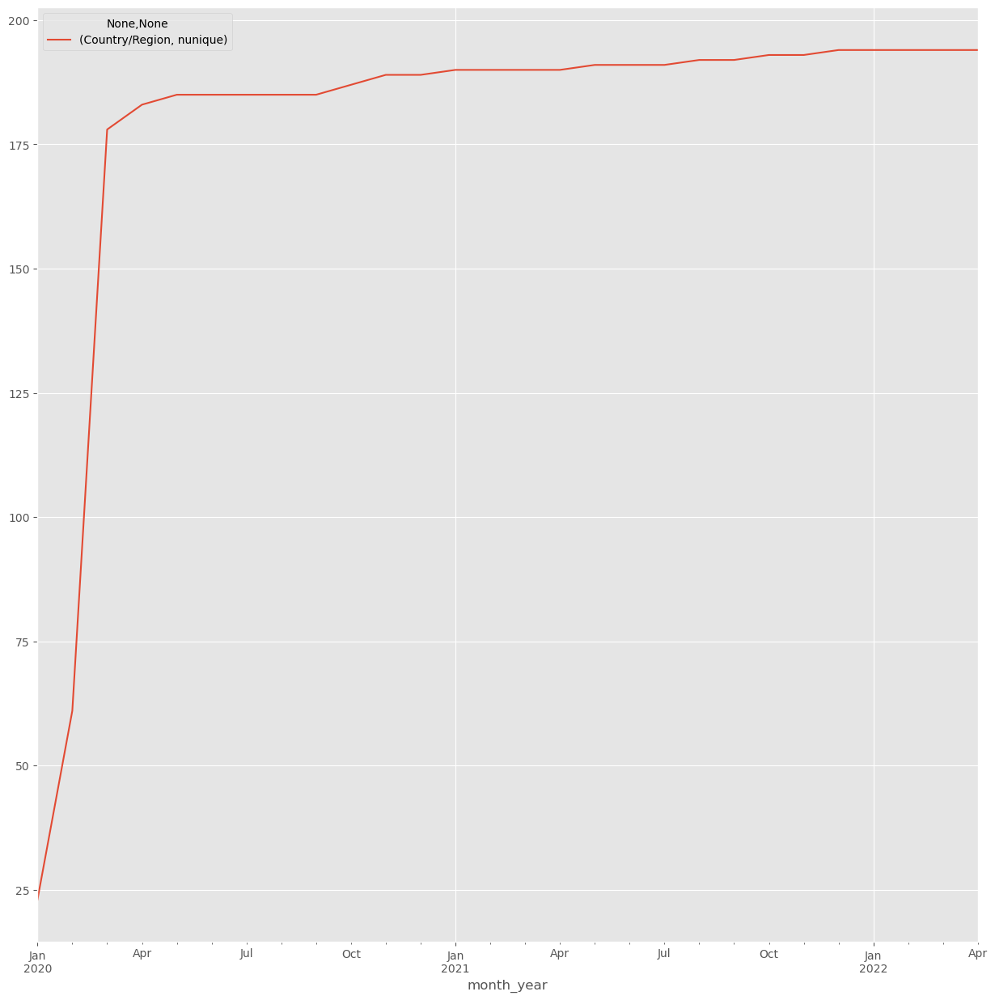

<Figure size 1000x1000 with 0 Axes>

In [ ]:
df2.groupby(df2.month_year).agg(agg_func_cnt).plot()
plt.figure(figsize=(10, 10))

По неделям

In [ ]:
df3 = dfdr[dfdr.Confirmed > 0]
df3.groupby(df3.week).agg(agg_func_cnt)

,Country/Region
,nunique
week,
2020-01-20/2020-01-26,13
2020-01-27/2020-02-02,25
2020-02-03/2020-02-09,26
2020-02-10/2020-02-16,27
2020-02-17/2020-02-23,31
...,...
2022-03-14/2022-03-20,194
2022-03-21/2022-03-27,194


<AxesSubplot:xlabel='week'>

<Figure size 1000x1000 with 0 Axes>

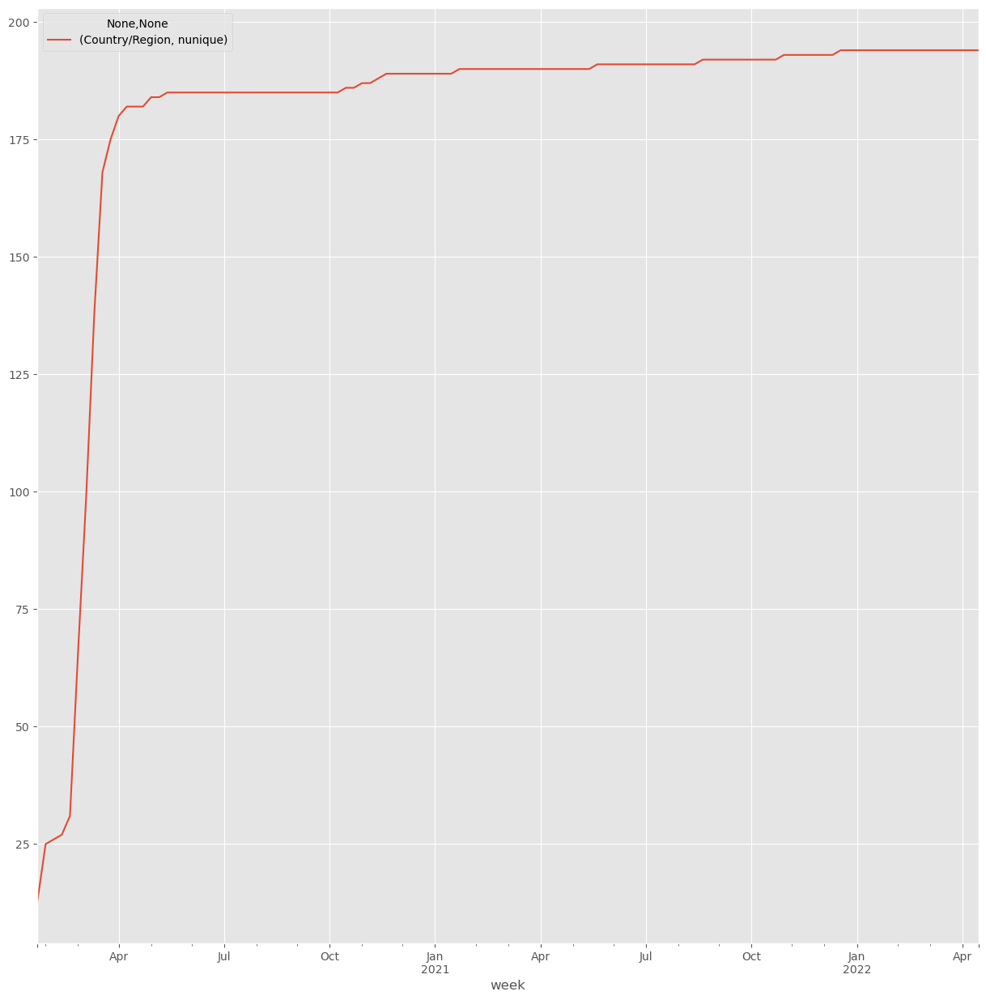

In [ ]:
plt.figure(figsize=(10, 10))
df3.groupby(df3.week).agg(agg_func_cnt).plot()

Построили графики и по ним видно, что с уменьшением частоты дискретизации график становится более плавным, смотря по месяцам нет таких ступенек, какие есть у дней и более плавные у недель.

#### 1.3. (5 баллов)

Визуализируйте мировые тренды по числу

- заболевших
- погибших
- выздоровивших.

Постройте графики, которые отражают летальность от вируса

- в разных странах
- на разных континентах.

Какие выводы можно сделать?

<AxesSubplot:xlabel='date'>

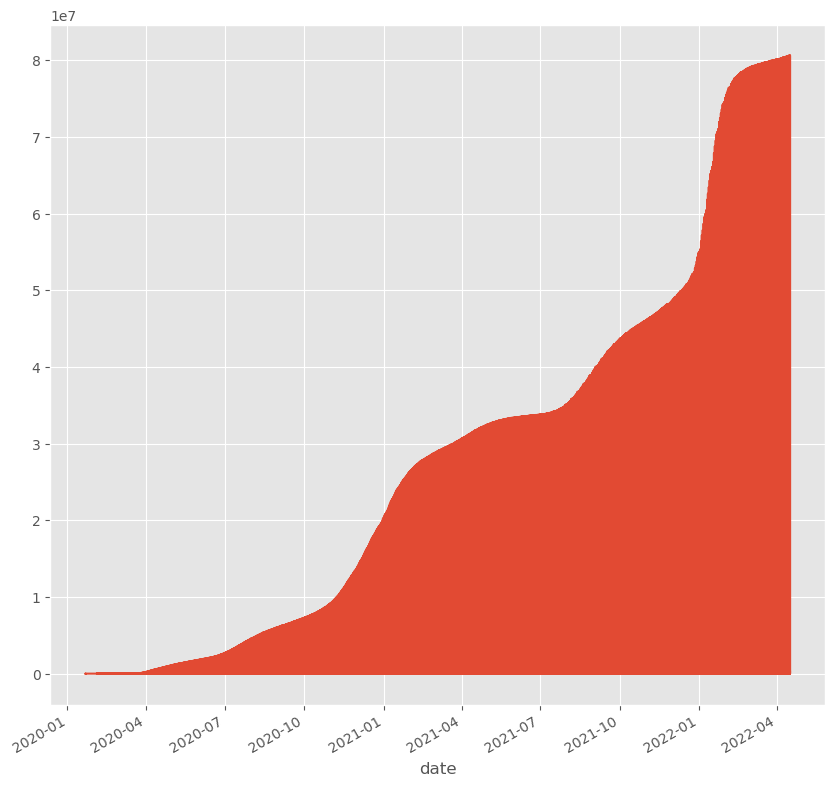

In [ ]:
plt.figure(figsize=(10,10))
dfdr.Confirmed.plot()

Число заболевших по дням

<AxesSubplot:xlabel='date'>

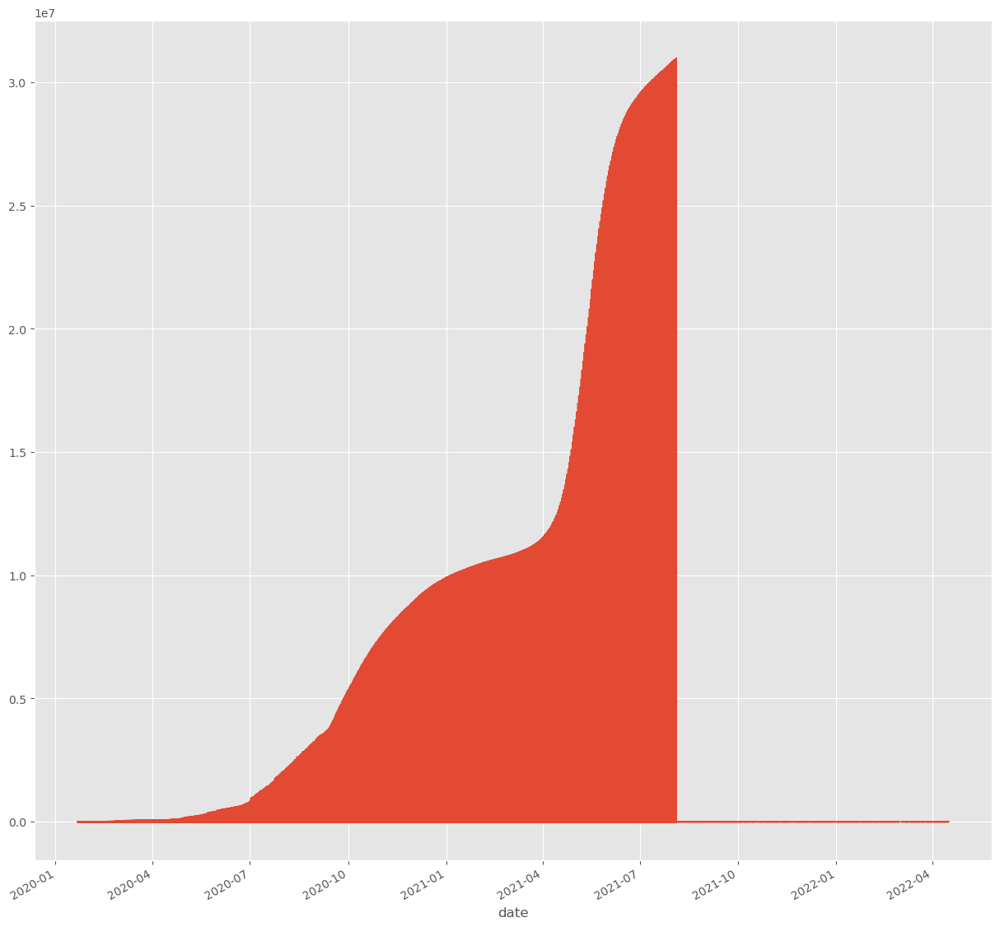

In [ ]:
dfdr.Recovered.plot()

Число выздоровевших по дням (где-то упала статистика видимо)
все криво, как и этот датасет (

<AxesSubplot:xlabel='date'>

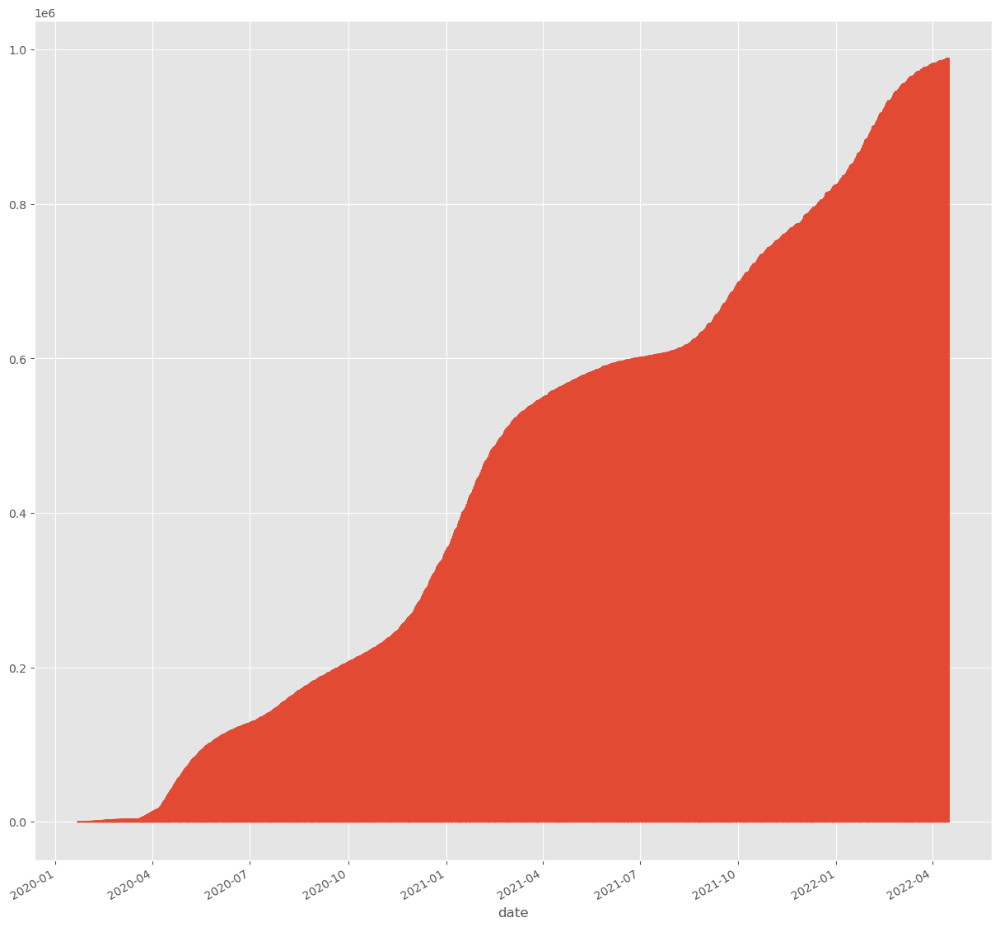

In [ ]:
dfdr.Deaths.plot()

суммарное число смертей по дням

Расформируем вручную страны по континентам, потому что я не нашла функцию ))))
Россию, Грузию и Турцию включим в Европу, тк в статистике по коронавирусу она входила туда
Я скопировала распределение из викпипедии, но умный человек, составлявший датасет сделал прикольно и названия некоторых стан не совпадают с общепринятым((((((((((((((((((((( Holy See вместо Ватикана очень прикольно и круто всем спасибо

In [ ]:
continents = {'Africa':['Algeria', 'Angola', 'Benin', 'Botswana', 'Burkina Faso', 'Burundi', 'Cameroon', 'Cabo Verde',
                        'Central African Republic', 'Chad', 'Comoros', 'Congo (Brazzaville)', 'Congo (Kinshasa)',
                        "Cote d'Ivoire",'Djibouti', 'Equatorial Guinea', 'Egypt', 'Eritrea', 'Ethiopia', 'Eswatini',
                        'Gabon', 'Gambia', 'Ghana','Guinea', 'Guinea-Bissau','Kenya', 'Lesotho', 'Liberia', 'Libya',
                        'Madagascar', 'Malawi', 'Mali','Mauritania', 'Mauritius', 'Morocco', 'Mozambique', 'Namibia',
                        'Niger', 'Nigeria', 'Rwanda', 'Sao Tome and Principe', 'Senegal', 'Seychelles', 'Sierra Leone',
                        'Somalia', 'South Africa','South Sudan', 'Sudan', 'Tanzania', 'Togo', 'Tunisia', 'Uganda',
                        'Zambia', 'Zimbabwe'],
              'Antarctica': ['Antarctica'],
              'Asia':['Afghanistan', 'Armenia', 'Azerbaijan', 'Bahrain', 'Bangladesh', 'Bhutan', 'Brunei', 'China',
                      'Timor-Leste', 'India', 'Indonesia', 'Iran', 'Iraq', 'Israel', 'Japan', 'Jordan',
                      'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Laos', 'Lebanon', 'Malaysia', 'Maldives', 'Mongolia',
                      'Burma', 'Nepal', 'Oman', 'Pakistan', 'Philippines', 'Qatar', 'Saudi Arabia', 'Singapore',
                      'Korea, South', 'Sri Lanka', 'Syria', 'Taiwan*', 'Tajikistan', 'Thailand',
                      'United Arab Emirates', 'Uzbekistan', 'Vietnam', 'Yemen', 'West Bank and Gaza', 'Cambodia'],
              'Europe': ['Albania', 'Andorra', 'Austria', 'Belarus', 'Belgium', 'Bosnia and Herzegovina',
                         'Bulgaria', 'Croatia', 'Cyprus', 'Czechia','Denmark','Estonia', 'Finland', 'France',
                         'Georgia', 'Germany', 'Greece', 'Hungary', 'Holy See', 'Iceland', 'Ireland', 'Italy',
                         'Kosovo','Latvia', 'Liechtenstein', 'Lithuania', 'Luxembourg','North Macedonia', 'Malta',
                         'Moldova', 'Monaco', 'Montenegro', 'Netherlands', 'Norway','Poland', 'Portugal', 'Romania',
                         'Russia', 'San Marino', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'Switzerland',
                         'Turkey','Ukraine', 'United Kingdom'],
              'North America': ['Canada', 'Mexico', 'US', 'Dominican Republic', 'Cuba', 'Haiti', 'Belize',
                                'Costa Rica', 'El Salvador', 'Guatemala', 'Honduras', 'Nicaragua', 'Panama', 'Jamaica',
                                'Bahamas', 'Barbados', 'Dominica', 'Antigua and Barbuda', 'Grenada',
                                'Saint Kitts and Nevis', 'Saint Lucia','Saint Vincent and the Grenadines'],
              'South America': ['Brazil', 'Argentina', 'Bolivia', 'Chile', 'Colombia', 'Ecuador','Guyana','Paraguay',
                                'Peru', 'Suriname', 'Trinidad and Tobago', 'Uruguay', 'Venezuela'],
              'Australia and Oceania': ['Australia', 'Fiji', 'New Zealand', 'Micronesia', 'Kiribati', 'Marshall Islands',
                                        'Palau', 'Papua New Guinea', 'Samoa', 'Solomon Islands', 'Tonga', 'Vanuatu']
             }

In [ ]:
def getcontinent(country):
    for i in continents.keys():
        if country in continents[i]:
            return i
            break


In [ ]:
print(getcontinent('Palau'))

Australia and Oceania


тут проверка моей функции была

In [ ]:
cont = list()
dfc = dfdr['Country/Region']
for i in range(dfdr.shape[0]):
    cont.append(getcontinent(dfc[i]))
dfdr['Continent'] = cont
dfdr.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent
date,,,,,,,,,
2020-01-22,2020-01-22,Afghanistan,NaN,0,0.00,0,2020-01,2020-01-20/2020-01-26,Asia
2020-01-22,2020-01-22,China,Hebei,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia
2020-01-22,2020-01-22,China,Hainan,4,0.00,0,2020-01,2020-01-20/2020-01-26,Asia
2020-01-22,2020-01-22,Tanzania,NaN,0,0.00,0,2020-01,2020-01-20/2020-01-26,Africa
2020-01-22,2020-01-22,China,Guizhou,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia


In [ ]:
cont1 = list()
dfc1 = drop['Country/Region'].to_numpy()
for i in range(drop.shape[0]):
    cont1.append(getcontinent(dfc1[i]))
drop['Continent'] = cont1
drop.tail()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,Continent
231739,2022-04-12,Zimbabwe,NaN,247094,0.00,5460,Africa
231740,2022-04-13,Zimbabwe,NaN,247160,0.00,5460,Africa
231741,2022-04-14,Zimbabwe,NaN,247208,0.00,5462,Africa
231742,2022-04-15,Zimbabwe,NaN,247237,0.00,5462,Africa
231743,2022-04-16,Zimbabwe,NaN,247237,0.00,5462,Africa


сделали столбец со значением континента

In [ ]:
dflast = dfdr[dfdr.Date == '2022-04-16']
dflast
dflast.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent
date,,,,,,,,,
2022-04-16,2022-04-16,Guinea,NaN,36502,0.00,440,2022-04,2022-04-11/2022-04-17,Africa
2022-04-16,2022-04-16,Yemen,NaN,11817,0.00,2148,2022-04,2022-04-11/2022-04-17,Asia
2022-04-16,2022-04-16,Cuba,NaN,1099444,0.00,8520,2022-04,2022-04-11/2022-04-17,North America
2022-04-16,2022-04-16,Croatia,NaN,1113135,0.00,15725,2022-04,2022-04-11/2022-04-17,Europe
2022-04-16,2022-04-16,Cote d'Ivoire,NaN,81857,0.00,797,2022-04,2022-04-11/2022-04-17,Africa


Есть три крутые страны - Китай, Австралия и Канада, в которых почему-то нет общей статистики, поэтому добавила строки с общей статистикой на 16 апреля 2022 года

In [ ]:
dflast[dflast['Country/Region'] == 'Canada'].Confirmed.sum()

3633948

In [ ]:
dflast[dflast['Country/Region'] == 'Canada'].Recovered.sum()

0.0

In [ ]:
dflast[dflast['Country/Region'] == 'Canada'].Deaths.sum()

38363

In [ ]:
dflast[dflast['Country/Region'] == 'China'].Confirmed.sum()

1760211

In [ ]:
dflast[dflast['Country/Region'] == 'China'].Recovered.sum()

0.0

In [ ]:
dflast[dflast['Country/Region'] == 'China'].Deaths.sum()

13748

In [ ]:
dflast[dflast['Country/Region'] == 'Australia'].Confirmed.sum()

5384615

In [ ]:
dflast[dflast['Country/Region'] == 'Australia'].Recovered.sum()

0.0

In [ ]:
dflast[dflast['Country/Region'] == 'Australia'].Deaths.sum()

6779

In [ ]:
dflast.loc[len(dflast.index)] = ['2022-04-16', 'Canada','' , 5384615, 0.0, 38363,
                                 '2022-04','2022-04-11/2022-04-1','North America']
dflast.loc[len(dflast.index)] = ['2022-04-16', 'Australia','' , 3633948, 0.0, 677,
                                 '2022-04','2022-04-11/2022-04-1','Australia and Oceania']
dflast.loc[len(dflast.index)] = ['2022-04-16', 'China','' , 1760211, 0.0, 13748,
                                 '2022-04','2022-04-11/2022-04-1','Asia']
dflast.index = pd.DatetimeIndex(dflast.Date)
dflast.tail()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent
Date,,,,,,,,,
2022-04-16,2022-04-16,Micronesia,NaN,1,0.00,0,2022-04,2022-04-11/2022-04-17,Australia and Oceania
2022-04-16,2022-04-16,Zimbabwe,NaN,247237,0.00,5462,2022-04,2022-04-11/2022-04-17,Africa
2022-04-16,2022-04-16,Canada,,5384615,0.00,38363,2022-04,2022-04-11/2022-04-1,North America
2022-04-16,2022-04-16,Australia,,3633948,0.00,677,2022-04,2022-04-11/2022-04-1,Australia and Oceania
2022-04-16,2022-04-16,China,,1760211,0.00,13748,2022-04,2022-04-11/2022-04-1,Asia


In [ ]:
data = dflast[(dflast['Province/State'].isnull()) | (dflast['Province/State'] == '')]
data.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent
Date,,,,,,,,,
2022-04-16,2022-04-16,Guinea,NaN,36502,0.00,440,2022-04,2022-04-11/2022-04-17,Africa
2022-04-16,2022-04-16,Yemen,NaN,11817,0.00,2148,2022-04,2022-04-11/2022-04-17,Asia
2022-04-16,2022-04-16,Cuba,NaN,1099444,0.00,8520,2022-04,2022-04-11/2022-04-17,North America
2022-04-16,2022-04-16,Croatia,NaN,1113135,0.00,15725,2022-04,2022-04-11/2022-04-17,Europe
2022-04-16,2022-04-16,Cote d'Ivoire,NaN,81857,0.00,797,2022-04,2022-04-11/2022-04-17,Africa


сделлали столбец с летальностью (отношение смертей к подтвержденным)

In [ ]:
data['lethality'] = data.Deaths / data.Confirmed

<AxesSubplot:ylabel='Country/Region'>

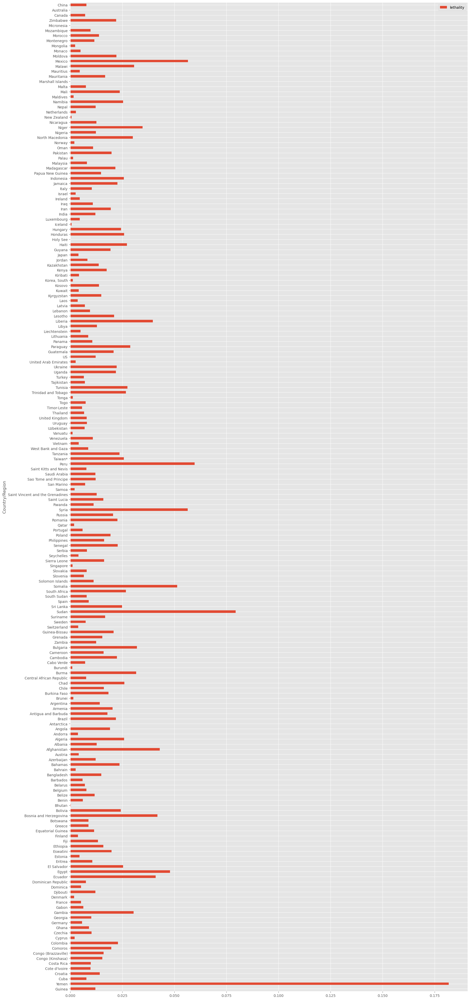

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (20, 50)
data.plot(kind = 'barh', x='Country/Region', y ='lethality')

In [ ]:
agg_func_1 = {'Confirmed':['sum'], 'Deaths':'sum'}

группируем по континентам, суммируя кол-во смертей и подтвержденных случаев заболевания с помощью агрегирующей функции

In [ ]:
data1 = data.groupby('Continent').agg(agg_func_1)
data1

,Confirmed,Deaths
,sum,sum
Continent,,
Africa,11607121,252483
Antarctica,11,0
Asia,129475705,1304839
Australia and Oceania,4606719,2928
Europe,203772989,1910244
North America,96852836,1419550
South America,56604142,1295521


In [ ]:
data1.reset_index(inplace=True)
data1

,Continent,Confirmed,Deaths
,,sum,sum
0,Africa,11607121,252483
1,Antarctica,11,0
2,Asia,129475705,1304839
3,Australia and Oceania,4606719,2928
4,Europe,203772989,1910244
5,North America,96852836,1419550
6,South America,56604142,1295521


In [ ]:
data1['lethality'] = data1.Deaths / data1.Confirmed

<AxesSubplot:ylabel='Continent'>

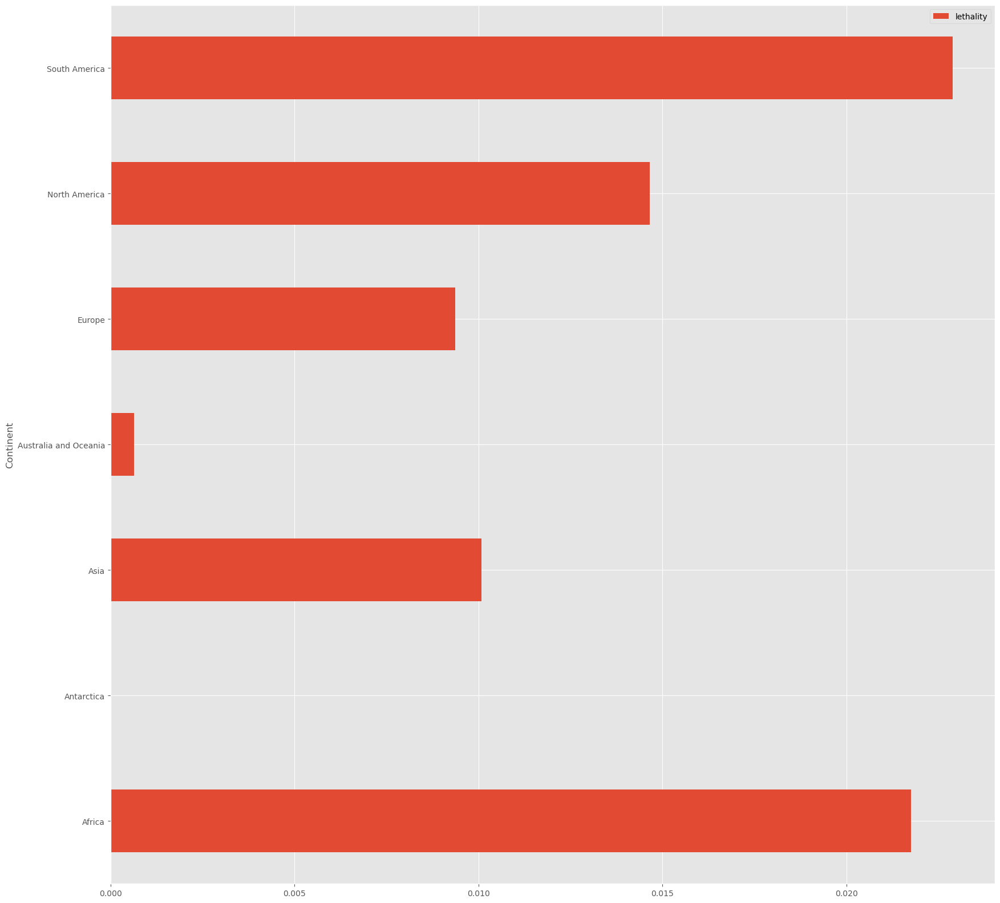

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (20, 20)
data1.plot(kind = 'barh', x='Continent', y ='lethality')

Наиболее высокая летальность в наименее развитых континетах - Африке и Южной Америке, из стран особенно выделяется Йемен, до Австралии и стран Океании будто бы вирус не дошел или слишком высокий иммунитет и мало кто умирает

#### 1.4. (5 баллов)

Визуализируйте и сравните, как распространялась болезнь в разных странах и на разных континентах по дням с первого зарегистрированного случая заболевания. Определите количество дней для каждой страны со дня первого зарегестрированного случая. Какие тенденции вы видите?

In [ ]:
dfdr1 = dfdr[dfdr.Confirmed > 0]

Делаем срез, в котором подтвержденных случаев > 0 и пивот-таблицу, в которой значения кол-ва заболевших по странам сопоставлены со странами и датами

In [ ]:
Pivot = pd.pivot_table(dfdr1, values = "Confirmed",
                             columns = "Country/Region", index = "Date")

In [ ]:
Pivot

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antarctica,Antigua and Barbuda,Argentina,Armenia,Australia,...,United Kingdom,Uruguay,Uzbekistan,Vanuatu,Venezuela,Vietnam,West Bank and Gaza,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
2020-01-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,2.00,NaN,NaN,NaN,NaN
2020-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,2.00,NaN,NaN,NaN,NaN
2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,2.00,NaN,NaN,NaN,NaN
2020-01-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.00,...,NaN,NaN,NaN,NaN,NaN,2.00,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-04-12,178257.00,274272.00,265730.00,40328.00,99194.00,11.00,7523.00,9056203.00,422691.00,650956.25,...,1680470.38,894630.00,238098.00,5536.00,521546.00,10272964.00,656617.00,11814.00,317804.00,247094.00
2022-04-13,178295.00,274320.00,265731.00,40709.00,99194.00,11.00,7523.00,9057923.00,422711.00,657794.88,...,1683352.23,894984.00,238176.00,5543.00,521714.00,10297587.00,656617.00,11815.00,318113.00,247160.00
2022-04-14,178352.00,274376.00,265733.00,40709.00,99194.00,11.00,7535.00,9059351.00,422721.00,663607.25,...,1685920.08,895240.00,238176.00,5543.00,521880.00,10320599.00,656617.00,11815.00,318229.00,247208.00


Строим график

<AxesSubplot:xlabel='Date'>

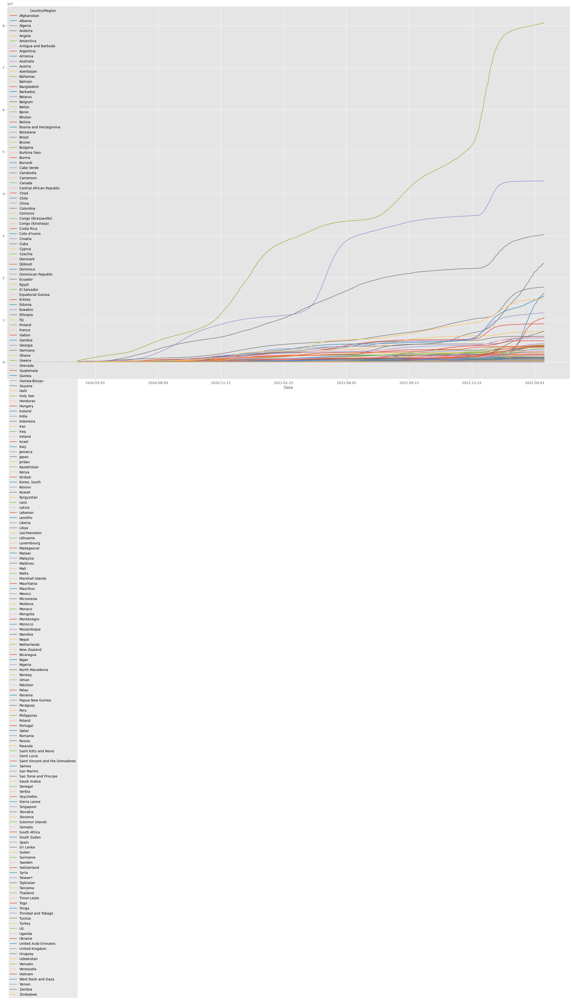

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivot.plot()

In [ ]:
Pivot1 = pd.pivot_table(dfdr1, values = "Confirmed",
                             columns = "Continent", index = "Date")
Pivot1.head()

Continent,Africa,Antarctica,Asia,Australia and Oceania,Europe,North America,South America
Date,,,,,,,
2020-01-22,NaN,NaN,19.86,NaN,NaN,1.00,NaN
2020-01-23,NaN,NaN,18.17,NaN,NaN,1.50,NaN
2020-01-24,NaN,NaN,25.32,NaN,2.00,2.50,NaN
2020-01-25,NaN,NaN,35.73,NaN,3.00,2.50,NaN
2020-01-26,NaN,NaN,52.62,2.00,3.00,4.00,NaN


Сгруппировали по континентам и странам и построили графики, видно, что быстрее всего развивается болезнь в Южной Америке

<AxesSubplot:xlabel='Date'>

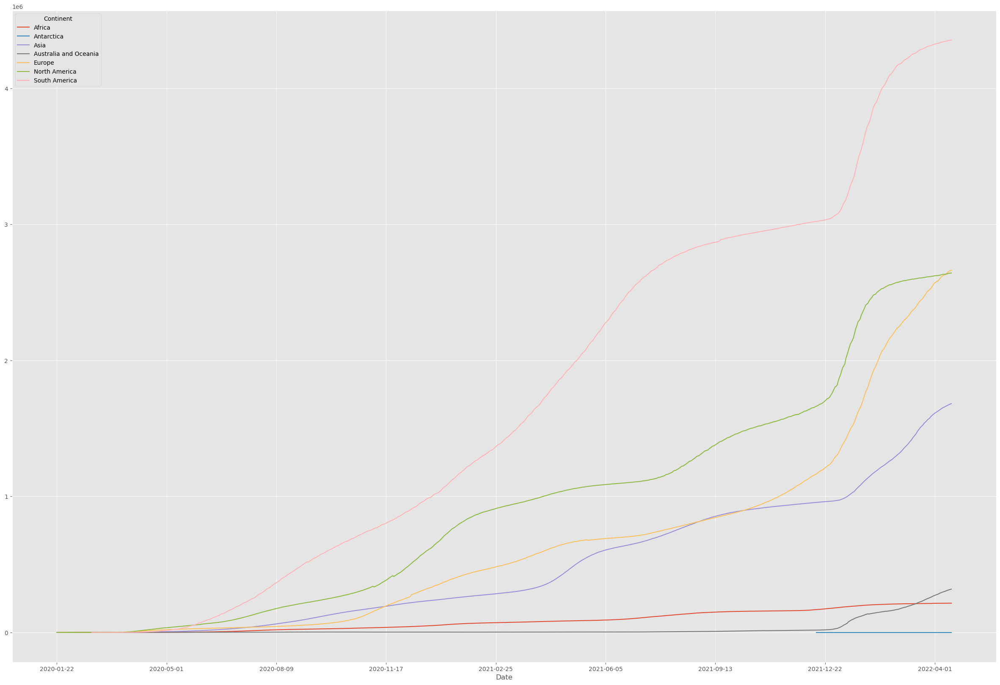

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivot1.plot()

Добавляем агрегирующую функцию, которая группирует по дате и ищет из нее минимум и максимум для каждой страны и считаем разницу между ними - количество дней

In [ ]:
agg_func_2 = {'Date': ['min', 'max']}
d1 = dfdr1.groupby('Country/Region').agg(agg_func_2)
d1.head()

Date            
                       min         max
Country/Region                        
Afghanistan     2020-02-24  2022-04-16
Albania         2020-03-09  2022-04-16
Algeria         2020-02-25  2022-04-16
Andorra         2020-03-02  2022-04-16
Angola          2020-03-20  2022-04-16

In [ ]:
d1.columns

MultiIndex([('Date', 'min'),
            ('Date', 'max')],
           )

In [ ]:

d1['cnt'] = pd.to_datetime(d1[('Date', 'max')]).dt.to_period('D').astype(int) - pd.to_datetime(d1[('Date','min')]).dt.to_period('D').astype(int)
d1.head()

Date              cnt
                       min         max     
Country/Region                             
Afghanistan     2020-02-24  2022-04-16  782
Albania         2020-03-09  2022-04-16  768
Algeria         2020-02-25  2022-04-16  781
Andorra         2020-03-02  2022-04-16  775
Angola          2020-03-20  2022-04-16  757

In [ ]:
d1.reset_index(inplace=True)
d1.head()

Country/Region        Date              cnt
                         min         max     
0    Afghanistan  2020-02-24  2022-04-16  782
1        Albania  2020-03-09  2022-04-16  768
2        Algeria  2020-02-25  2022-04-16  781
3        Andorra  2020-03-02  2022-04-16  775
4         Angola  2020-03-20  2022-04-16  757

<AxesSubplot:ylabel='Country/Region'>

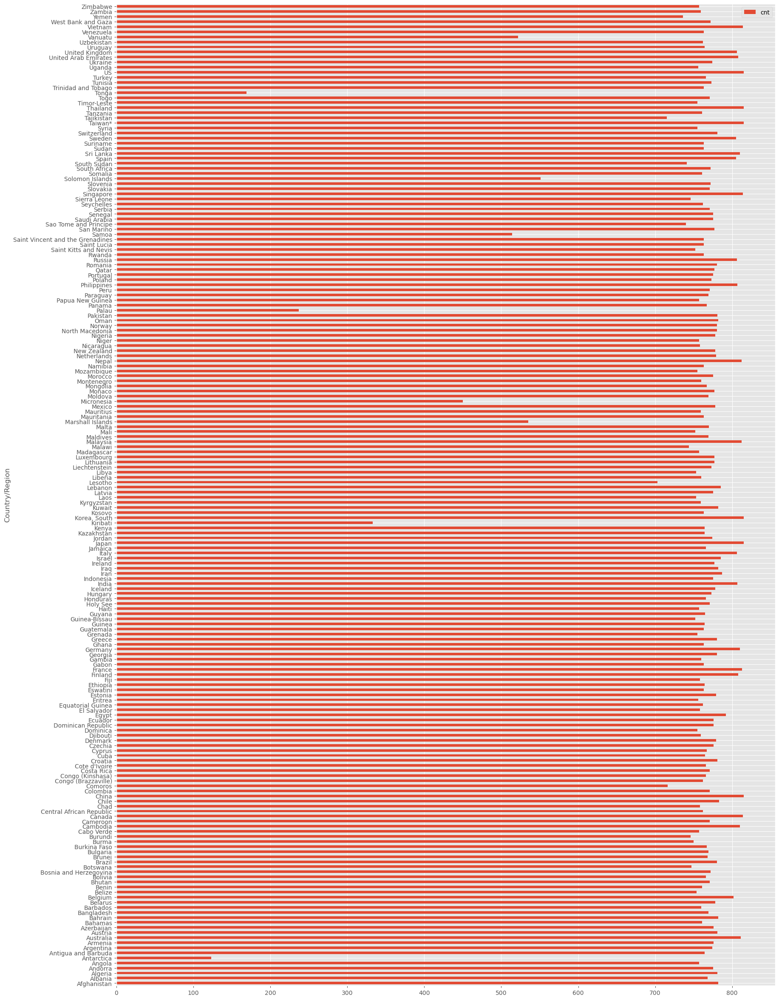

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (20, 30)
d1.plot(kind = 'barh', x='Country/Region', y ='cnt')

На удивление, дольше всего шла пандемия в Южной Кореее

#### 1.5. (5 баллов)

Визуализируйте и оцените как развивалась ситуация в России по сравнению с остальными миром. Как вы будете осуществлять сравнение? Почему? Какие выводы можно сделать?

Сравним Россию с Европой, поскольку ее уровень медицины +- такой же как в !среднем! по Европе (даже включая крутую Германию итд) и в нее вирус пришел скорее оттуда, чем из Азиатских стран

In [ ]:
dfRus = dfdr[(dfdr['Country/Region'] == 'Russia') &(dfdr.Confirmed > 0)]
dfRus
dfEurope = dfdr[(dfdr['Continent'] == 'Europe') & (dfdr['Country/Region'] != 'Russia') & (dfdr.Confirmed > 0)]
dfEurope

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent
date,,,,,,,,,
2020-01-24,2020-01-24,France,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,Europe
2020-01-25,2020-01-25,France,NaN,3,0.00,0,2020-01,2020-01-20/2020-01-26,Europe
2020-01-26,2020-01-26,France,NaN,3,0.00,0,2020-01,2020-01-20/2020-01-26,Europe
2020-01-27,2020-01-27,France,NaN,3,0.00,0,2020-01,2020-01-27/2020-02-02,Europe
2020-01-27,2020-01-27,Germany,NaN,1,0.00,0,2020-01,2020-01-27/2020-02-02,Europe
...,...,...,...,...,...,...,...,...,...
2022-04-16,2022-04-16,Netherlands,Aruba,34345,0.00,212,2022-04,2022-04-11/2022-04-17,Europe
2022-04-16,2022-04-16,Malta,NaN,88558,0.00,673,2022-04,2022-04-11/2022-04-17,Europe
2022-04-16,2022-04-16,Moldova,NaN,516316,0.00,11481,2022-04,2022-04-11/2022-04-17,Europe


In [ ]:
dfRus['Date'].min()

'2020-01-31'

Первый случай был подтвержден 31 января 2020 года

In [ ]:
agg_func_3 = {'Date': 'min'}
dfe = dfEurope.groupby('Country/Region').agg(agg_func_3)
dfe.reset_index(inplace=True)
dfe

,Country/Region,Date
0,Albania,2020-03-09
1,Andorra,2020-03-02
2,Austria,2020-02-25
3,Belarus,2020-02-28
4,Belgium,2020-02-04
5,Bosnia and Herzegovina,2020-03-05
6,Bulgaria,2020-03-08
7,Croatia,2020-02-25
8,Cyprus,2020-03-10
9,Czechia,2020-03-01


In [ ]:
dfe.Date.min()

'2020-01-24'

In [ ]:
dfe.Date.max()

'2020-03-17'

In [ ]:
dfe[dfe.Date <= '2020-01-31']['Country/Region'].nunique()

5

In [ ]:
dfe['Country/Region'].nunique()

47

В России появились случаи заражения коронавирусом одними из первых в Европе (6 страна)

In [ ]:
PivotE = pd.pivot_table(dfEurope, values = "Confirmed",
                             columns = "Country/Region", index = "Date")
PivotE

Country/Region,Albania,Andorra,Austria,Belarus,Belgium,Bosnia and Herzegovina,Bulgaria,Croatia,Cyprus,Czechia,...,San Marino,Serbia,Slovakia,Slovenia,Spain,Sweden,Switzerland,Turkey,Ukraine,United Kingdom
Date,,,,,,,,,,,,,,,,,,,,,
2020-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-04-12,274272.00,40328.00,4004069.00,970750.00,3943831.00,376264.00,1147165.00,1109847.00,461531.00,3872522.00,...,15779.00,1991620.00,2495855.00,990788.00,11627487.00,2491980.00,3568616.00,14972502.00,5040518.00,1680470.38
2022-04-13,274320.00,40709.00,4016540.00,971649.00,3943831.00,376339.00,1147812.00,1110989.00,462945.00,3875994.00,...,15827.00,1992677.00,2498938.00,992497.00,11627487.00,2491980.00,3568616.00,14978031.00,5040518.00,1683352.23
2022-04-14,274376.00,40709.00,4027023.00,972448.00,3972963.00,376384.00,1148362.00,1111823.00,464366.00,3875994.00,...,15874.00,1993661.00,2498938.00,994164.00,11627487.00,2495996.00,3568616.00,14983158.00,5040518.00,1685920.08


<AxesSubplot:xlabel='Date'>

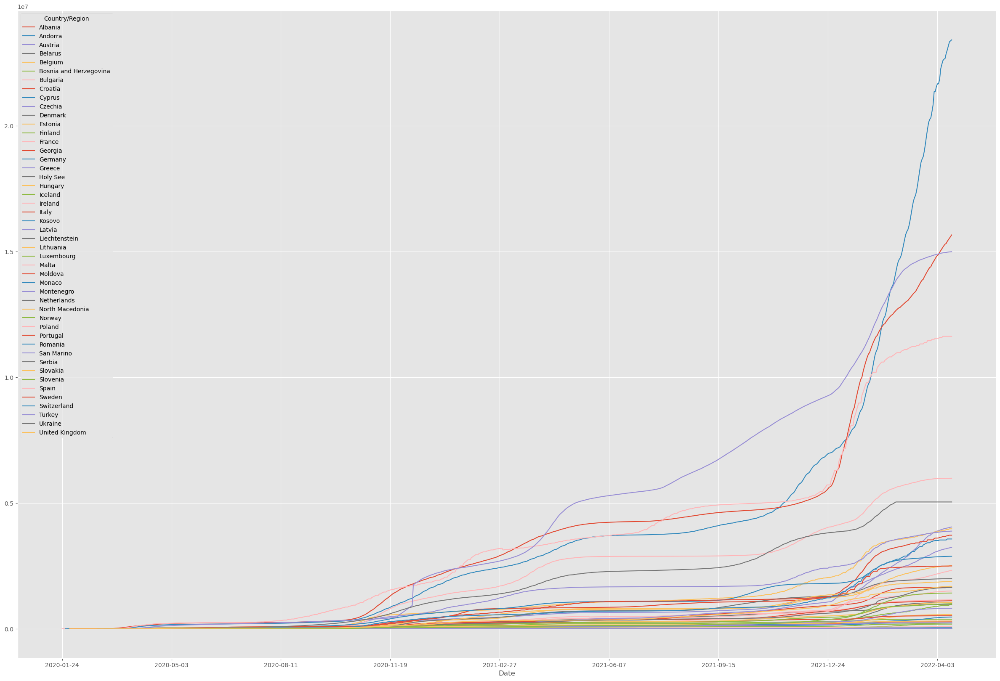

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
PivotE.plot()

<AxesSubplot:xlabel='date'>

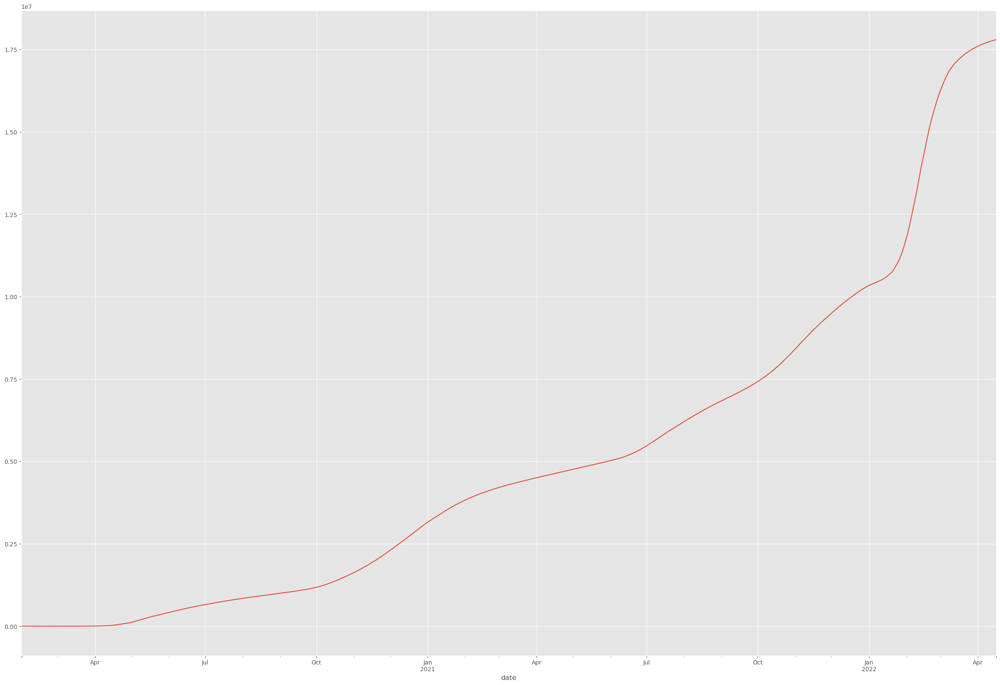

In [ ]:
dfRus.Confirmed.plot()

In [ ]:
agg_func_4 = {'Confirmed':'max'}
de1 = dfEurope.groupby(['Country/Region', 'Date', 'Deaths']).agg(agg_func_4)
de1.reset_index(inplace=True)
de1

,Country/Region,Date,Deaths,Confirmed
0,Albania,2020-03-09,0,2
1,Albania,2020-03-10,0,10
2,Albania,2020-03-11,1,12
3,Albania,2020-03-12,1,23
4,Albania,2020-03-13,1,33
...,...,...,...,...
53935,United Kingdom,2022-04-16,87,30169
53936,United Kingdom,2022-04-16,101,17494
53937,United Kingdom,2022-04-16,121,48529
53938,United Kingdom,2022-04-16,131,12901


In [ ]:
agg_func_5 = {'Confirmed':'mean', 'Deaths':'mean'}
de2 = dfEurope.groupby(['Date']).agg(agg_func_5)
de2.reset_index(inplace=True)
de2

,Date,Confirmed,Deaths
0,2020-01-24,2.00,0.00
1,2020-01-25,3.00,0.00
2,2020-01-26,3.00,0.00
3,2020-01-27,2.00,0.00
4,2020-01-28,4.00,0.00
...,...,...,...
809,2022-04-12,2443053.32,20335.49
810,2022-04-13,2449474.30,20359.13
811,2022-04-14,2456260.01,20379.87
812,2022-04-15,2459894.70,20388.49


In [ ]:
de2.index = pd.DatetimeIndex(de2.Date)
de2

,Date,Confirmed,Deaths
Date,,,
2020-01-24,2020-01-24,2.00,0.00
2020-01-25,2020-01-25,3.00,0.00
2020-01-26,2020-01-26,3.00,0.00
2020-01-27,2020-01-27,2.00,0.00
2020-01-28,2020-01-28,4.00,0.00
...,...,...,...
2022-04-12,2022-04-12,2443053.32,20335.49
2022-04-13,2022-04-13,2449474.30,20359.13
2022-04-14,2022-04-14,2456260.01,20379.87


<AxesSubplot:xlabel='date'>

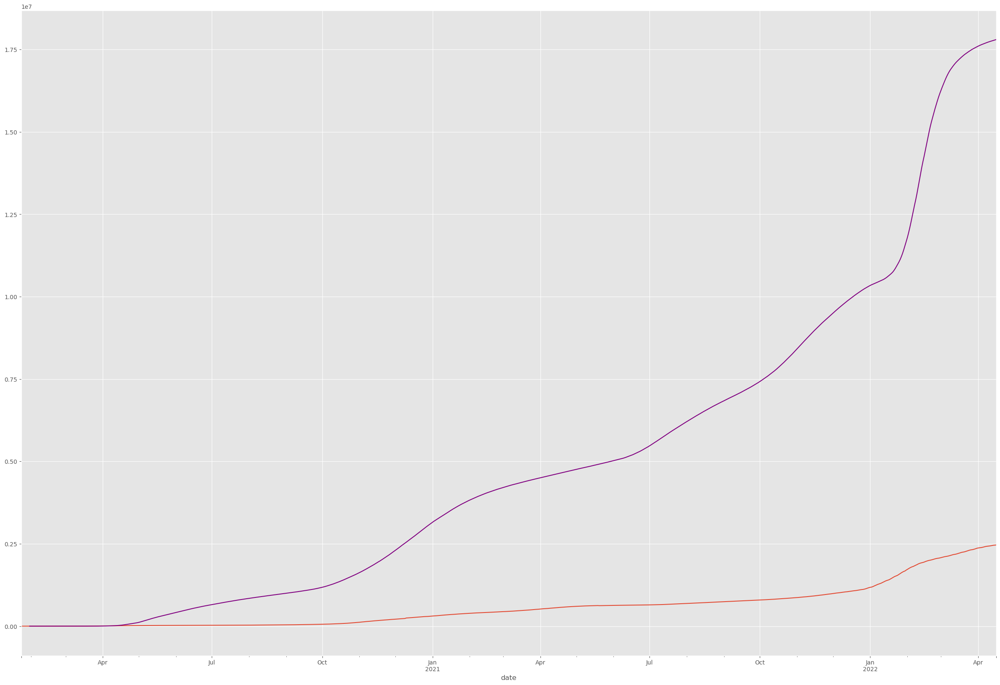

In [ ]:
de2.Confirmed.plot()
dfRus.Confirmed.plot(color='purple')

В России растет быстрее число заболевших, чем в среднем по Европе, возможно, потому что живет 140 млн человек....

In [ ]:
de2['lethality'] = (de2.Deaths / de2.Confirmed) * 100
de2

,Date,Confirmed,Deaths,lethality
Date,,,,
2020-01-24,2020-01-24,2.00,0.00,0.00
2020-01-25,2020-01-25,3.00,0.00,0.00
2020-01-26,2020-01-26,3.00,0.00,0.00
2020-01-27,2020-01-27,2.00,0.00,0.00
2020-01-28,2020-01-28,4.00,0.00,0.00
...,...,...,...,...
2022-04-12,2022-04-12,2443053.32,20335.49,0.83
2022-04-13,2022-04-13,2449474.30,20359.13,0.83
2022-04-14,2022-04-14,2456260.01,20379.87,0.83


In [ ]:
dfRus['lethality'] = (dfRus.Deaths / dfRus.Confirmed) * 100
dfRus

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality
date,,,,,,,,,,
2020-01-31,2020-01-31,Russia,NaN,2,0.00,0,2020-01,2020-01-27/2020-02-02,Europe,0.00
2020-02-01,2020-02-01,Russia,NaN,2,0.00,0,2020-02,2020-01-27/2020-02-02,Europe,0.00
2020-02-02,2020-02-02,Russia,NaN,2,0.00,0,2020-02,2020-01-27/2020-02-02,Europe,0.00
2020-02-03,2020-02-03,Russia,NaN,2,0.00,0,2020-02,2020-02-03/2020-02-09,Europe,0.00
2020-02-04,2020-02-04,Russia,NaN,2,0.00,0,2020-02,2020-02-03/2020-02-09,Europe,0.00
...,...,...,...,...,...,...,...,...,...,...
2022-04-12,2022-04-12,Russia,NaN,17756183,0.00,364779,2022-04,2022-04-11/2022-04-17,Europe,2.05
2022-04-13,2022-04-13,Russia,NaN,17767760,0.00,365038,2022-04,2022-04-11/2022-04-17,Europe,2.05
2022-04-14,2022-04-14,Russia,NaN,17778928,0.00,365285,2022-04,2022-04-11/2022-04-17,Europe,2.05


<AxesSubplot:xlabel='date'>

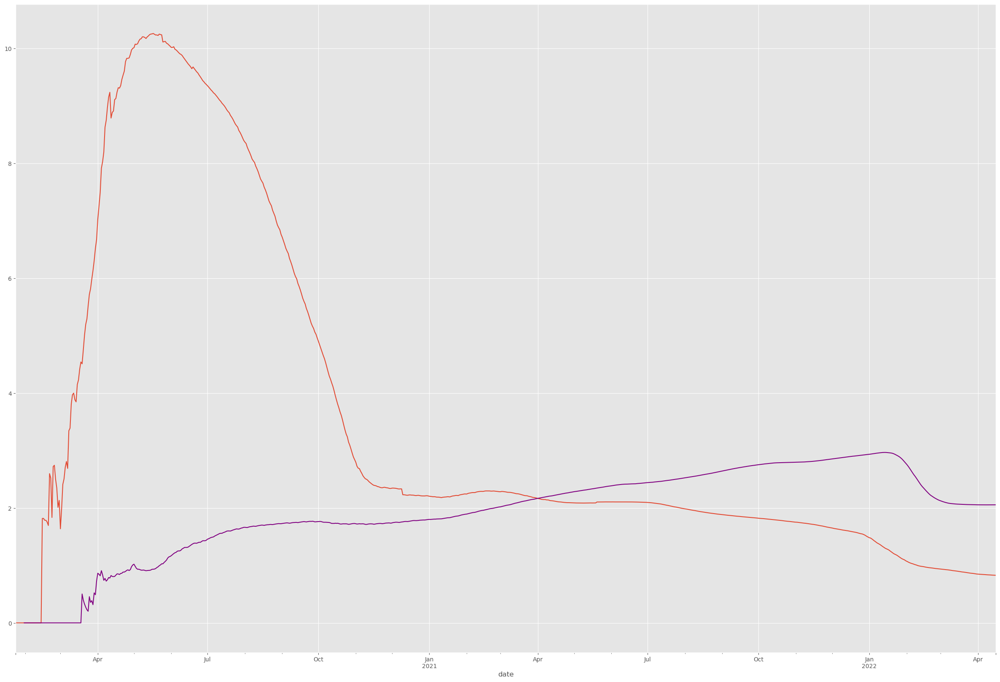

In [ ]:
de2.lethality.plot()
dfRus.lethality.plot(color='purple')

Видимо в России рисованная статистика и скорее всего просто в Европе к 2021 году улучшилась медицина и процент смерности уменьшился

#### 1.6. (5 баллов)

Определите топ-10 стран, которые лидируют по имеющимся в датасете показателям. Постоянны ли эти лидеры? За какой временной промежуток было бы наиболее правильно брать лидеров, на ваш взгляд? Почему? Сравните насколько быстро развивается ситуация в этих странах. Определите корреляцию.

In [ ]:
drop['lethality'] = drop.Deaths / drop.Confirmed

In [ ]:
dfdr1['lethality'] = dfdr1.Deaths / dfdr1.Confirmed
dfdr1

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality
date,,,,,,,,,,
2020-01-22,2020-01-22,China,Hebei,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
2020-01-22,2020-01-22,China,Hainan,4,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
2020-01-22,2020-01-22,China,Guizhou,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
2020-01-22,2020-01-22,China,Guangxi,2,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
2020-01-22,2020-01-22,Thailand,NaN,4,2.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
...,...,...,...,...,...,...,...,...,...,...
2022-04-16,2022-04-16,Montenegro,NaN,234137,0.00,2709,2022-04,2022-04-11/2022-04-17,Europe,0.01
2022-04-16,2022-04-16,Morocco,NaN,1164345,0.00,16062,2022-04,2022-04-11/2022-04-17,Africa,0.01
2022-04-16,2022-04-16,Mozambique,NaN,225323,0.00,2200,2022-04,2022-04-11/2022-04-17,Africa,0.01


In [ ]:
Pivotq = pd.pivot_table(dfdr1, values = "lethality",
                             columns = "Country/Region", index = "Date")
Pivotq

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antarctica,Antigua and Barbuda,Argentina,Armenia,Australia,...,United Kingdom,Uruguay,Uzbekistan,Vanuatu,Venezuela,Vietnam,West Bank and Gaza,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
2020-01-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-01-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.00,NaN,NaN,NaN,NaN
2020-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.00,NaN,NaN,NaN,NaN
2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.00,NaN,NaN,NaN,NaN
2020-01-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,...,NaN,NaN,NaN,NaN,NaN,0.00,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-04-12,0.04,0.01,0.03,0.00,0.02,0.00,0.02,0.01,0.02,0.00,...,0.00,0.01,0.01,0.00,0.01,0.00,0.01,0.18,0.01,0.02
2022-04-13,0.04,0.01,0.03,0.00,0.02,0.00,0.02,0.01,0.02,0.00,...,0.00,0.01,0.01,0.00,0.01,0.00,0.01,0.18,0.01,0.02
2022-04-14,0.04,0.01,0.03,0.00,0.02,0.00,0.02,0.01,0.02,0.00,...,0.00,0.01,0.01,0.00,0.01,0.00,0.01,0.18,0.01,0.02


In [ ]:
agg_func_0 = {'lethality':'mean'}
dq = dfdr1.groupby('Country/Region').agg(agg_func_0)
dq = dq.sort_values(by='lethality')
dq.tail(10)

,lethality
Country/Region,
Liberia,0.05
Egypt,0.05
Italy,0.06
Ecuador,0.06
Syria,0.06
Sudan,0.08
Mexico,0.08
Peru,0.10
Vanuatu,0.13


In [ ]:
dfw = dfdr1[dfdr1.Date == '2022-04-16']

In [ ]:
aggfunc = {'Confirmed':'max'}
dwh = dfw.groupby('Country/Region').agg(aggfunc)
dwh.reset_index(inplace=True)
dwh = dwh.sort_values(by='Confirmed')
dwh.tail(10)

,Country/Region,Confirmed
179,Turkey,14991669
85,Italy,15659835
92,"Korea, South",16305752
143,Russia,17801103
184,United Kingdom,21747638
66,Germany,23416663
62,France,26955613
24,Brazil,30250077
79,India,43042097
180,US,80625120


In [ ]:
aggfunc = {'Confirmed':'max'}
dwh1 = dfdr1[dfdr1.Date == '2020-04-16'].groupby('Country/Region').agg(aggfunc)
dwh1.reset_index(inplace=True)
dwh1 = dwh1.sort_values(by='Confirmed')
dwh1.tail(10)

,Country/Region,Confirmed
16,Belgium,34809
36,China,67803
168,Turkey,74193
79,Iran,77995
173,United Kingdom,111756
64,Germany,130450
60,France,144035
83,Italy,168941
154,Spain,184948
169,US,678028


Отсортируем и возьмем топ среди заболевших на последнее число

И на 16 апреля 2021 года, видим, что список стран поменялся!

Возьмем топ-10 на 16 апреля 2022 года

In [ ]:
dw10 = dfdr1[(dfdr1['Country/Region'] == 'US') | (dfdr1['Country/Region'] == 'India') |
             (dfdr1['Country/Region'] == 'Korea, South') | (dfdr1['Country/Region'] == 'Brazil') |
             (dfdr1['Country/Region'] == 'France') | (dfdr1['Country/Region'] == 'Germany') |
             (dfdr1['Country/Region'] == 'Russia') | (dfdr1['Country/Region'] == 'Italy') |
             (dfdr1['Country/Region'] == 'Turkey') | (dfdr1['Country/Region'] == 'United Kingdom')]
dw10

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality
date,,,,,,,,,,
2020-01-22,2020-01-22,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00
2020-01-22,2020-01-22,"Korea, South",NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
2020-01-23,2020-01-23,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00
2020-01-23,2020-01-23,"Korea, South",NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
2020-01-24,2020-01-24,"Korea, South",NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00
...,...,...,...,...,...,...,...,...,...,...
2022-04-16,2022-04-16,United Kingdom,British Virgin Islands,6162,0.00,62,2022-04,2022-04-11/2022-04-17,Europe,0.01
2022-04-16,2022-04-16,US,NaN,80625120,0.00,988609,2022-04,2022-04-11/2022-04-17,North America,0.01
2022-04-16,2022-04-16,"Korea, South",NaN,16305752,0.00,21092,2022-04,2022-04-11/2022-04-17,Asia,0.00


In [ ]:
Pivot10 = pd.pivot_table(dw10, values = "Confirmed",
                             columns = "Country/Region", index = "Date")
Pivot10

Country/Region,Brazil,France,Germany,India,Italy,"Korea, South",Russia,Turkey,US,United Kingdom
Date,,,,,,,,,,
2020-01-22,NaN,NaN,NaN,NaN,NaN,1.00,NaN,NaN,1.00,NaN
2020-01-23,NaN,NaN,NaN,NaN,NaN,1.00,NaN,NaN,1.00,NaN
2020-01-24,NaN,2.00,NaN,NaN,NaN,2.00,NaN,NaN,2.00,NaN
2020-01-25,NaN,3.00,NaN,NaN,NaN,2.00,NaN,NaN,2.00,NaN
2020-01-26,NaN,3.00,NaN,NaN,NaN,3.00,NaN,NaN,5.00,NaN
...,...,...,...,...,...,...,...,...,...,...
2022-04-12,30184286.00,2279435.42,23017079.00,43038016.00,15404809.00,15830644.00,17756183.00,14972502.00,80477797.00,1680470.38
2022-04-13,30210934.00,2291644.00,23182447.00,43039023.00,15467395.00,15979061.00,17767760.00,14978031.00,80518989.00,1683352.23
2022-04-14,30234024.00,2303107.67,23339311.00,43039972.00,15533012.00,16104869.00,17778928.00,14983158.00,80573532.00,1685920.08


<AxesSubplot:xlabel='Date'>

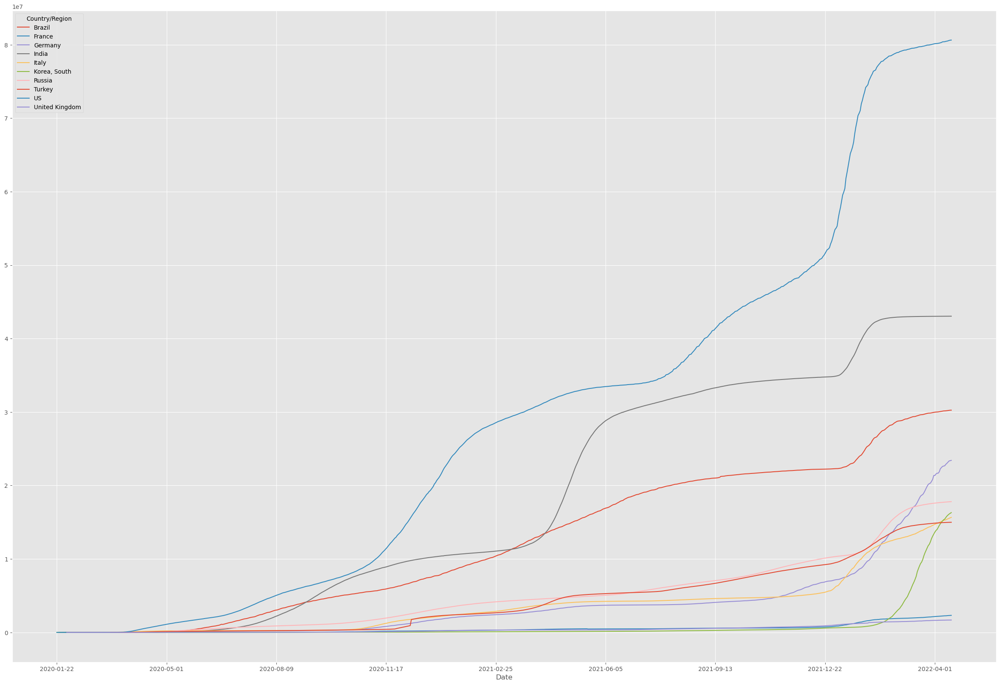

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivot10.plot()

Лучше брать период по сезонам - 2-3  месяца и за них смотреть лидера, поскольку обычно за этот промежуток меняются внешний факторы (таки как туризм, мероприятия итд)

#### 1.7. (5 баллов)

Для первых 5 стран из топ-10 из прошлого задания и России (суммарно 5 или 6 стран, в зависимости от того, входит ли Россия в топ) постройте сравнительные графики. Изучите как изменялись значения отношений
- погибших/выздоровивших
- погибших/заболевших
- заболевших/общее число жителей
- еще один ваш вариант (что будет осмысленно здесь взять?)

Какие выводы можно сделать из подобного сравнения?

In [ ]:
dw6 = dfdr1[(dfdr1['Country/Region'] == 'US') | (dfdr1['Country/Region'] == 'India') |
            (dfdr1['Country/Region'] == 'Brazil') | (dfdr1['Country/Region'] == 'France') |
            (dfdr1['Country/Region'] == 'Germany') | (dfdr1['Country/Region'] == 'Russia')]
dw6

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality
date,,,,,,,,,,
2020-01-22,2020-01-22,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00
2020-01-23,2020-01-23,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00
2020-01-24,2020-01-24,France,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,Europe,0.00
2020-01-24,2020-01-24,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00
2020-01-25,2020-01-25,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00
...,...,...,...,...,...,...,...,...,...,...
2022-04-16,2022-04-16,France,French Guiana,79529,0.00,394,2022-04,2022-04-11/2022-04-17,Europe,0.00
2022-04-16,2022-04-16,Brazil,NaN,30250077,0.00,662185,2022-04,2022-04-11/2022-04-17,South America,0.02
2022-04-16,2022-04-16,Russia,NaN,17801103,0.00,365774,2022-04,2022-04-11/2022-04-17,Europe,0.02


In [ ]:
dw6['d_to_r'] = dw6.Deaths / (dw6.Recovered)
dw6.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality,d_to_r
date,,,,,,,,,,,
2020-01-22,2020-01-22,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN
2020-01-23,2020-01-23,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN
2020-01-24,2020-01-24,France,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,Europe,0.00,NaN
2020-01-24,2020-01-24,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN
2020-01-25,2020-01-25,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN


In [ ]:
Pivotdr = pd.pivot_table(dw6, values = "d_to_r",
                             columns = "Country/Region", index = "Date")
Pivotdr

Country/Region,Brazil,France,Germany,India,Russia,US
Date,,,,,,
2020-02-09,NaN,NaN,NaN,NaN,NaN,0.00
2020-02-10,NaN,NaN,NaN,NaN,NaN,0.00
2020-02-11,NaN,NaN,NaN,NaN,NaN,0.00
2020-02-12,NaN,0.00,NaN,NaN,0.00,0.00
2020-02-13,NaN,0.00,0.00,NaN,0.00,0.00
...,...,...,...,...,...,...
2022-04-12,inf,NaN,inf,inf,inf,inf
2022-04-13,inf,NaN,inf,inf,inf,inf
2022-04-14,inf,NaN,inf,inf,inf,inf


<AxesSubplot:xlabel='Date'>

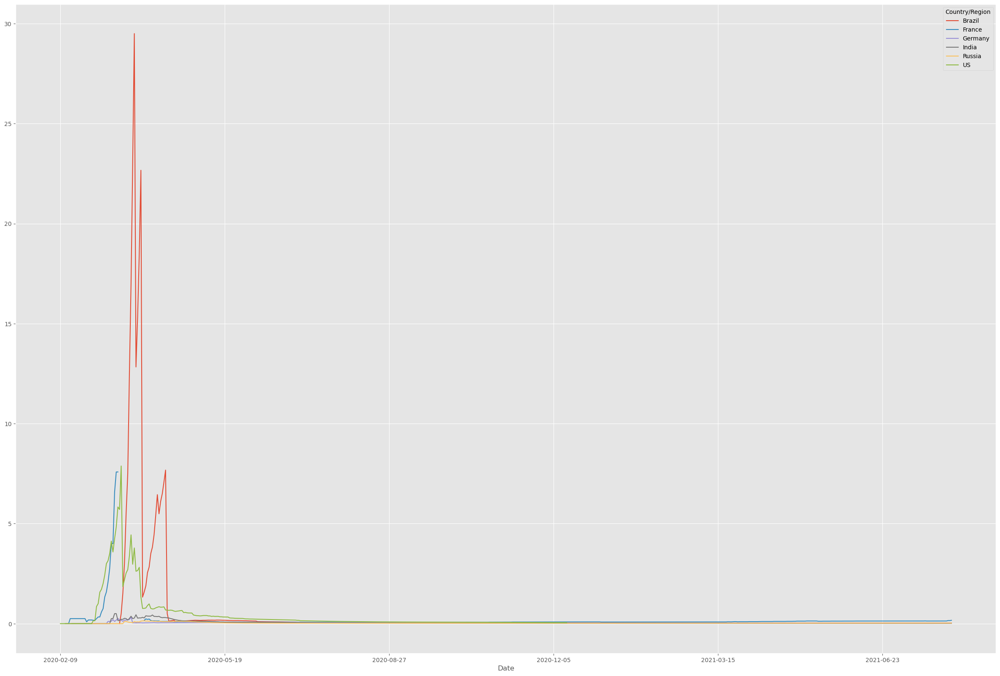

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivotdr.plot()

Высокий скачок у Бразили примерно в начале периода (самая высокая смертность), по некоторым странам не хватает статистики и есть разрывы, в Индиии и России самая низкая смертность. США - на втором месте после Бразилии.

In [ ]:
dw6['leth'] = dw6.Deaths / (dw6.Confirmed)
dw6.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality,d_to_r,leth
date,,,,,,,,,,,,
2020-01-22,2020-01-22,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00
2020-01-23,2020-01-23,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00
2020-01-24,2020-01-24,France,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,Europe,0.00,NaN,0.00
2020-01-24,2020-01-24,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00
2020-01-25,2020-01-25,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00


In [ ]:
Pivotleth = pd.pivot_table(dw6, values = "leth",
                             columns = "Country/Region", index = "Date")
Pivotleth

Country/Region,Brazil,France,Germany,India,Russia,US
Date,,,,,,
2020-01-22,NaN,NaN,NaN,NaN,NaN,0.00
2020-01-23,NaN,NaN,NaN,NaN,NaN,0.00
2020-01-24,NaN,0.00,NaN,NaN,NaN,0.00
2020-01-25,NaN,0.00,NaN,NaN,NaN,0.00
2020-01-26,NaN,0.00,NaN,NaN,NaN,0.00
...,...,...,...,...,...,...
2022-04-12,0.02,0.01,0.01,0.01,0.02,0.01
2022-04-13,0.02,0.01,0.01,0.01,0.02,0.01
2022-04-14,0.02,0.01,0.01,0.01,0.02,0.01


<AxesSubplot:xlabel='Date'>

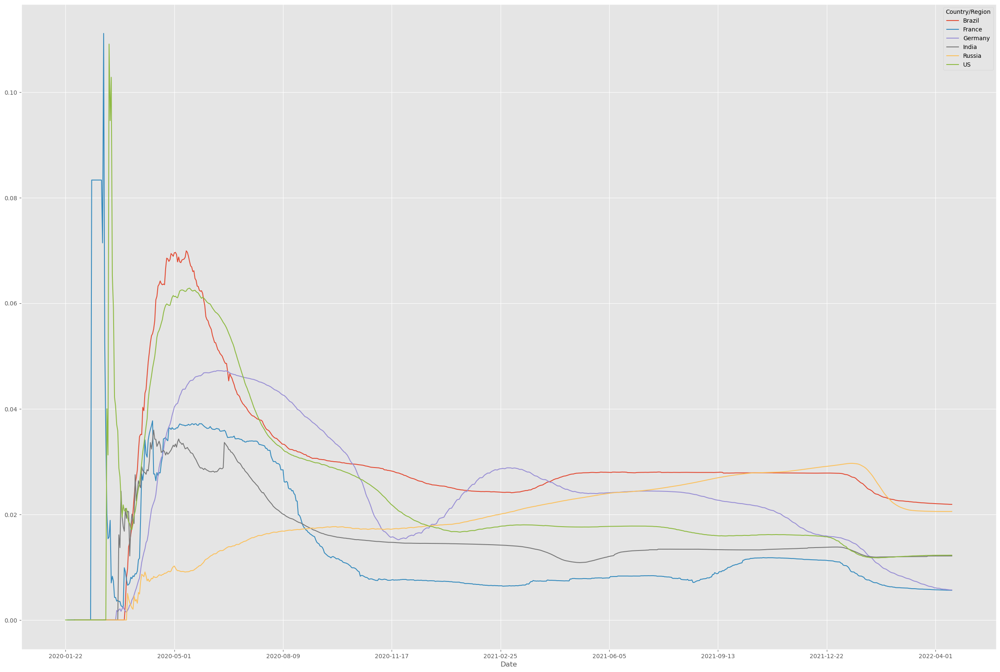

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivotleth.plot()

У Франции и Америки изначально был скачок вверх (где-то в феврале-марте), после чего во Франции стало резко умирать меньше людей, но все равно летом 20 года у обеих стран пошел новый пик - вторая волна, далее идет постепенный спад и стремление к инимальным значениям, причем Франция становится страной с минимальной смертностью. У оставшихся стран все пики пришлись на лето, причем у России самая сложная картина по сравнению с другими странами была в конце 21 - начале 22 года.

In [ ]:
cnt = pd.read_csv('population_by_country_2020.csv')
cnt.head()

,Country (or dependency),Population (2020),Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,China,1440297825,0.39 %,5540090,153,9388211,-348399.00,1.7,38,61 %,18.47 %
1,India,1382345085,0.99 %,13586631,464,2973190,-532687.00,2.2,28,35 %,17.70 %
2,United States,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %
3,Indonesia,274021604,1.07 %,2898047,151,1811570,-98955.00,2.3,30,56 %,3.51 %
4,Pakistan,221612785,2.00 %,4327022,287,770880,-233379.00,3.6,23,35 %,2.83 %


In [ ]:
cnt.columns

Index(['Country (or dependency)', 'Population (2020)', 'Yearly Change',
       'Net Change', 'Density (P/Km²)', 'Land Area (Km²)', 'Migrants (net)',
       'Fert. Rate', 'Med. Age', 'Urban Pop %', 'World Share'],
      dtype='object')

In [ ]:
cnt[(cnt['Country (or dependency)'] == 'Unites States') | (cnt['Country (or dependency)'] == 'France') |
    (cnt['Country (or dependency)'] == 'Germany') | (cnt['Country (or dependency)'] == 'Brazil') |
    (cnt['Country (or dependency)'] == 'India') | (cnt['Country (or dependency)'] == 'Russia')]

,Country (or dependency),Population (2020),Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
1,India,1382345085,0.99 %,13586631,464,2973190,-532687.00,2.2,28,35 %,17.70 %
5,Brazil,212821986,0.72 %,1509890,25,8358140,21200.00,1.7,33,88 %,2.73 %
8,Russia,145945524,0.04 %,62206,9,16376870,182456.00,1.8,40,74 %,1.87 %
18,Germany,83830972,0.32 %,266897,240,348560,543822.00,1.6,46,76 %,1.07 %
21,France,65298930,0.22 %,143783,119,547557,36527.00,1.9,42,82 %,0.84 %


In [ ]:
uspop = 331341050
rupop = 145945524
indpop = 1382345085
brpop = 212821986
gerpop = 83830972
frpop = 65298930

In [ ]:
live = list()
c = dw6['Country/Region'].to_numpy()
for i in c:
    if i == 'US':
        live.append(uspop)
    if i == 'Russia':
        live.append(rupop)
    if i == 'France':
        live.append(frpop)
    if i == 'India':
        live.append(indpop)
    if i == 'Brazil':
        live.append(brpop)
    if i == 'Germany':
        live.append(gerpop)
dw6['popu'] = live
dw6.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality,d_to_r,leth,popu
date,,,,,,,,,,,,,
2020-01-22,2020-01-22,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00,331341050
2020-01-23,2020-01-23,US,NaN,1,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00,331341050
2020-01-24,2020-01-24,France,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,Europe,0.00,NaN,0.00,65298930
2020-01-24,2020-01-24,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00,331341050
2020-01-25,2020-01-25,US,NaN,2,0.00,0,2020-01,2020-01-20/2020-01-26,North America,0.00,NaN,0.00,331341050


In [ ]:
dw6['ctopop'] = dw6.Confirmed / dw6.popu

In [ ]:
Pivotp = pd.pivot_table(dw6, values = "ctopop",
                             columns = "Country/Region", index = "Date")
Pivotp

Country/Region,Brazil,France,Germany,India,Russia,US
Date,,,,,,
2020-01-22,NaN,NaN,NaN,NaN,NaN,0.00
2020-01-23,NaN,NaN,NaN,NaN,NaN,0.00
2020-01-24,NaN,0.00,NaN,NaN,NaN,0.00
2020-01-25,NaN,0.00,NaN,NaN,NaN,0.00
2020-01-26,NaN,0.00,NaN,NaN,NaN,0.00
...,...,...,...,...,...,...
2022-04-12,0.14,0.03,0.27,0.03,0.12,0.24
2022-04-13,0.14,0.04,0.28,0.03,0.12,0.24
2022-04-14,0.14,0.04,0.28,0.03,0.12,0.24


<AxesSubplot:xlabel='Date'>

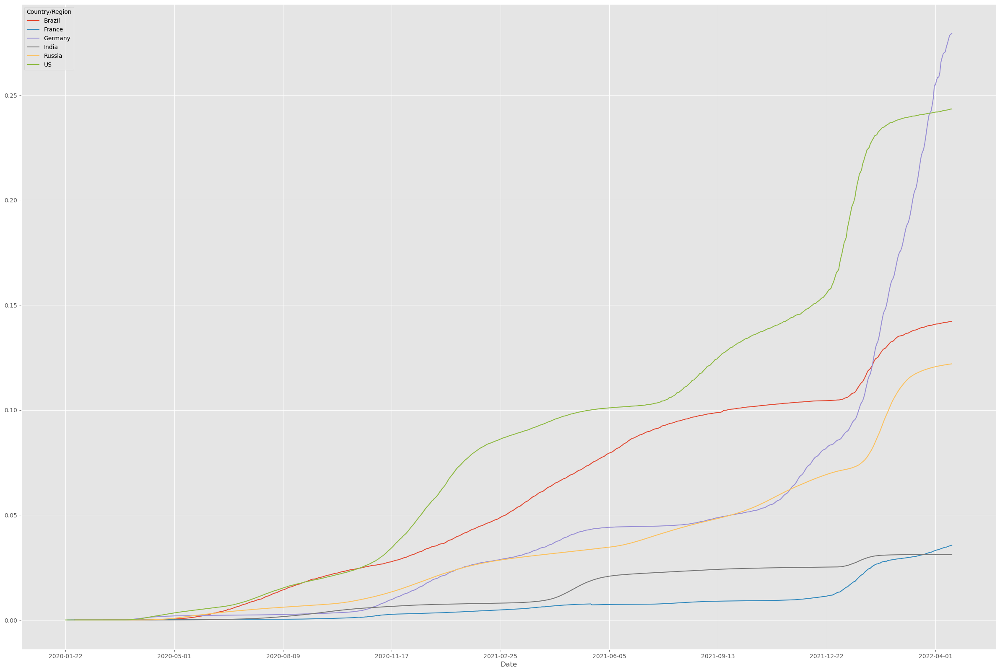

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivotp.plot()

В последний период прирост больше всего у Германии и Америки, как и доля заболевших людей к душе населения, что позволяет сделать вывод, что болезнь распрострянаяется там быстрее всего, а Россия на по данным показателям находится на 4 месте согласно графику. Кроме того с начала 2022 года в Германии резкий прирост заболевших по отношениюю к общему числу жителей.

смертей на душу населения (населения на 2020 год)

In [ ]:
dw6['dtopop'] = dw6.Deaths / dw6.popu

In [ ]:
Pivotdp = pd.pivot_table(dw6, values = "dtopop",
                             columns = "Country/Region", index = "Date")
Pivotdp

Country/Region,Brazil,France,Germany,India,Russia,US
Date,,,,,,
2020-01-22,NaN,NaN,NaN,NaN,NaN,0.00
2020-01-23,NaN,NaN,NaN,NaN,NaN,0.00
2020-01-24,NaN,0.00,NaN,NaN,NaN,0.00
2020-01-25,NaN,0.00,NaN,NaN,NaN,0.00
2020-01-26,NaN,0.00,NaN,NaN,NaN,0.00
...,...,...,...,...,...,...
2022-04-12,0.00,0.00,0.00,0.00,0.00,0.00
2022-04-13,0.00,0.00,0.00,0.00,0.00,0.00
2022-04-14,0.00,0.00,0.00,0.00,0.00,0.00


<AxesSubplot:xlabel='Date'>

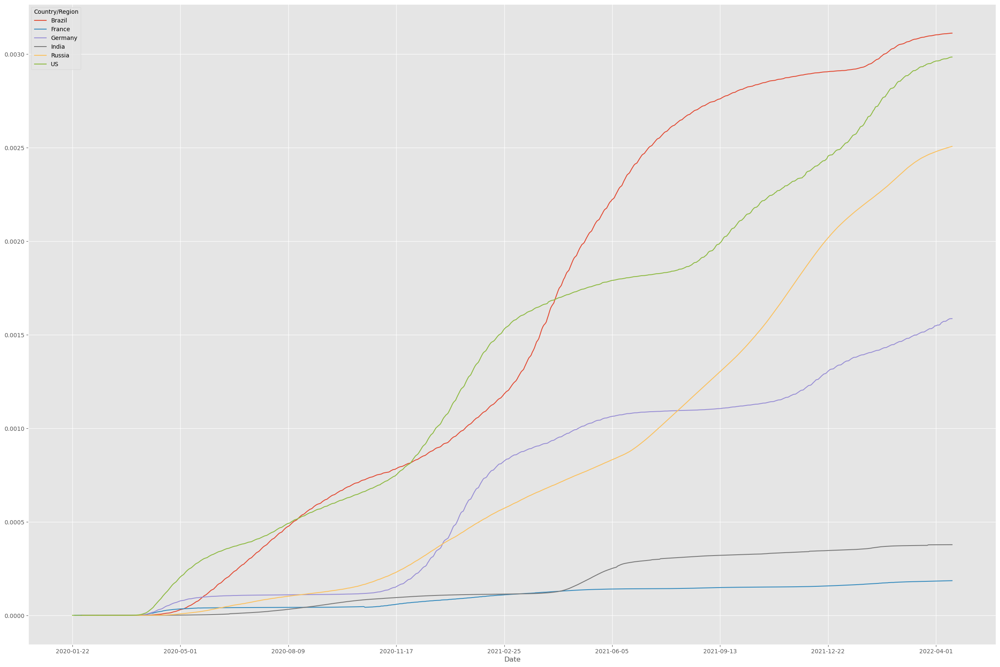

In [ ]:
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (30, 20)
Pivotdp.plot()

Быстрее всего "убывает" население в Бразилии и Америке, причем Бразилия "обогнала" Америку примерно весно 2021 года. На третьем месте по данным показателям Россия.

В самом начале пандемии высокая смертность  и излечимость была у Франции и США, когда Россия вошла в этот топ позже, а в последние моменты она то обгоняет, то опережает Бразилию, но скорее стабильно идет на втором месте.
Касаемо заражаемости на душу населения, то быстрее всего заражается население Германии, а Россия на 4 месте по данному показателю, а в смерности - уже на третьем после США и Бразилии, причем резкое возрастание началось с лета-начала осени 2021 года.

#### 1.8. (5 баллов и 15 бонусных баллов)

Изучаемый вами датасет отражает мировую статистику распространения болезни. Однако эти данные не дают нам возможности сделать предположения о возможных факторах, которые влияют на скорость распространения, летальность, заразность и тд. Поэтому в наш датасет можно добавить новые признаки из других наборов данных, которые могут не только помочь при прогнозировании временного ряда, но и определить наиболее значимые факторы.

- Добавьте новый признак "количество дней со дня первого случая заражения".
- Добавьте еще не менее 5 новых признаков в датасет, которые могут быть значимым фактором распространения вируса. Сохраните полученный датасет. Вы можете его использовать в третьей части домашнего задания (за это вы сможете получить там дополнительные бонусные баллы).
- Исследуйте, как добавленные признаки соотносятся с трендами распространения короновируса в некоторых странах. Сделайте выводы.

*Подсказка: некоторые примеры признаков (список далеко не исчерпывающий и лучше хотя бы несколько придумать своих): количество дней с начала карантина; конинент; плотность населения; количество употребляемого алкоголя; распространенность летучих мышей; количество крокодилов на душу населения; количество туристов в год; уровень безработицы; температура; количество игроков в Plague Inc.; средний возраст или продолжительность жизни; и так далее. Вы можете использовать любой найденный датасет. Главное, чтобы у Вас получилось скомбинировать данные.*

  Примеры датасетов для вас:
  1. [500 Cities: Local Data for Better Health (2019)](https://www.kaggle.com/jaimeblasco/500-cities-local-data-for-better-health-2019)
  2. [Daily global surface summary from over 9000 weather stations from 1929 to now](https://www.kaggle.com/noaa/gsod)
  3. [Population by Country - 2020](https://www.kaggle.com/tanuprabhu/population-by-country-2020)



In [ ]:
aggfuncd = {'Date': 'min'}
new = (dfdr1.groupby('Country/Region').agg(aggfuncd)).reset_index()
new

,Country/Region,Date
0,Afghanistan,2020-02-24
1,Albania,2020-03-09
2,Algeria,2020-02-25
3,Andorra,2020-03-02
4,Angola,2020-03-20
...,...,...
189,Vietnam,2020-01-23
190,West Bank and Gaza,2020-03-05
191,Yemen,2020-04-10
192,Zambia,2020-03-18


In [ ]:
new.Date.unique()

array(['2020-02-24', '2020-03-09', '2020-02-25', '2020-03-02',
       '2020-03-20', '2021-12-14', '2020-03-13', '2020-03-03',
       '2020-03-01', '2020-01-26', '2020-03-16', '2020-03-08',
       '2020-03-17', '2020-02-28', '2020-02-04', '2020-03-23',
       '2020-03-06', '2020-03-11', '2020-03-05', '2020-03-30',
       '2020-02-26', '2020-03-10', '2020-03-27', '2020-03-31',
       '2020-01-27', '2020-01-23', '2020-03-15', '2020-03-19',
       '2020-02-23', '2020-01-22', '2020-04-30', '2020-03-12',
       '2020-02-27', '2020-03-18', '2020-03-22', '2020-02-14',
       '2020-03-21', '2020-03-14', '2020-01-29', '2020-01-24',
       '2020-03-25', '2020-03-04', '2020-01-30', '2020-02-19',
       '2020-02-29', '2020-02-21', '2020-01-31', '2021-05-18',
       '2020-03-24', '2020-05-13', '2020-04-02', '2020-01-25',
       '2020-03-07', '2020-10-28', '2021-01-21', '2021-08-22',
       '2020-11-18', '2020-04-06', '2020-10-12', '2020-04-05',
       '2020-02-01', '2020-05-01', '2021-10-29', '2020-

In [ ]:
countr = new['Country/Region'].to_numpy()
dates = new.Date.to_numpy()
q = {}
for i in range(194):
    q[countr[i]] = dates[i]

In [ ]:
col = list()
s = dfdr1['Country/Region'].to_numpy()
for i in range(len(s)):
    col.append(q[s[i]])
dfdr1['first day'] = col
dfdr1.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality,first day
date,,,,,,,,,,,
2020-01-22,2020-01-22,China,Hebei,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00,2020-01-22
2020-01-22,2020-01-22,China,Hainan,4,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00,2020-01-22
2020-01-22,2020-01-22,China,Guizhou,1,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00,2020-01-22
2020-01-22,2020-01-22,China,Guangxi,2,0.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00,2020-01-22
2020-01-22,2020-01-22,Thailand,NaN,4,2.00,0,2020-01,2020-01-20/2020-01-26,Asia,0.00,2020-01-22


In [ ]:
dfdr1['days'] = pd.to_datetime(dfdr1.Date).dt.to_period('D').astype(int) - pd.to_datetime(dfdr1['first day']).dt.to_period('D').astype(int)

In [ ]:
dfdr1.tail()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent,lethality,first day,days
date,,,,,,,,,,,,
2022-04-16,2022-04-16,Montenegro,NaN,234137,0.00,2709,2022-04,2022-04-11/2022-04-17,Europe,0.01,2020-03-17,760
2022-04-16,2022-04-16,Morocco,NaN,1164345,0.00,16062,2022-04,2022-04-11/2022-04-17,Africa,0.01,2020-03-02,775
2022-04-16,2022-04-16,Mozambique,NaN,225323,0.00,2200,2022-04,2022-04-11/2022-04-17,Africa,0.01,2020-03-22,755
2022-04-16,2022-04-16,Micronesia,NaN,1,0.00,0,2022-04,2022-04-11/2022-04-17,Australia and Oceania,0.00,2021-01-21,450
2022-04-16,2022-04-16,Zimbabwe,NaN,247237,0.00,5462,2022-04,2022-04-11/2022-04-17,Africa,0.02,2020-03-20,757


In [ ]:
dfdr = dfdr.sort_values(by ='Country/Region')
dfdr.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,month_year,week,Continent
date,,,,,,,,,
2020-01-22,2020-01-22,Afghanistan,NaN,0,0.00,0,2020-01,2020-01-20/2020-01-26,Asia
2021-07-15,2021-07-15,Afghanistan,NaN,137853,82586.00,5983,2021-07,2021-07-12/2021-07-18,Asia
2020-02-15,2020-02-15,Afghanistan,NaN,0,0.00,0,2020-02,2020-02-10/2020-02-16,Asia
2021-07-16,2021-07-16,Afghanistan,NaN,139051,82586.00,6072,2021-07,2021-07-12/2021-07-18,Asia
2021-07-17,2021-07-17,Afghanistan,NaN,140224,82586.00,6098,2021-07,2021-07-12/2021-07-18,Asia


In [ ]:
cr = drop['Country/Region'].to_numpy()
conf = drop.Confirmed.to_numpy()
d = drop.Deaths.to_numpy()

In [ ]:
difc = list()
difd = list()
difc.append(0)
difd.append(0)
for i in range(1, dfdr.shape[0]):
    if (cr[i] == cr[i - 1]):
        difc.append(abs(conf[i] - conf[i - 1]))
        difd.append(d[i] - d[i - 1])
    else:
        difc.append(0)
        difd.append(0)
drop['PlusConf'] = difc
drop['PlusDeaths'] = difd

Добавила столбец со прибавлением по сравнению с пред днем кол-ва заболевших и смертей

#### 1.9. (5 баллов)

Какие закономерности и тенденции бросились вам в глаза в ходе проделанного в разделе 1 анализа? Что оказалось неожиданным, а что, наоборот, ожидаемым? Почему? Напишите итоговые выводы по проделанному вами первичному анализу данных в рамках данного раздела.

1) Неожиданно, что в Китае длилась болезнь меньше, чем в Южной Корее (возможно в начале января в Китае просто уже перестали выявлять случаи заболевания, тк там сразу же были жесткие ограничения)
2) Среди топа по заболевшим у Бразилиии процент заболеваемости населения наиболее высокий, помимо этого он довольно быстро растет
3) Больше всего людей заразилось и умерло в Южной Америке и Африке, что неудивительно, поскольку страны там преимущественно бедные и царит антисанитария.
4) Удивительно, что страны Океании (Австралия, Микронезия итд) подтверждают небольшой процент заболеваний и их будто не видно в статистике, как будто они оторваны от всего мира

## Раздел 2. Статистический анализ и подготовка данных (28 баллов)


#### 2.1. (5 баллов)

В рамках задачи исследования и прогнозирования тенденций развития пандемии коронавируса, не очень интересно предсказывать количество заболевших/умерших к моменту окончания исследуемого периода данного датасета, поскольку все изменения значений будут близки к нулю - пандемия фактически уже окончилась. Какой в таком случае конец "известного" периода имело бы смысл взять?

Также, с другой стороны: все ли данные от начала пандемии нам необходимы и полезны для анализа и прогнозирования? Почему? Обрежьте наш датасет с конца и (если необходимо) с начала, выделив тем самым интересующий нас рабочий период для анализа. Обязательно аргументируйте, почему вы решили взять период именно таким. Обрезку, на всякий случай, осуществляйте в копии датасета и сохраните исходный датасет на случай необходимости дополнительного анализа/анализа на других временных интервалах.

Конец периода - пик развития пандемии, полезны не все данные, тк где-то нет подтвержденных случаев заболевания итд

In [ ]:
dfdr1['first day'].unique()

array(['2020-01-22', '2020-01-23', '2020-01-24', '2020-01-25',
       '2020-01-26', '2020-01-27', '2020-01-29', '2020-01-30',
       '2020-01-31', '2020-02-01', '2020-02-04', '2020-02-14',
       '2020-02-19', '2020-02-21', '2020-02-23', '2020-02-24',
       '2020-02-25', '2020-02-26', '2020-02-27', '2020-02-28',
       '2020-02-29', '2020-03-01', '2020-03-02', '2020-03-03',
       '2020-03-04', '2020-03-05', '2020-03-06', '2020-03-07',
       '2020-03-08', '2020-03-09', '2020-03-10', '2020-03-11',
       '2020-03-12', '2020-03-13', '2020-03-14', '2020-03-15',
       '2020-03-16', '2020-03-17', '2020-03-18', '2020-03-19',
       '2020-03-20', '2020-03-21', '2020-03-22', '2020-03-23',
       '2020-03-24', '2020-03-25', '2020-03-27', '2020-03-30',
       '2020-03-31', '2020-04-02', '2020-04-05', '2020-04-06',
       '2020-04-10', '2020-04-30', '2020-05-01', '2020-05-13',
       '2020-10-12', '2020-10-28', '2020-11-10', '2020-11-18',
       '2021-01-21', '2021-05-18', '2021-08-22', '2021-

 В срееднем почти во всех странах пандемия началась в марте 20 года, но еще была вторая волна и развитие болезни после нее, но 20 год был основательным для нашей пандемии, но наблюдался только рост заболеваний, и чем меньше период, тем более понятен процент прироста по странам и скорее всего в будущем он будет в этой окрестности,  поэтому за старт исследований возьмем май 2021 года, поскольку тогда уже примерно установился ход распространения по стране и начали сниматься ограничения. За конец исследуемого периода возьмем октябрь 2021 года.

In [ ]:
dfcopy = drop[(drop.Date > '2021-05-01') & (drop.Date < '2021-10-01')]
dfcopy.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,Continent,lethality,PlusConf,PlusDeaths
466,2021-05-02,Afghanistan,NaN,60122,53391.00,2637,Asia,0.04,183,6
467,2021-05-03,Afghanistan,NaN,60300,53391.00,2642,Asia,0.04,178,5
468,2021-05-04,Afghanistan,NaN,60563,53694.00,2648,Asia,0.04,263,6
469,2021-05-05,Afghanistan,NaN,60797,53750.00,2654,Asia,0.04,234,6
470,2021-05-06,Afghanistan,NaN,61162,53961.00,2664,Asia,0.04,365,10


In [ ]:
dfcopyRus = dfcopy[dfcopy['Country/Region'] == 'Russia']

#### 2.2. (10 баллов)

Выделите временной ряд по одному из имеющихся у нас целевых признаков на ваш выбор. Для выделенного временного ряда проведите простой статистический анализ:

- Рассчитайте несколько первых лагов для временного ряда, выведите их на графике.
- Представьте временной ряд в виде последовательности разниц между значениями и визуализируйте её. Представьте его также в виде последовательности разниц разниц. Визуализируйте и это.
- Перейдите от временного ряда к логарифму временного ряда. Визуализируйте полученный ряд. Что можно сказать об изменениях?
- Осуществите декомпозицию временного ряда (тренд, сезонность, резидуалс). Постройте график тренда отдельно и график тренда на тех же осях, что и исходный временной ряд. Повторите проделанные действия для логарифма временного ряда. Имеется ли разница?
- Что вы можете сказать о стационарности временного ряда? Почему? Осуществите проверку на стационарность (желательно, с использованием методов математической статистики). Что можно сказать о стационарности последовательности разниц и последовательности разниц разниц? Также осуществите проверку на стационарность для этих рядов.

Какие выводы вы можете сделать из проделанного анализа?

<AxesSubplot:>

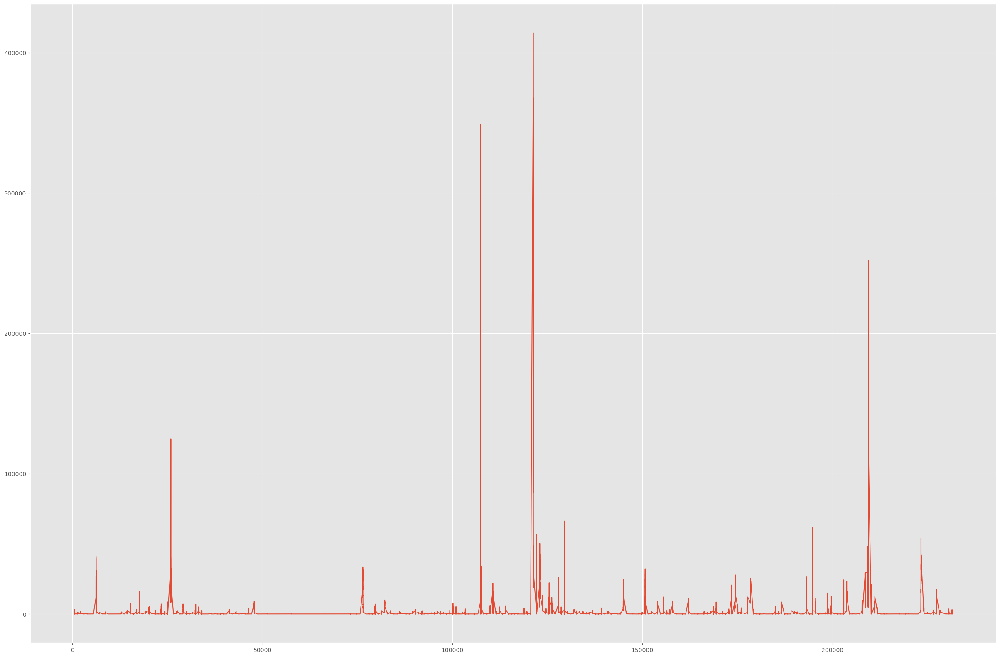

In [ ]:
dfcopy.PlusConf.plot()

In [ ]:
dfcopy['ConfShift1'] = dfcopy.PlusConf.shift()

In [ ]:
dfcopy['ConfShift2'] = dfcopy.ConfShift1.shift()

<AxesSubplot:xlabel='ConfShift1', ylabel='PlusConf'>

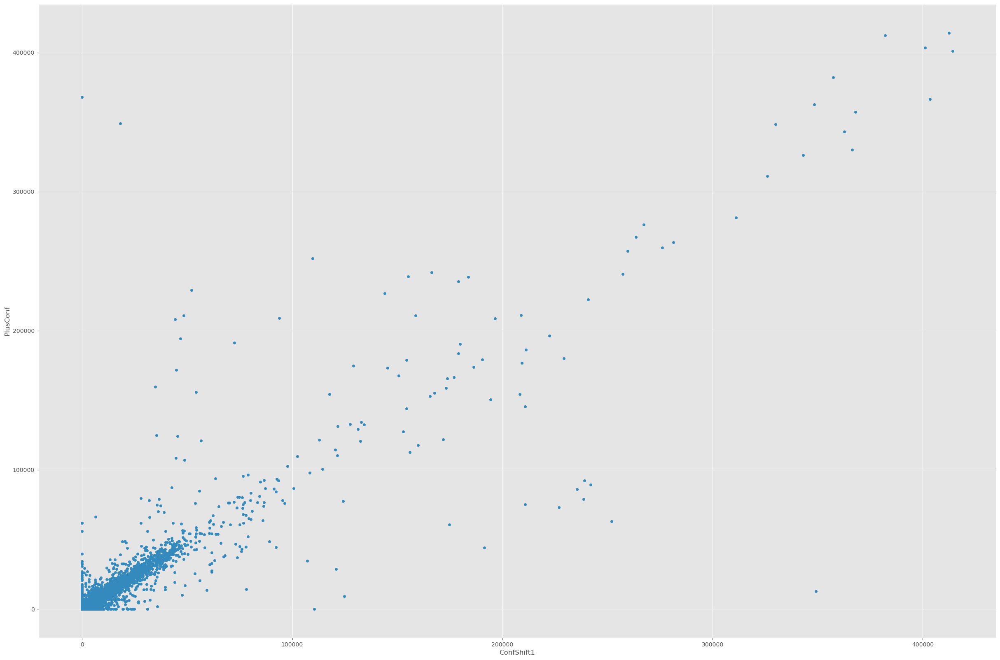

In [ ]:
dfcopy.plot(kind= "scatter", y = "PlusConf", x = "ConfShift1")

<AxesSubplot:xlabel='ConfShift2', ylabel='PlusConf'>

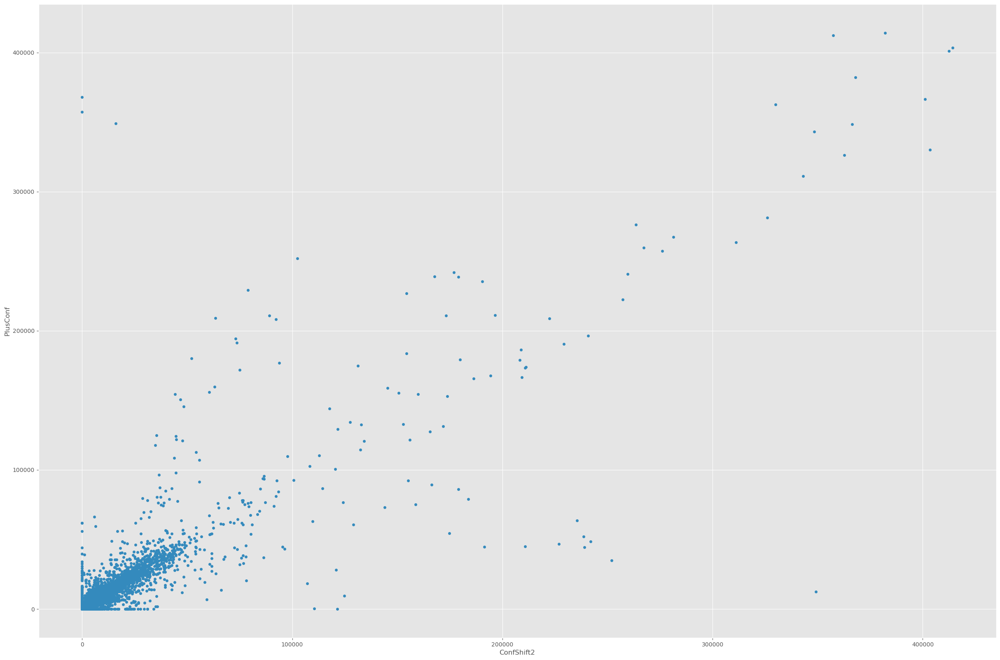

In [ ]:
dfcopy.plot(kind= "scatter", y = "PlusConf", x = "ConfShift2")

<AxesSubplot:>

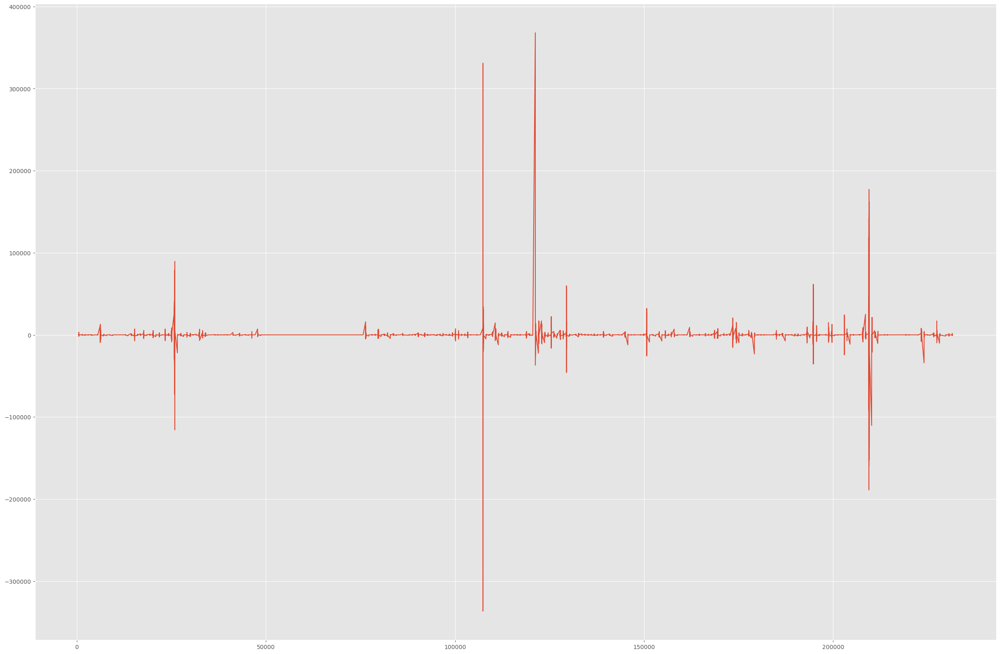

In [ ]:
dfcopy['Confdif1'] = dfcopy.PlusConf - dfcopy.ConfShift1
dfcopy.Confdif1.plot()

<AxesSubplot:>

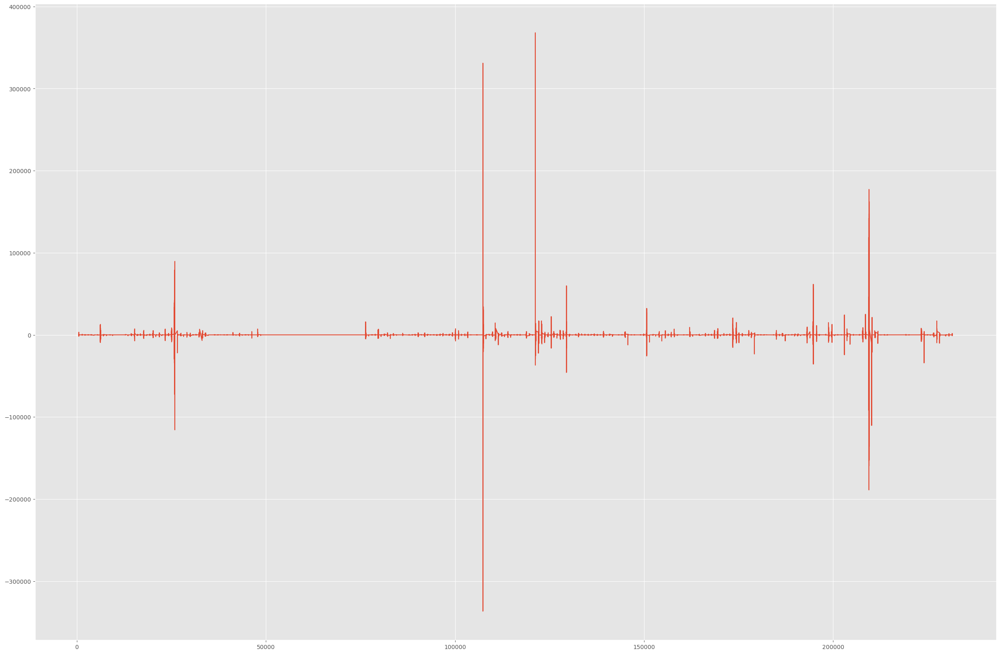

In [ ]:
dfcopy['Confdif2'] = dfcopy.ConfShift1 - dfcopy.ConfShift2
dfcopy.Confdif2.plot()

Для начала прологарифмируем признак кол-ва подтвержденных случаев

In [ ]:
dfcopy['ConfLog'] = np.log(dfcopy.PlusConf)

<AxesSubplot:>

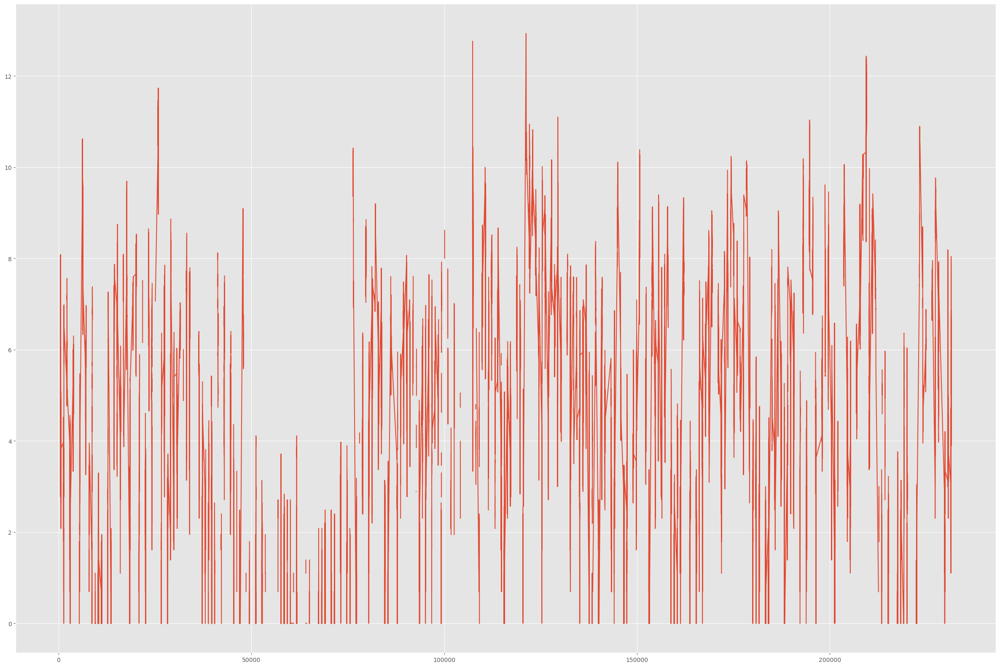

In [ ]:
dfcopy.ConfLog.plot()

In [ ]:
dfcopy['ConfShiftLog1'] = dfcopy.ConfLog.shift()

In [ ]:
dfcopy['ConfShiftLog2'] = dfcopy.ConfShiftLog1.shift()

<AxesSubplot:xlabel='ConfShiftLog1', ylabel='ConfLog'>

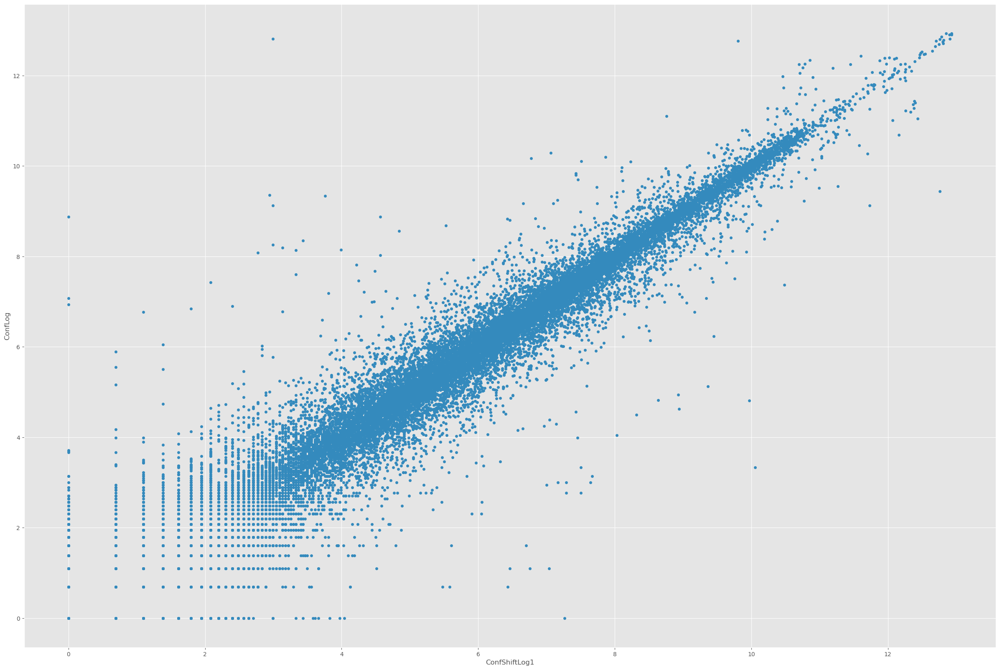

In [ ]:
dfcopy.plot(kind= "scatter", y = "ConfLog", x = "ConfShiftLog1")

<AxesSubplot:xlabel='ConfShiftLog2', ylabel='ConfLog'>

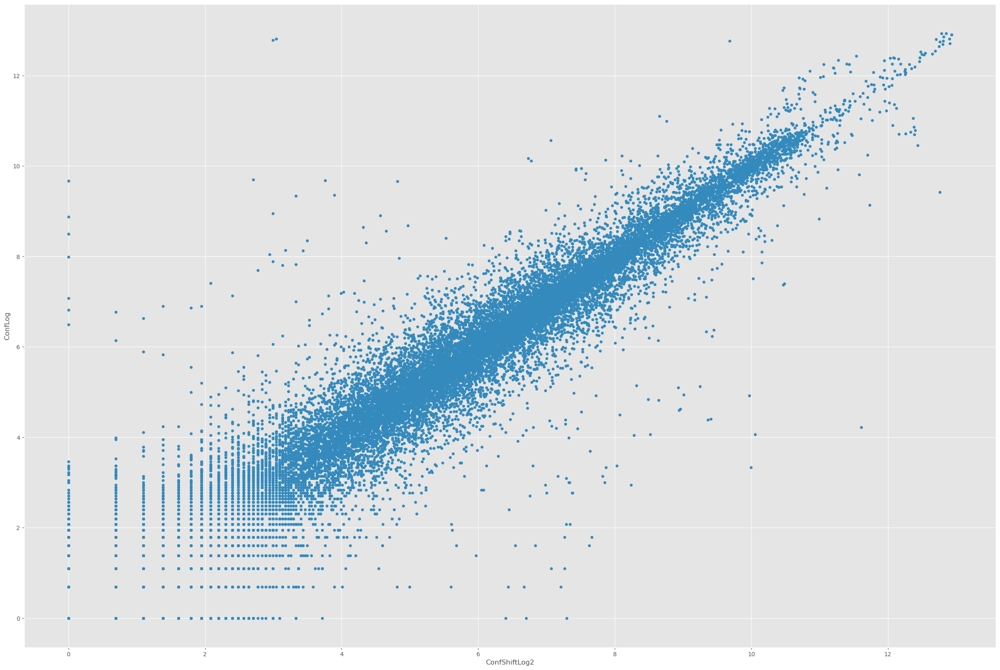

In [ ]:
dfcopy.plot(kind= "scatter", y = "ConfLog", x = "ConfShiftLog2")

<AxesSubplot:>

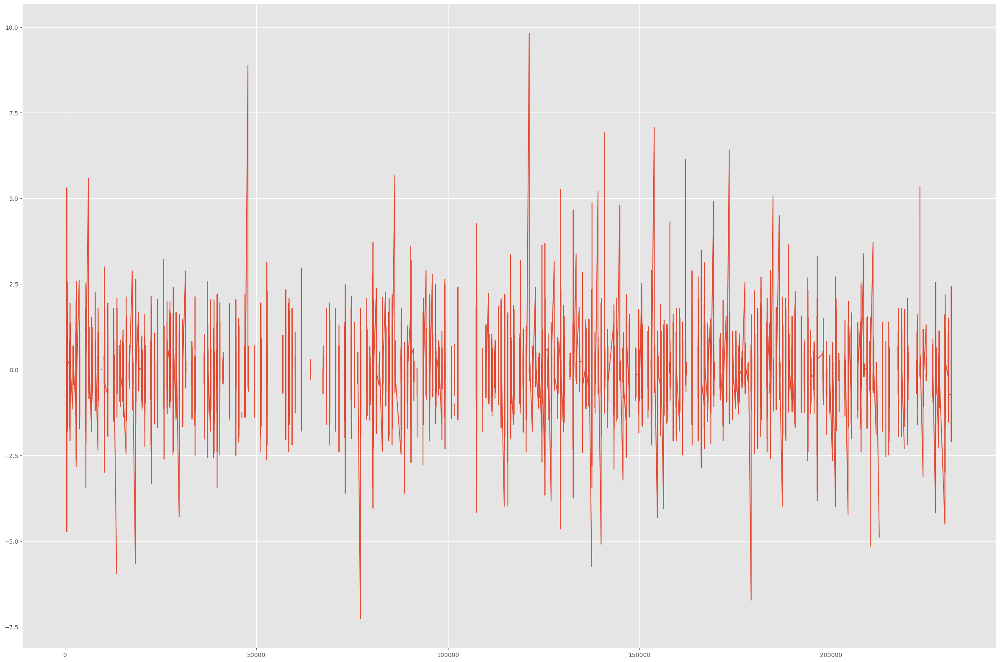

In [ ]:
dfcopy['ConLdif1'] = dfcopy.ConfLog - dfcopy.ConfShiftLog1
dfcopy.ConLdif1.plot()

<AxesSubplot:>

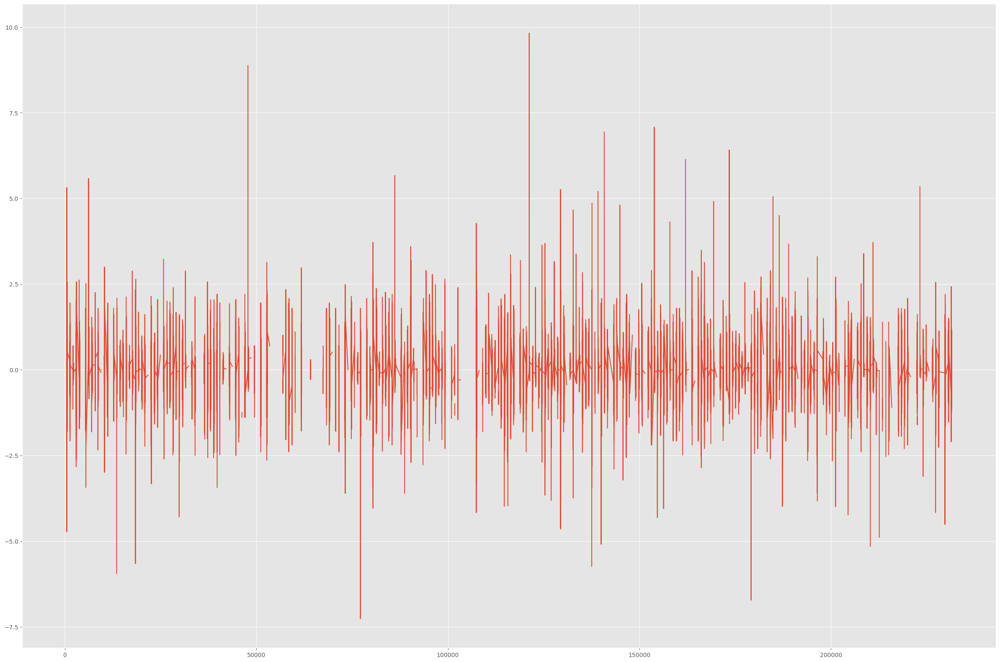

In [ ]:
dfcopy['ConLdif2'] = dfcopy.ConfShiftLog1 - dfcopy.ConfShiftLog2
dfcopy.ConLdif2.plot()

Декомпозиция

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [ ]:
dfcopy.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,Continent,lethality,PlusConf,PlusDeaths,ConfShift1,ConfShift2,Confdif1,Confdif2,ConfLog,ConfShiftLog1,ConfShiftLog2,ConLdif1,ConLdif2
466,2021-05-02,Afghanistan,NaN,60122,53391.00,2637,Asia,0.04,183,6,NaN,NaN,NaN,NaN,5.21,NaN,NaN,NaN,NaN
467,2021-05-03,Afghanistan,NaN,60300,53391.00,2642,Asia,0.04,178,5,183.00,NaN,-5.00,NaN,5.18,5.21,NaN,-0.03,NaN
468,2021-05-04,Afghanistan,NaN,60563,53694.00,2648,Asia,0.04,263,6,178.00,183.00,85.00,-5.00,5.57,5.18,5.21,0.39,-0.03
469,2021-05-05,Afghanistan,NaN,60797,53750.00,2654,Asia,0.04,234,6,263.00,178.00,-29.00,85.00,5.46,5.57,5.18,-0.12,0.39
470,2021-05-06,Afghanistan,NaN,61162,53961.00,2664,Asia,0.04,365,10,234.00,263.00,131.00,-29.00,5.90,5.46,5.57,0.44,-0.12


In [ ]:
dfcopy.index = pd.PeriodIndex(dfcopy.Date, freq='D')

In [ ]:
dfcopy.index = dfcopy.index.to_timestamp()
dfcopy.sort_index(inplace=True)

In [ ]:
decomposition = seasonal_decompose(dfcopy.PlusConf, model = "additive", period = 30)

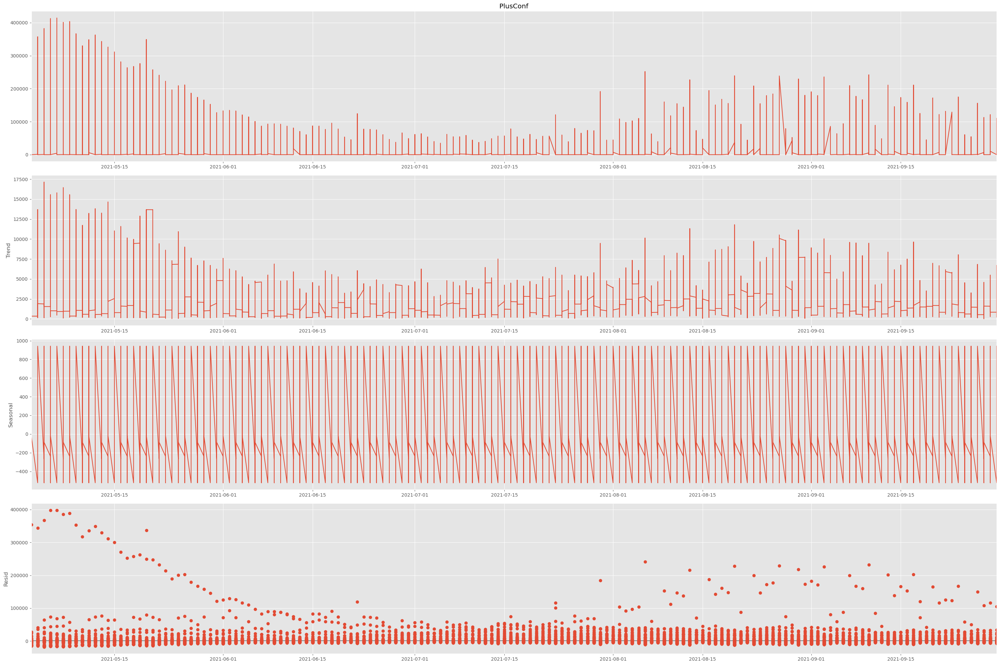

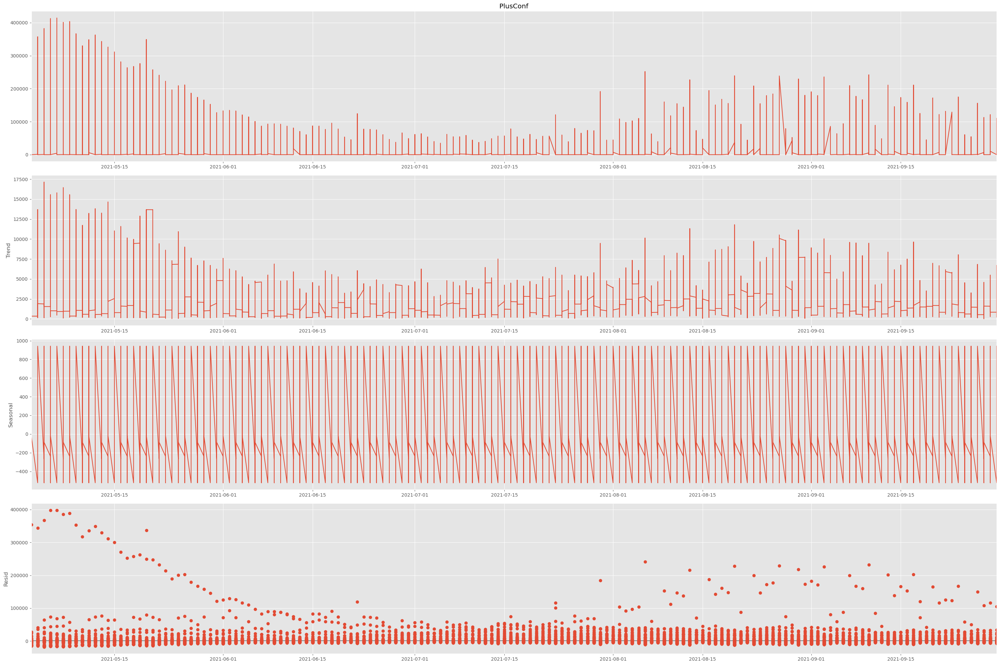

In [ ]:
decomposition.plot()

In [ ]:
trend = decomposition.trend
seasonal = decomposition.seasonal

<AxesSubplot:xlabel='Date'>

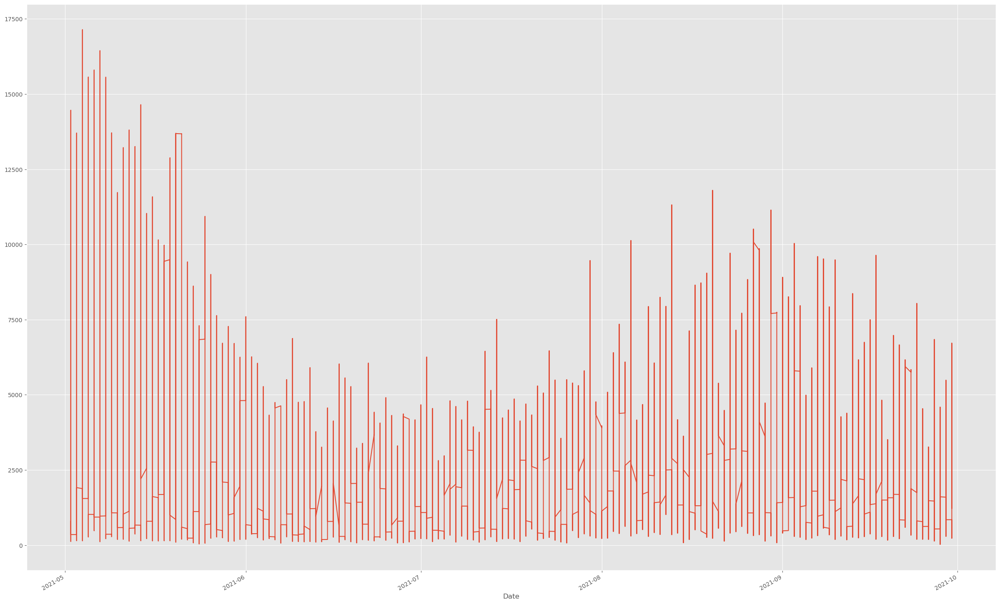

In [ ]:
trend.plot()

<AxesSubplot:xlabel='Date'>

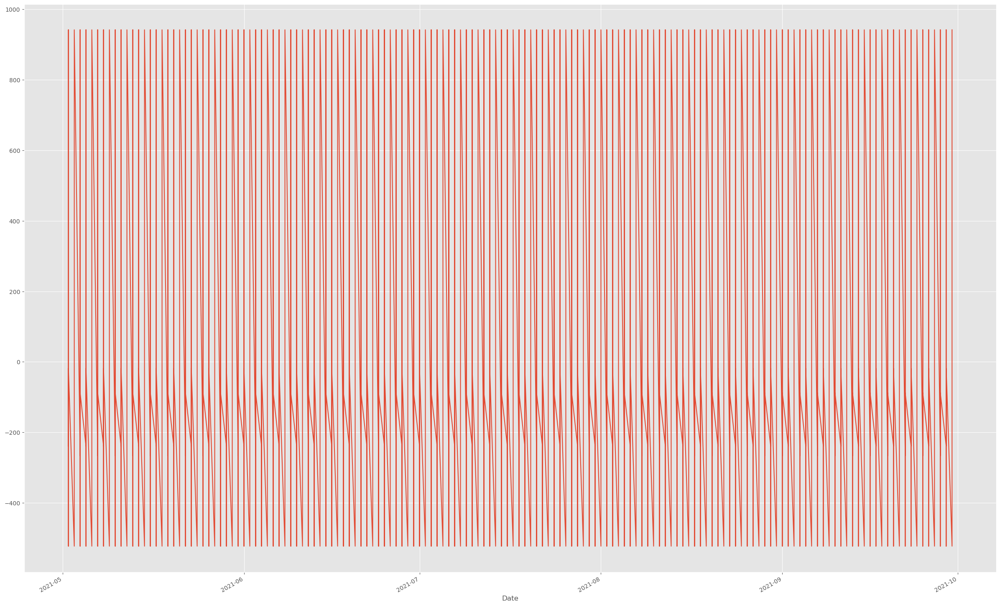

In [ ]:
seasonal.plot()

<AxesSubplot:xlabel='Date'>

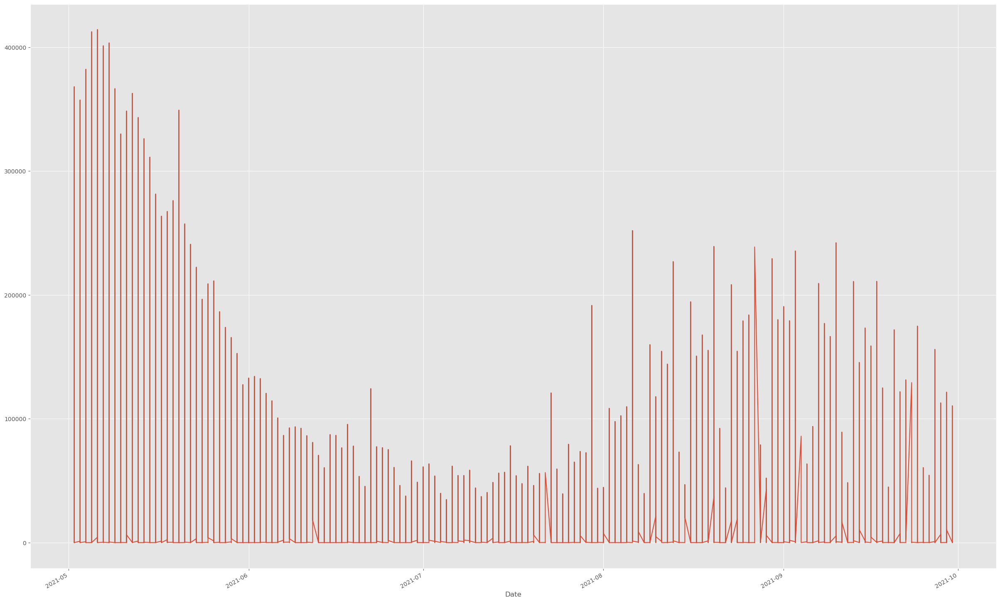

In [ ]:
dfcopy.PlusConf.plot()

In [ ]:
dfcopy.replace([np.inf, -np.inf], 0, inplace=True)

In [ ]:
dfcopy.ConfLog.unique()

array([5.20948615, 0.        , 8.13681086, ..., 9.45210939, 8.94023623,
       9.08568377])

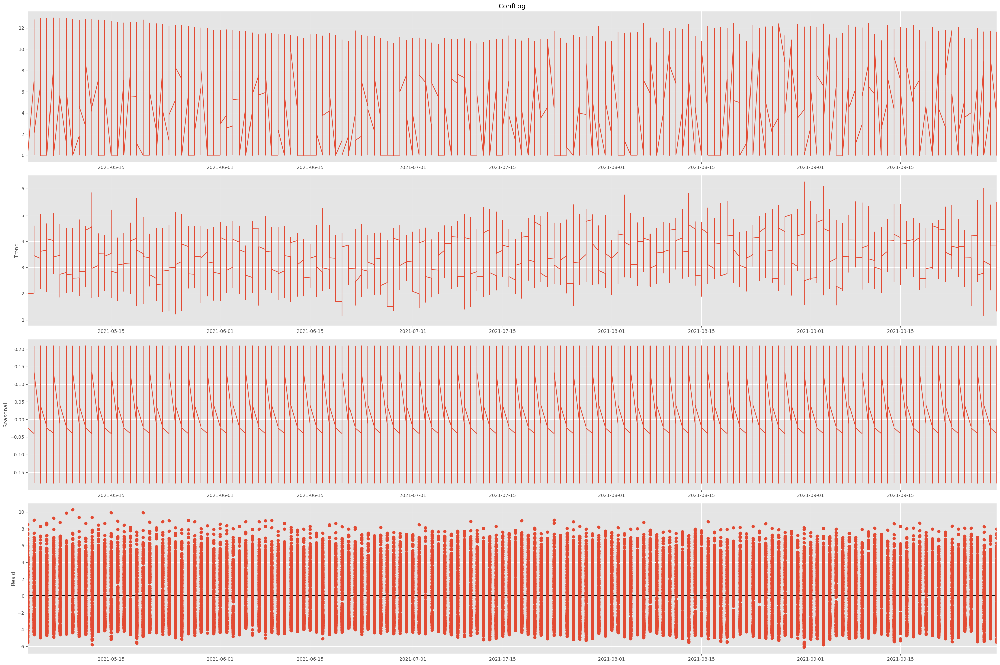

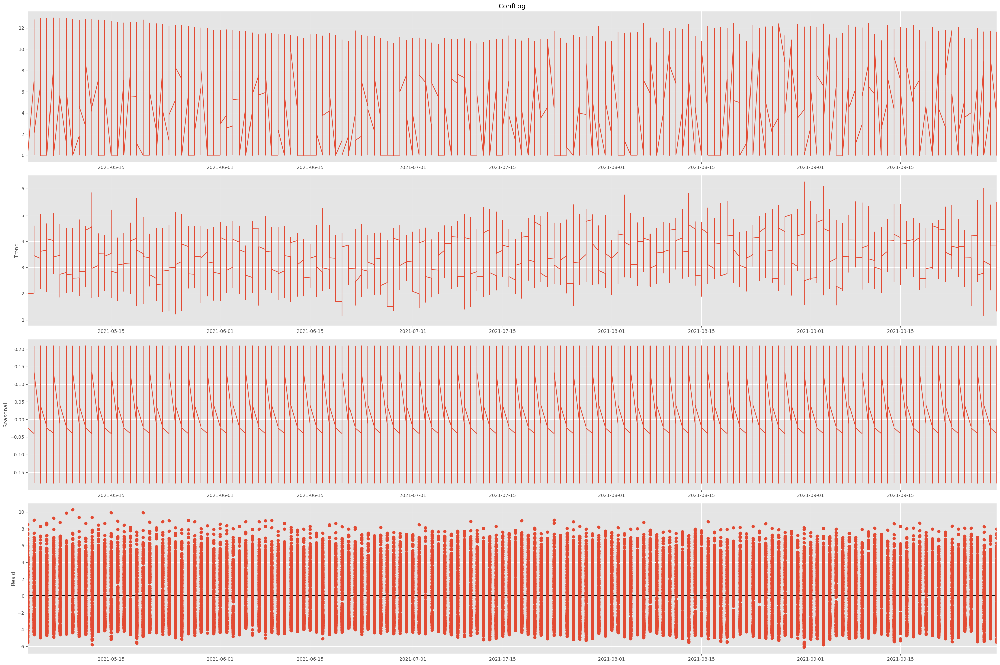

In [ ]:
decompositionlog = seasonal_decompose(dfcopy.ConfLog, model = "additive", period = 30)
decompositionlog.plot()

In [ ]:
trendlog = decompositionlog.trend

In [ ]:
seasonallog = decompositionlog.seasonal

<AxesSubplot:xlabel='Date'>

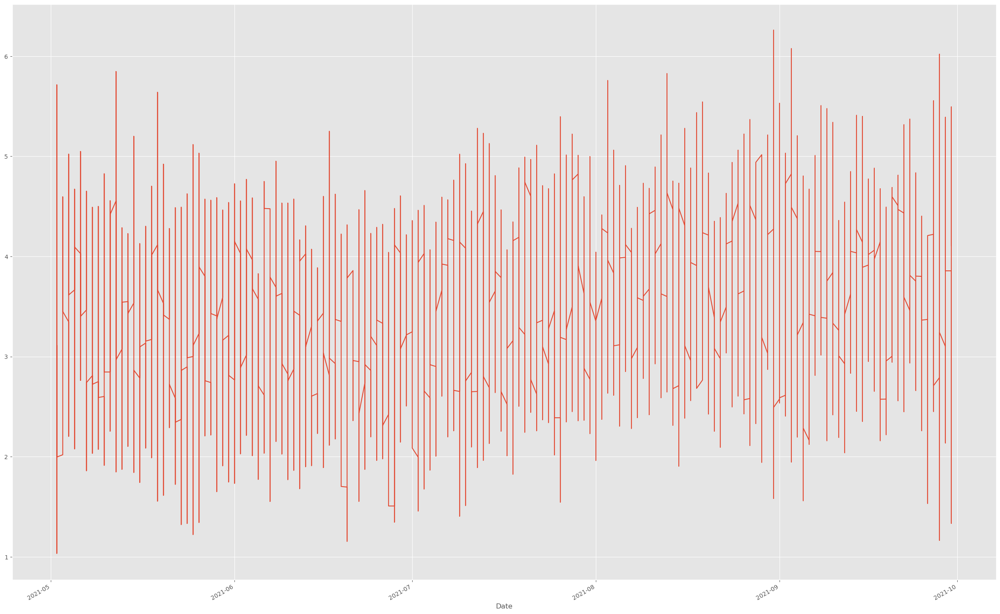

In [ ]:
trendlog.plot()

<AxesSubplot:xlabel='Date'>

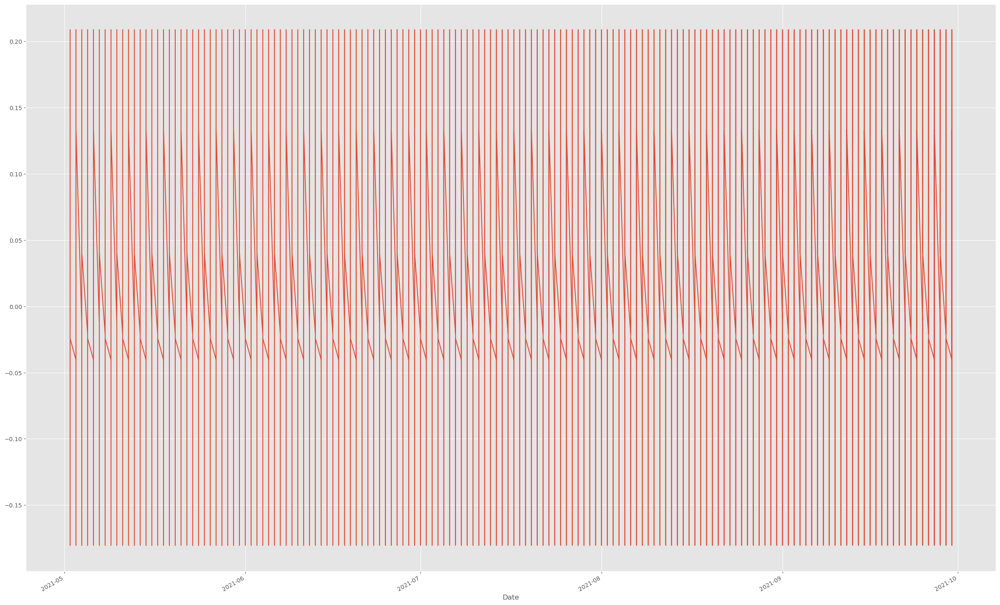

In [ ]:
seasonallog.plot()

Для логарифма более ярко выраженный тренд и меньше разброс, тк он сконцетрирован ниже и выше 0, а вот сезонность выглядит примерно одинаково

In [ ]:
from statsmodels.tsa.stattools import adfuller

In [ ]:
test = adfuller(dfcopy.PlusConf)
print('adf: ', test[0])
print('p-value: ', test[1])
print('Critical values: ', test[4])
if test[0]> test[4]['5%']:
    print('Есть единичные корни, ряд не стационарен')
else:
    print('Единичных корней нет, ряд стационарен')

adf:  -205.43702979684014
p-value:  0.0
Critical values:  {'1%': -3.430503661844992, '5%': -2.8616079151180136, '10%': -2.5668061490167178}
Единичных корней нет, ряд стационарен


In [ ]:
test = adfuller(dfcopy.ConfLog)
print('adf: ', test[0])
print('p-value: ', test[1])
print('Critical values: ', test[4])
if test[0]> test[4]['5%']:
    print('Есть единичные корни, ряд не стационарен')
else:
    print('Единичных корней нет, ряд стационарен')

adf:  -31.47771181631771
p-value:  0.0
Critical values:  {'1%': -3.4305037702447576, '5%': -2.861607963027058, '10%': -2.5668061745173656}
Единичных корней нет, ряд стационарен


In [ ]:
dfcopy = dfcopy.fillna(0)
test = adfuller(dfcopy.Confdif1)
print('adf: ', test[0])
print('p-value: ', test[1])
print('Critical values: ', test[4])
if test[0]> test[4]['5%']:
    print('Есть единичные корни, ряд не стационарен')
else:
    print('Единичных корней нет, ряд стационарен')

adf:  -29.269871019493785
p-value:  0.0
Critical values:  {'1%': -3.4305038462156374, '5%': -2.8616079966036265, '10%': -2.5668061923892367}
Единичных корней нет, ряд стационарен


In [ ]:
dfcopy = dfcopy.fillna(0)
test = adfuller(dfcopy.Confdif2)
print('adf: ', test[0])
print('p-value: ', test[1])
print('Critical values: ', test[4])
if test[0]> test[4]['5%']:
    print('Есть единичные корни, ряд не стационарен')
else:
    print('Единичных корней нет, ряд стационарен')

adf:  -206.11537410610117
p-value:  0.0
Critical values:  {'1%': -3.430503661844992, '5%': -2.8616079151180136, '10%': -2.5668061490167178}
Единичных корней нет, ряд стационарен


Все ряды стационарны, а тренд удобнее всего наблюдать на графике логарифма, заметно падение прироста болезни к концу рассматриваеомого периода, вероятнее всего пероид был начат с очередной волны коронавируса

#### 2.3. (8 баллов)

Для выбранного вами в предыдущем задании временного ряда и еще одного любого постройте графики ACF и PACF. Что показывают эти функции и что можно увидеть на графиках? Прокомментируйте полученные результаты: являются ли временные ряды сезонными? Видна ли на графиках длина сезонной составляющей ряда? В случае присутствия сезонности, разбейте временной ряд на повторяющиеся фрагменты и нарисуйте их наложенными для иллюстрации этой сезонности.


In [ ]:
from statsmodels.tsa.stattools import acf, pacf

In [ ]:
lag_acf = acf(dfcopy.PlusConf, nlags=40)
ACF = pd.Series(lag_acf)
ACF.head()

0    1.00
1    0.00
2    0.00
3   -0.00
4   -0.00
dtype: float64

<AxesSubplot:>

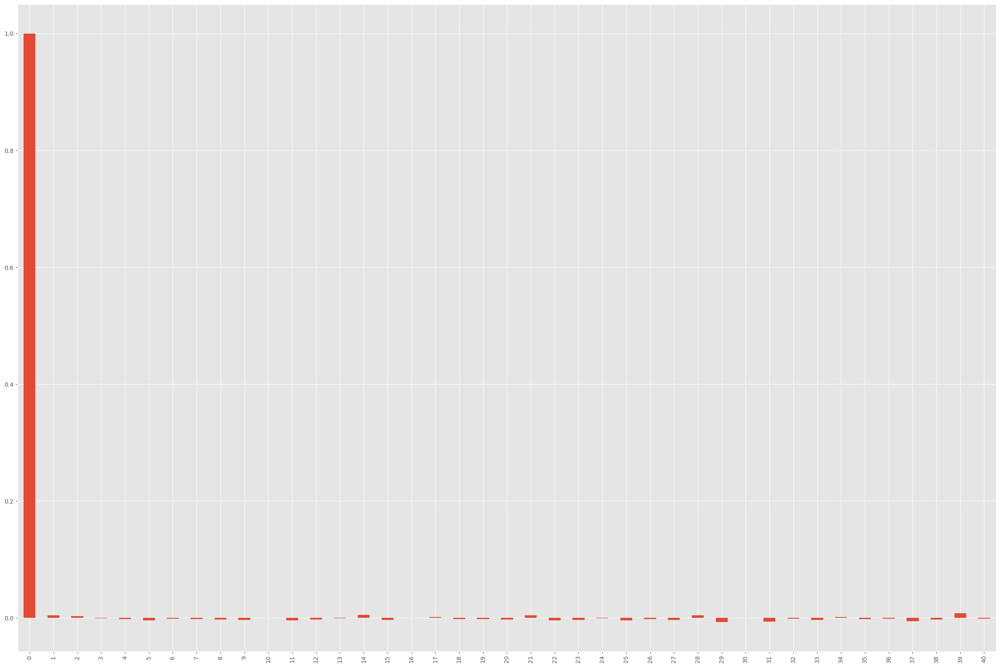

In [ ]:
ACF.plot(kind='bar')

<AxesSubplot:>

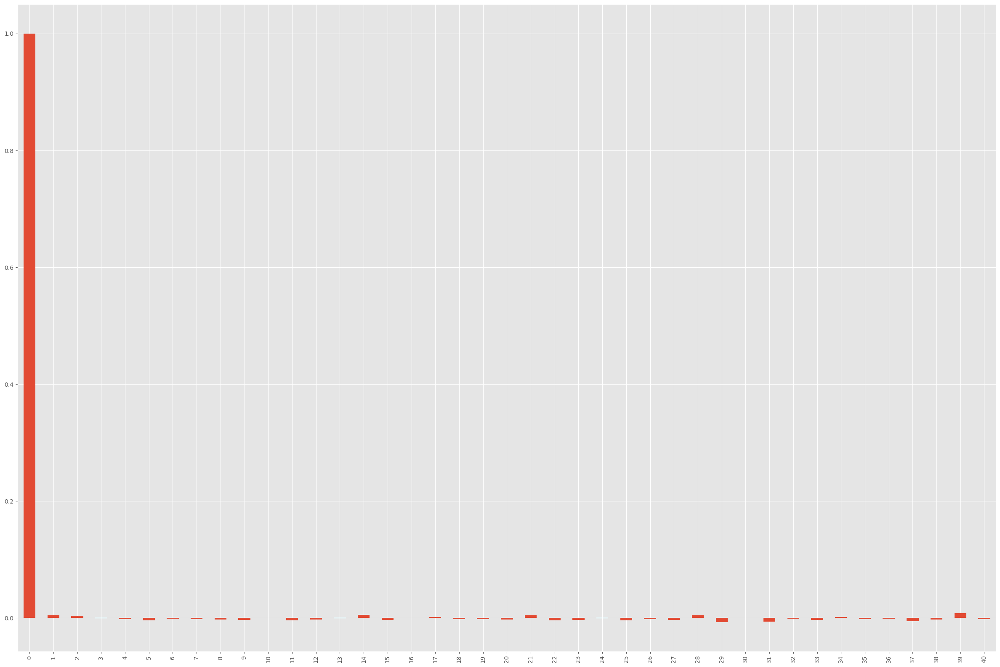

In [ ]:
lag_pacf = pacf(dfcopy.PlusConf, nlags=40, method='ols')
PACF = pd.Series(lag_pacf)
PACF.plot(kind = 'bar')

ACF - автокорелляционная функция, она показывает связь степень связи между значениями временного ряда, PACF - частичная автокорелляционная функция, вообщем-то она делает то же самое. В обоих случаях есть один заметный максимум и  далее примерно одинаковые значения с частотой повторения +- 5, поэтому в ряде присутствует и тренд и есть некоторая сезонность, но ее почти что нет, в основном есть только тренд. Ряд скорее стационарный.

То же самое для России

In [ ]:
dfcopyRus = dfcopy[dfcopy['Country/Region'] == 'Russia']

In [ ]:
lag_acfr = acf(dfcopyRus.PlusConf, nlags=40)
ACFR = pd.Series(lag_acfr)


<AxesSubplot:>

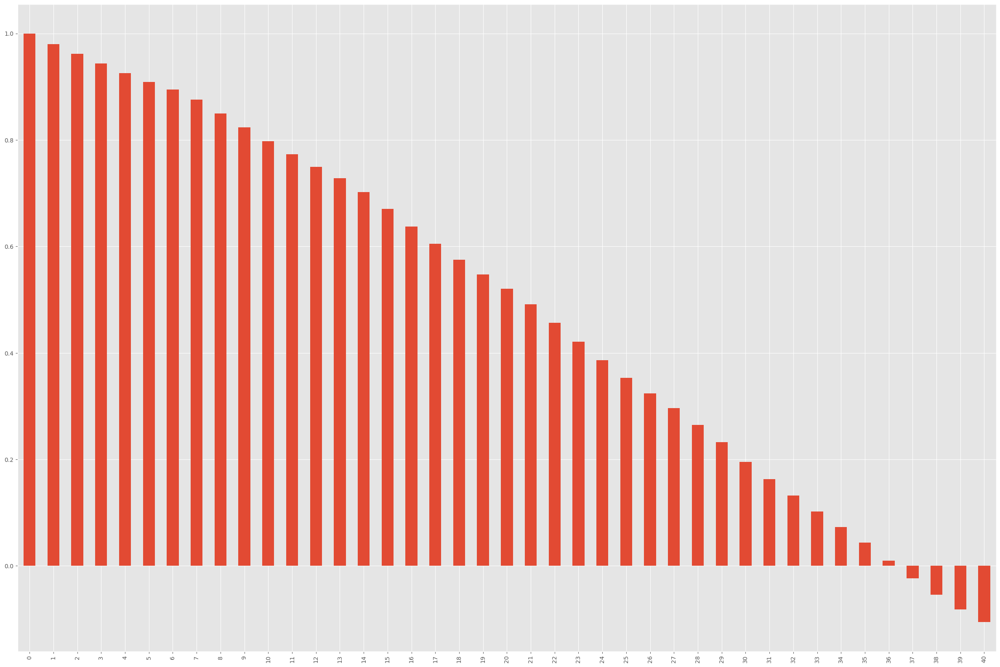

In [ ]:
ACFR.plot(kind='bar')

<AxesSubplot:>

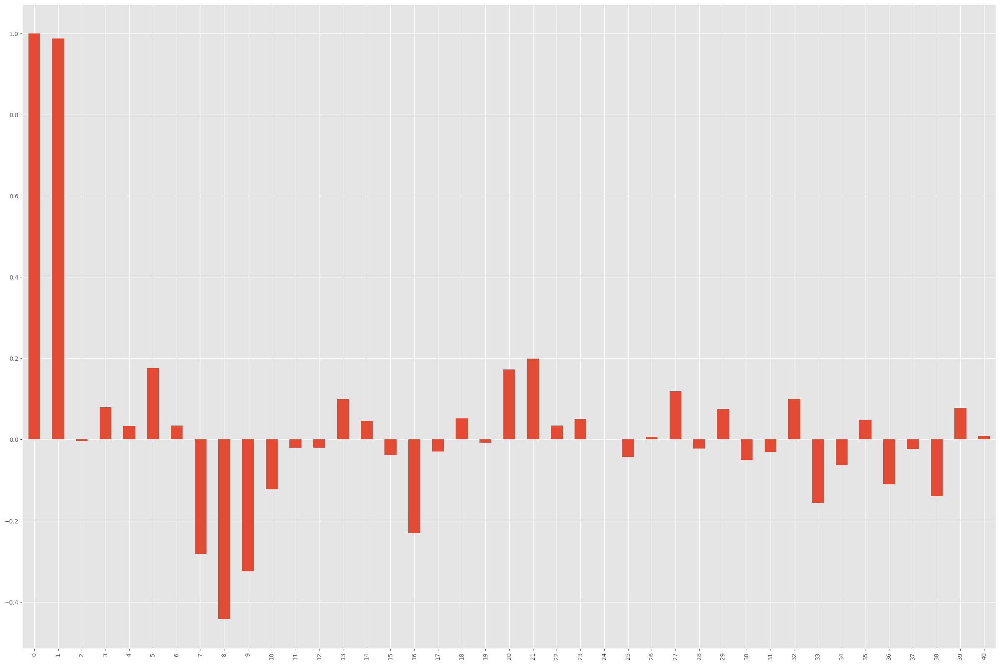

In [ ]:
lag_pacfr = pacf(dfcopyRus.PlusConf, nlags=40, method='ols')
PACFR = pd.Series(lag_pacfr)
PACFR.plot(kind = 'bar')

Есть выраженные максимумы, присутствует нектороая сезонность, но ее особенно нет в конце, скорее доминирует только тренд и случайная составляющая

#### 2.4. (5 баллов)

Вспомним, что для прогнозирования временного ряда необходимо разделить выборку на две составляющие (train и test). На составляющей train наша модель обучается и настраивает свои параметры, на составляющей test модель осуществляет предсказание (а затем мы можем это предсказание сравнить с реальными данными)

Осуществите разбиение датасета на выборку train и test. Соотношение размеров train/test на ваше усмотрение, но мы советуем вам выбрать 85% на 15% или 80% на 20% (при условии, что при этом в test остаётся не менее 20-25 наблюдений).

Отрисуйте не менее 3 разных временных рядов и визуально сделайте различимым разбиение на выборки — либо вертикальной чертой, либо разными цветами.

*Подсказка. Вам может помочь раздел "Прогнозирование в будущее" в семинаре 5*

Первый временной ряд - по России, второй - по США, третий - по Германии

In [ ]:
import statsmodels.formula.api as smf

In [ ]:
dfcopyRus.Date = pd.DatetimeIndex(dfcopyRus.Date)

In [ ]:
dfcopyRus["timeIndex"] = (dfcopyRus.Date - dfcopyRus.Date.min()).astype(int)

In [ ]:
train = dfcopy[dfcopy.Date < '2021-09-07']
test = dfcopy[dfcopy.Date >= '2021-09-07']

In [ ]:
trainRus = dfcopyRus[dfcopyRus.Date < '2021-09-07']
testRus = dfcopyRus[dfcopyRus.Date >= '2021-09-07']
testRus.shape[0]

24

In [ ]:
mo1 = smf.ols('PlusConf ~ timeIndex', data = trainRus).fit()
mo1.predict(testRus)

Date
2021-09-07   29622.85
2021-09-08   29854.28
2021-09-09   30085.71
2021-09-10   30317.14
2021-09-11   30548.56
2021-09-12   30779.99
2021-09-13   31011.42
2021-09-14   31242.85
2021-09-15   31474.28
2021-09-16   31705.71
2021-09-17   31937.13
2021-09-18   32168.56
2021-09-19   32399.99
2021-09-20   32631.42
2021-09-21   32862.85
2021-09-22   33094.28
2021-09-23   33325.71
2021-09-24   33557.13
2021-09-25   33788.56
2021-09-26   34019.99
2021-09-27   34251.42
2021-09-28   34482.85
2021-09-29   34714.28
2021-09-30   34945.71
dtype: float64

In [ ]:
predictionr = mo1.predict(testRus).values

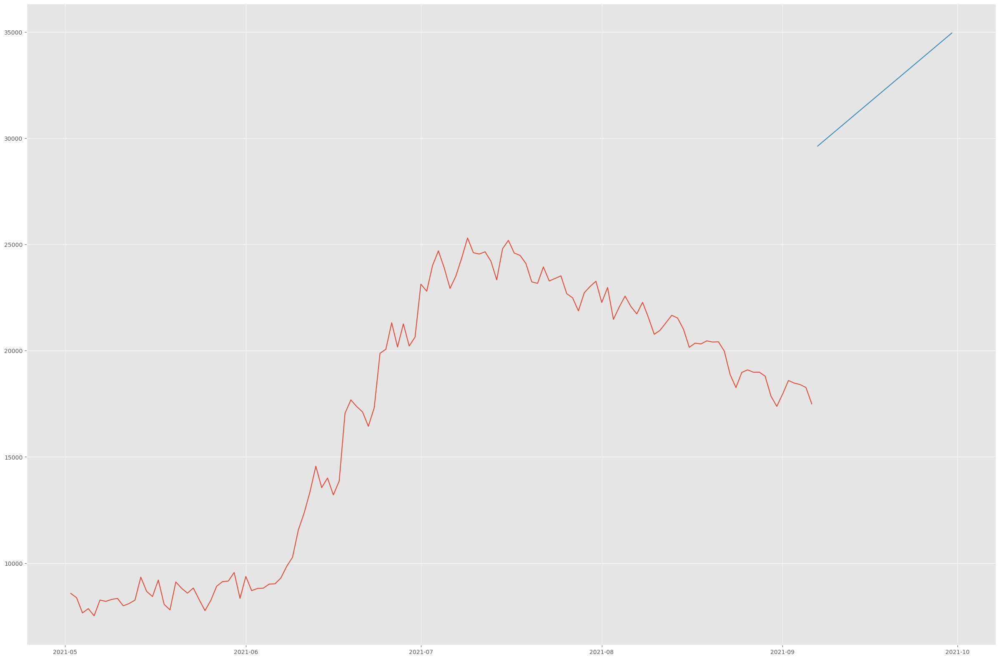

In [ ]:
plt.plot(trainRus.Date, trainRus['PlusConf'])
plt.plot(testRus.Date, predictionr)

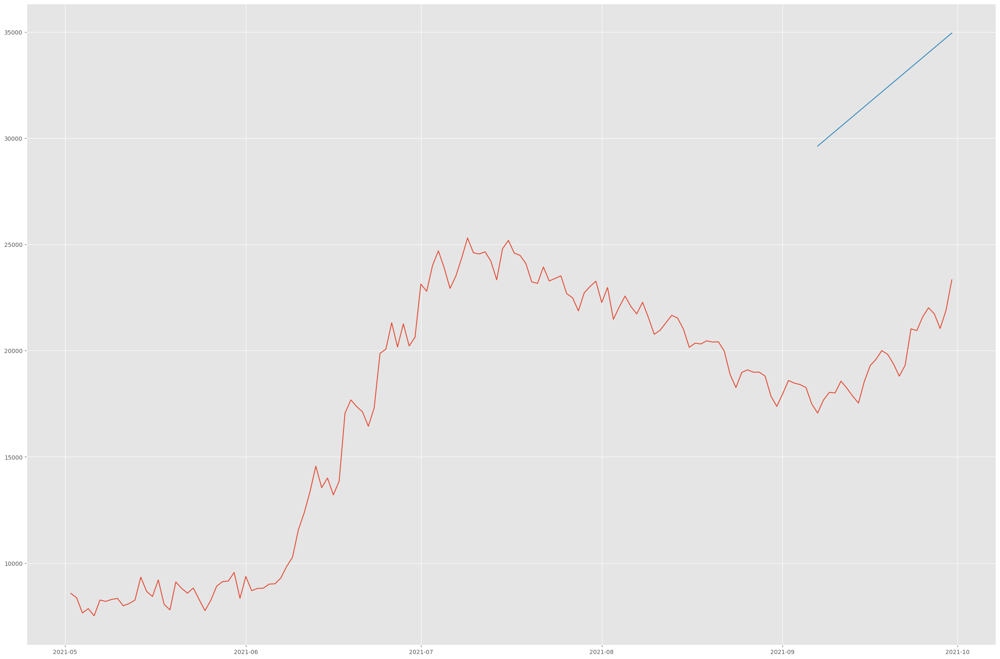

In [ ]:
plt.plot(dfcopyRus.Date, dfcopyRus['PlusConf'])
plt.plot(testRus.Date, predictionr)

 Тут явно не туда предсказали)) Но тренд роста верен

In [ ]:
dfcopyGer = dfcopy[dfcopy['Country/Region'] == 'Germany']
dfcopyUs =  dfcopy[dfcopy['Country/Region'] == 'US']

In [ ]:
dfcopyUs.Date = pd.DatetimeIndex(dfcopyUs.Date)
dfcopyGer.Date = pd.DatetimeIndex(dfcopyGer.Date)
dfcopyUs["timeIndex"] = (dfcopyUs.Date - dfcopyUs.Date.min()).astype(int)
dfcopyGer["timeIndex"] = (dfcopyGer.Date - dfcopyGer.Date.min()).astype(int)

In [ ]:
trainGer = dfcopyGer[dfcopyUs.Date < '2021-09-07']
testGer = dfcopyGer[dfcopyUs.Date >= '2021-09-07']

In [ ]:
trainUs = dfcopyUs[dfcopyUs.Date < '2021-09-07']
testUs = dfcopyUs[dfcopyUs.Date >= '2021-09-07']

In [ ]:
mo2 = smf.ols('PlusConf ~ timeIndex', data = trainUs).fit()
mo2.predict(testUs)

Date
2021-09-07   129419.23
2021-09-08   130430.32
2021-09-09   131441.41
2021-09-10   132452.50
2021-09-11   133463.58
2021-09-12   134474.67
2021-09-13   135485.76
2021-09-14   136496.85
2021-09-15   137507.93
2021-09-16   138519.02
2021-09-17   139530.11
2021-09-18   140541.20
2021-09-19   141552.29
2021-09-20   142563.37
2021-09-21   143574.46
2021-09-22   144585.55
2021-09-23   145596.64
2021-09-24   146607.72
2021-09-25   147618.81
2021-09-26   148629.90
2021-09-27   149640.99
2021-09-28   150652.08
2021-09-29   151663.16
2021-09-30   152674.25
dtype: float64

In [ ]:
predictionus = mo2.predict(testUs).values

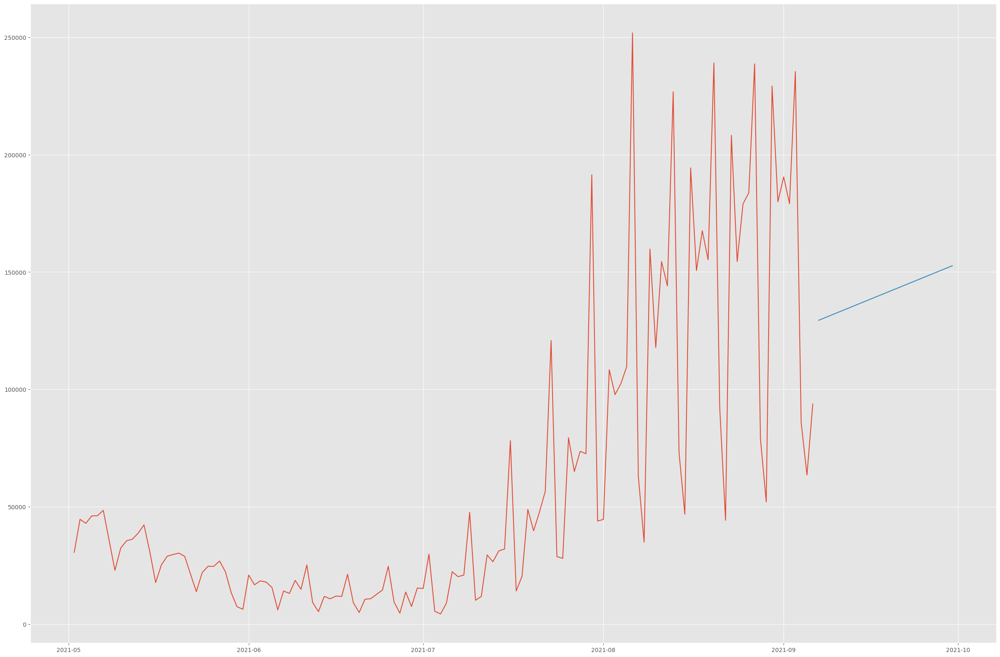

In [ ]:
plt.plot(trainUs.Date, trainUs['PlusConf'])
plt.plot(testUs.Date, predictionus)

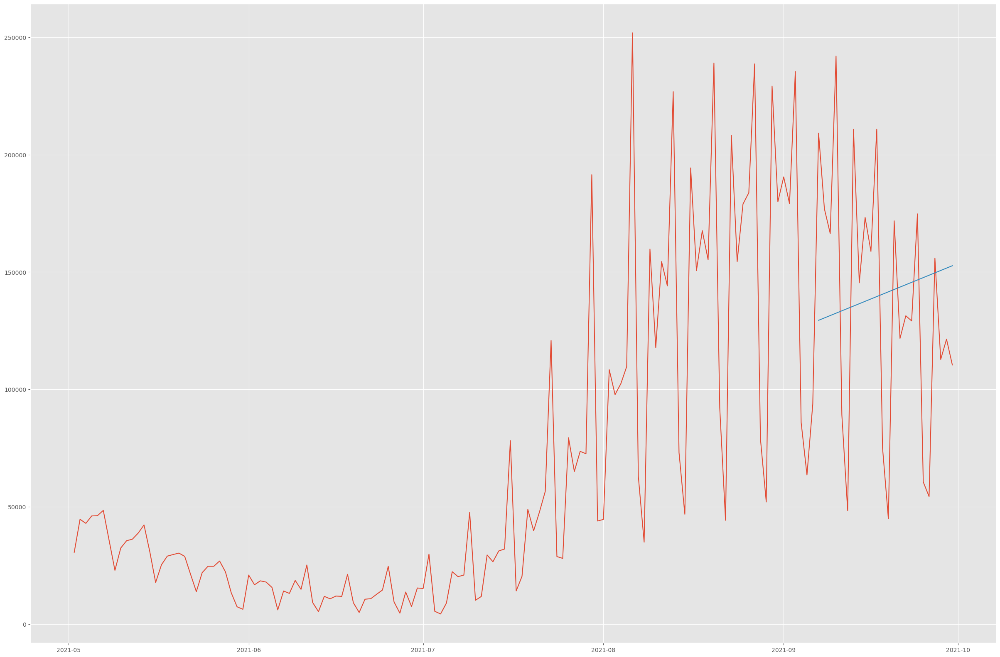

In [ ]:
plt.plot(dfcopyUs.Date, dfcopyUs['PlusConf'])
plt.plot(testUs.Date, predictionus)

 Здесь линейная модель вообще почти ничего не аппроксимирует(

In [ ]:
mo3 = smf.ols('PlusConf ~ timeIndex', data = trainGer).fit()
mo3.predict(testGer)

Date
2021-09-07   6597.19
2021-09-08   6648.74
2021-09-09   6700.28
2021-09-10   6751.82
2021-09-11   6803.36
2021-09-12   6854.90
2021-09-13   6906.44
2021-09-14   6957.98
2021-09-15   7009.52
2021-09-16   7061.06
2021-09-17   7112.60
2021-09-18   7164.14
2021-09-19   7215.68
2021-09-20   7267.22
2021-09-21   7318.76
2021-09-22   7370.30
2021-09-23   7421.84
2021-09-24   7473.38
2021-09-25   7524.93
2021-09-26   7576.47
2021-09-27   7628.01
2021-09-28   7679.55
2021-09-29   7731.09
2021-09-30   7782.63
dtype: float64

In [ ]:
predictiong = mo3.predict(testGer).values

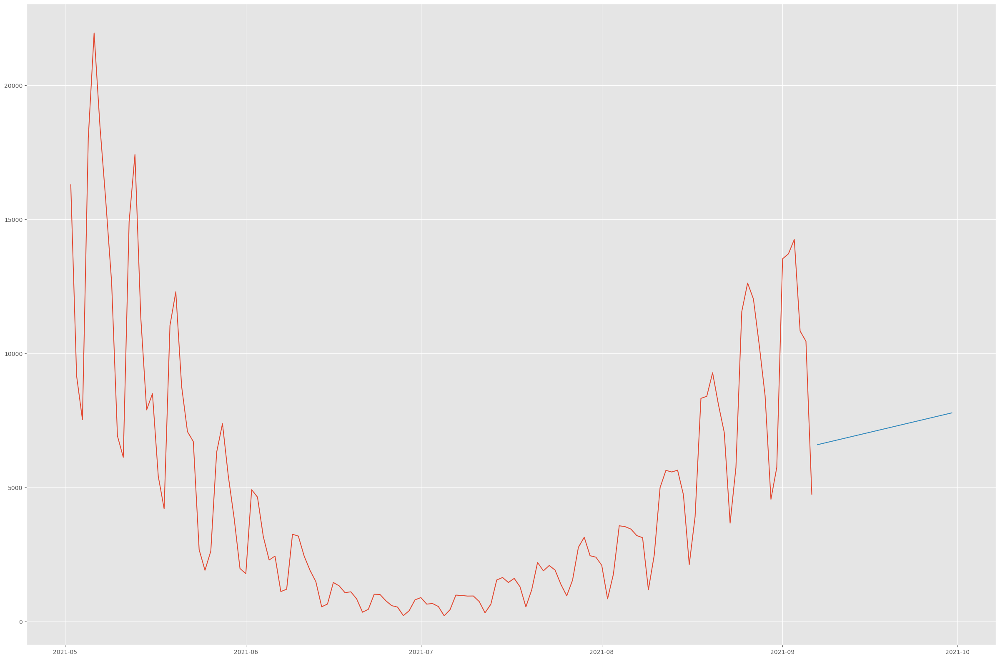

In [ ]:
plt.plot(trainGer.Date, trainGer['PlusConf'])
plt.plot(testGer.Date, predictiong)

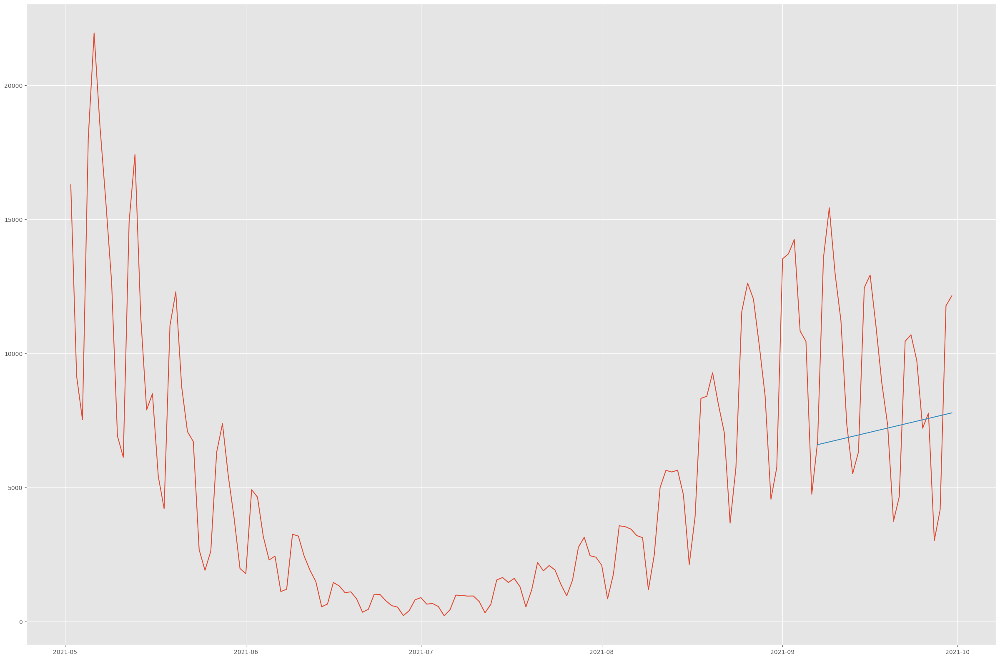

In [ ]:
plt.plot(dfcopyGer.Date, dfcopyGer['PlusConf'])
plt.plot(testGer.Date, predictiong)

Здесь есть примерное попадание и неплохая апроксимация ряда

## Раздел 3. Модели. Прогнозирование временных рядов (60 баллов и 58 бонусных баллов)


В этой третьей и последней части домашнего задания вам предстоит построить несколько моделей и осуществить прогнозирование для временных рядов. Прогнозирование будем делать для такого показателя как летальность от вируса. Летальность можно рассчитывать по формуле:

$$ CFR = \frac{Deaths}{Confirmed} $$

Для каждого типа модели сделайте несколько прогнозов для не менее 3 разных стран/регионов/другое (на ваш обоснованный выбор). Главное, чтобы каждый из типов моделей прознозировал одинаковый набор данных, чтобы в конце можно было сделать выводы о качестве работы той или иной модели.

В качестве метрики качества взять RMSE.

Таким образом, по итогу построения и применения **каждой из моделей** должно быть следующее:
- Вывести массив прогнозов значений (массив имеет размер test-выборки)
- Визуализировать на графике значения ряда из train-выборки одним цветом и прогнозные значения модели (из массива прогнозов) другим цветом, на одних осях
- Визуализировать на графике значения всего ряда (и из train, и из test-выборок) одним цветом и прогнозные значения модели другим цветом, на одних осях (то есть по прогнозным значениям идет наложение двух графиков - подробнее см. в семинаре 5)
- Подсчитать метрику качества по test-выборке
- Добавить результаты метрики качества в общую сводную табличку (по строкам - название модели, по столбцам - RMSE для каждого из рядов - подробнее см. в семинаре 5)

*Примечание. Данный алгоритм необходимо повторять для каждой модели, учитывая разные параметры. Иными словами ARIMA(1,0,1) и ARIMA(2,0,1) - это разные модели*

Не забывайте обязательно сопровождать ваш код комментариями, графиками и выводами.

Для каждой модели возьмем два промежутка: первый с первого зарегистрированного случая болезни (чтобы не было много нулевых значений и NaN) до конца рассматриваемого в датасете периода, второй из конца: с декабря 2022 года до 16 апреля 2022 года, тестовая выборка будет всегда 20% от общей.

**Возьмем три страны: Россию (мы в ней живем и интересно что у нас происходит иногда), Индию (она в топе по кол-ву заболеваний) и Йемен, тк там одна из самых высоких смертностей по всем странам.**

Предпоготовка датасетов, делим на выборки итд

In [ ]:
dfrussia1 = drop[(drop['Country/Region'] == 'Russia') & (drop.Confirmed > 0)]
dfindia1 = drop[(drop['Country/Region'] == 'India') & (drop.Confirmed > 0)]
dfyemen1 = drop[(drop['Country/Region'] == 'Yemen') & (drop.Confirmed > 0)]
(dfrussia1.shape[0] * 0.2, dfrussia1.shape[0], dfindia1.shape[0] * 0.2, dfindia1.shape[0], dfyemen1.shape[0] * 0.2, dfyemen1.shape[0])

(161.4, 807, 161.60000000000002, 808, 147.4, 737)

In [ ]:
trainru1 = dfrussia1.iloc[:646, :]
testru1 = dfrussia1.iloc[646:, :]
trainind1 = dfindia1.iloc[:646, :]
testind1 = dfindia1.iloc[646:, :]
trainye1 = dfyemen1.iloc[:590, :]
testye1 = dfyemen1.iloc[590:, :]
trainru1.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths,Continent,lethality,PlusConf,PlusDeaths
177897,2020-01-31,Russia,NaN,2,0.00,0,Europe,0.00,2,0
177898,2020-02-01,Russia,NaN,2,0.00,0,Europe,0.00,0,0
177899,2020-02-02,Russia,NaN,2,0.00,0,Europe,0.00,0,0
177900,2020-02-03,Russia,NaN,2,0.00,0,Europe,0.00,0,0
177901,2020-02-04,Russia,NaN,2,0.00,0,Europe,0.00,0,0


In [ ]:
dfrussia2 = drop[(drop['Country/Region'] == 'Russia') & (drop.Date >= '2021-12-01')]
dfindia2 = drop[(drop['Country/Region'] == 'India') & (drop.Date >= '2021-12-01')]
dfyemen2 = drop[(drop['Country/Region'] == 'Yemen') & (drop.Date >= '2021-12-01')]
(dfrussia2.shape[0] * 0.2, dfrussia2.shape[0], dfindia2.shape[0] * 0.2, dfindia2.shape[0],
 dfyemen2.shape[0] * 0.2, dfyemen2.shape[0])

(27.400000000000002, 137, 27.400000000000002, 137, 27.400000000000002, 137)

In [ ]:
trainru2 = dfrussia2.iloc[:110, :]
testru2 = dfrussia2.iloc[110:, :]
trainind2 = dfindia2.iloc[:110, :]
testind2 = dfindia2.iloc[110:, :]
trainye2 = dfyemen2.iloc[:110, :]
testye2 = dfyemen2.iloc[110:, :]

In [ ]:
def RMSE(predicted, actual):
    mse = (predicted - actual)**2
    rmse = np.sqrt(mse.sum()/mse.count())
    return rmse

In [ ]:
dfres = pd.DataFrame(columns = ['Model', 'Russia_RMSE', 'India_RMSE', 'Yemen_RMSE'])
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE


#### 3.1. Прогнозирование средним (Mean Constant Model)  (5 баллов)

Осуществите простое прогнозирование средним значением

Для первого периода

In [ ]:
mnru1 = trainru1.lethality.mean()
mnru1

0.017711235513893964

In [ ]:
mnru1ar = list()
for i in range(testru1.shape[0]):
    mnru1ar.append(mnru1)
testru1['mn'] = mnru1ar
dfrussia1['mn'] = mnru1
mnru1ar

[0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.017711235513893964,
 0.01771123

Text(0.5, 1.0, 'Среднее и реальные показатели летальности')

<Figure size 1000x2000 with 0 Axes>

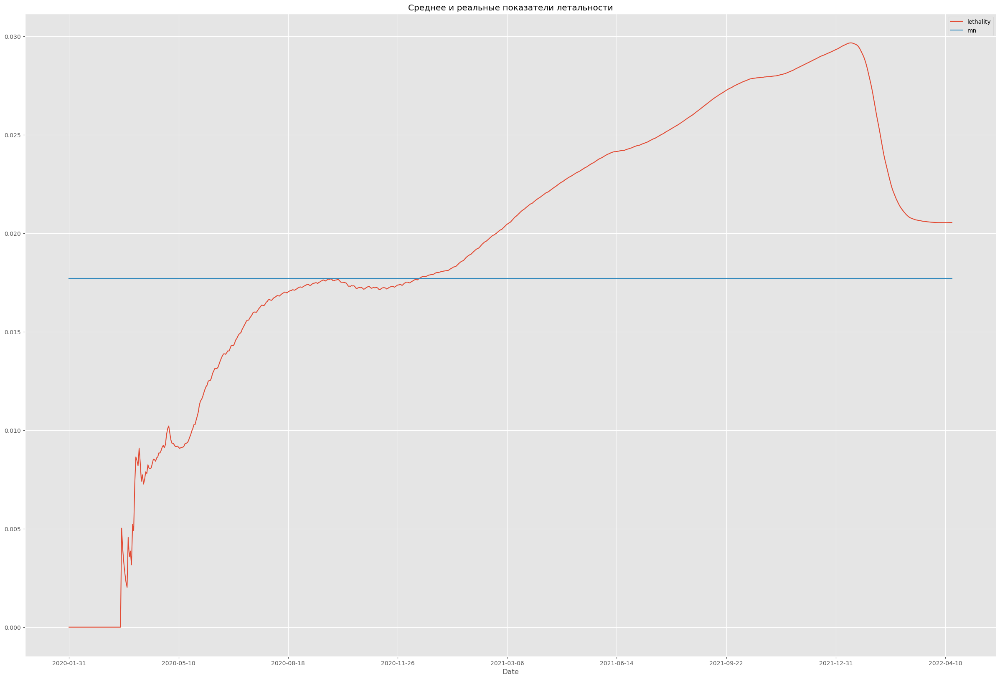

In [ ]:
plt.figure(figsize=(10, 20))
dfrussia1.plot(kind='line', x='Date', y=['lethality', 'mn'])
plt.title('Среднее и реальные показатели летальности')

В самом конце почти попали

Text(0.5, 1.0, 'Тренировочная выборка и прогноз')

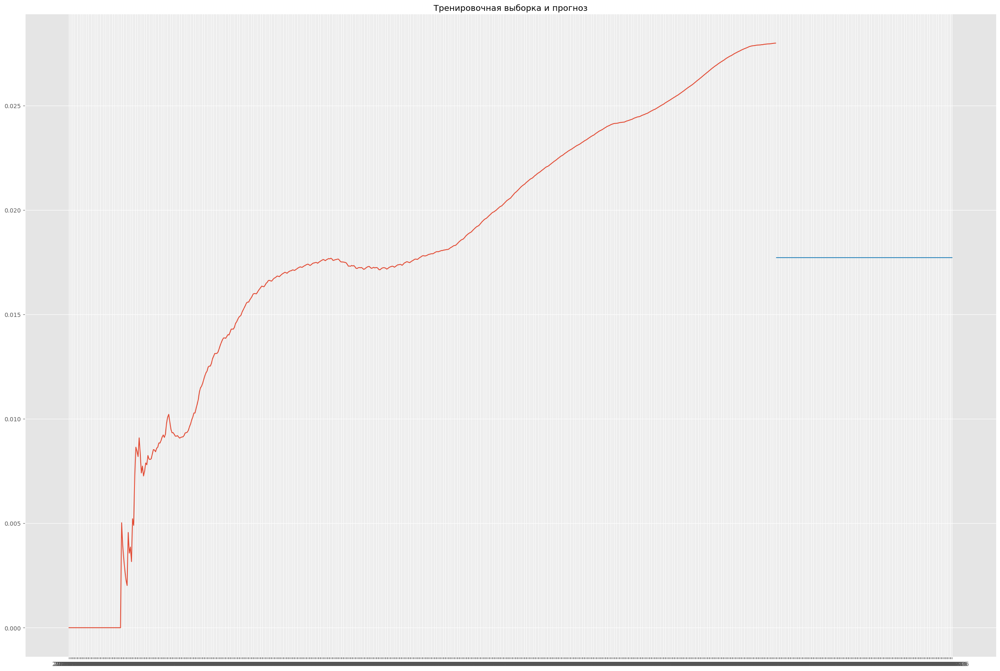

In [ ]:

plt.plot(trainru1.Date, trainru1.lethality)
plt.plot(testru1.Date, testru1.mn)
plt.title('Тренировочная выборка и прогноз')

In [ ]:
mnru1rmse = RMSE(testru1.mn, testru1.lethality)
mnru1rmse

0.008746021851569814

In [ ]:
dfres.loc[0,'Model'] = 'Mean1'
dfres.loc[0,'Russia_RMSE'] = mnru1rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,NaN,NaN


In [ ]:
mnind1 = trainind1.lethality.mean()
mnind1

0.01634946376208741

In [ ]:
mnind1ar = list()
for i in range(testind1.shape[0]):
    mnind1ar.append(mnind1)
testind1['mn'] = mnind1ar
dfindia1['mn'] = mnind1
mnind1ar

[0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.01634946376208741,
 0.0163494

Text(0.5, 1.0, 'Среднее и реальные показатели летальности')

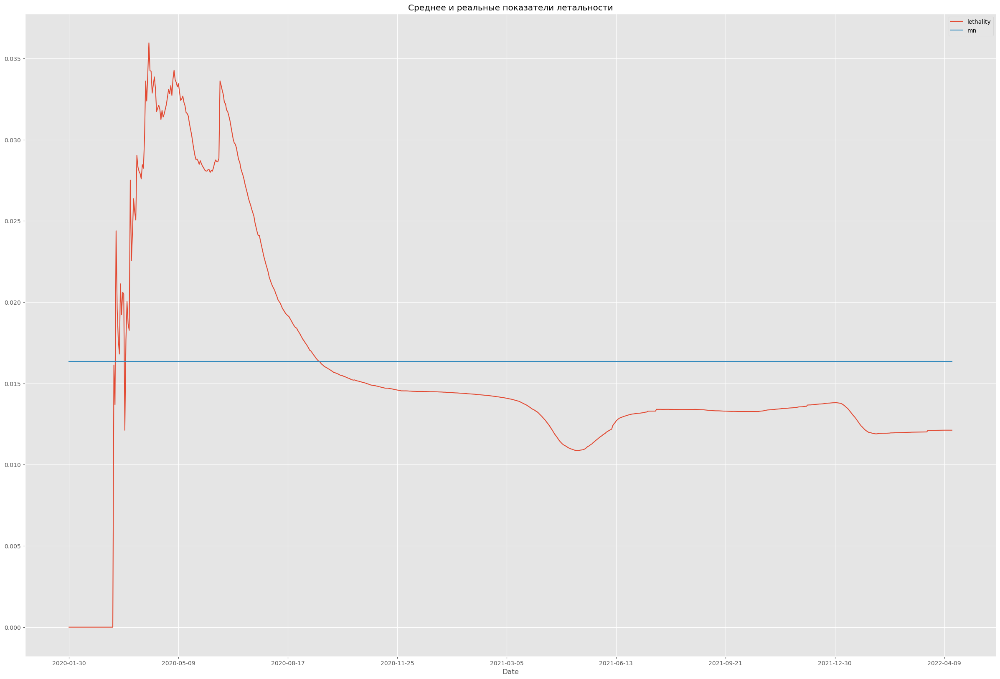

In [ ]:
dfindia1.plot(kind='line', x='Date', y=['lethality', 'mn'])
plt.title('Среднее и реальные показатели летальности')

Text(0.5, 1.0, 'Тренировочная выборка и прогноз')

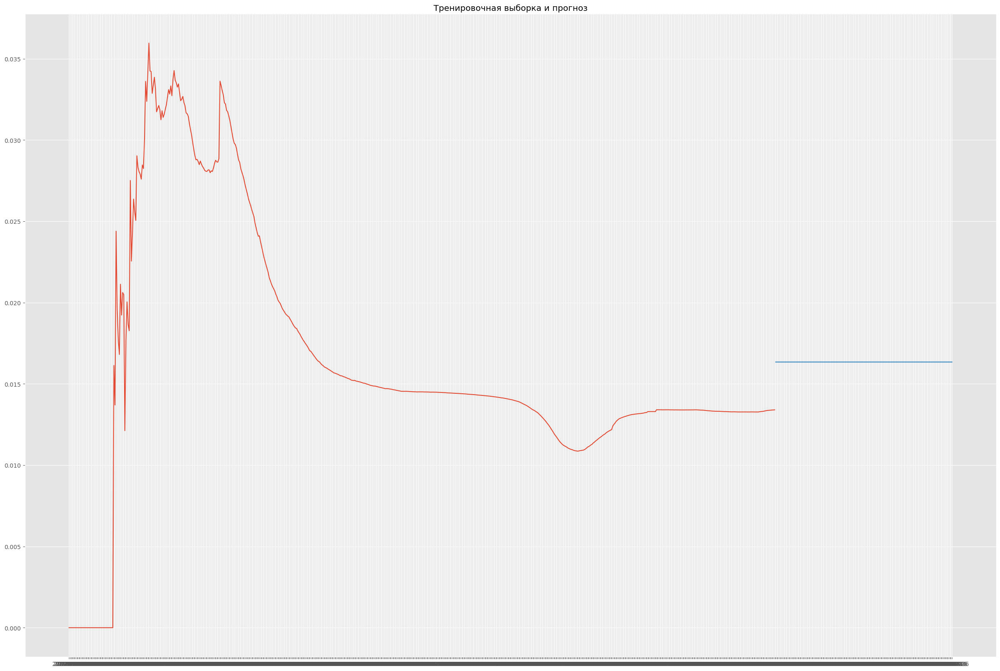

In [ ]:
plt.plot(trainind1.Date, trainind1.lethality)
plt.plot(testind1.Date, testind1.mn)
plt.title('Тренировочная выборка и прогноз')

Для Индии получили уже более верные значения, они чуть выше реальных

In [ ]:
mnind1rmse = RMSE(testind1.mn, testind1.lethality)
mnind1rmse

0.0036836914955646473

In [ ]:
dfres.loc[0,'India_RMSE'] = mnind1rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,NaN


In [ ]:
mnye1 = trainye1.lethality.mean()
mnye1

0.23052359586219037

In [ ]:
mnye1ar = list()
for i in range(testye1.shape[0]):
    mnye1ar.append(mnye1)
testye1['mn'] = mnye1ar
dfyemen1['mn'] = mnye1
mnye1ar

[0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.23052359586219037,
 0.2305235

Text(0.5, 1.0, 'Среднее и реальные показатели летальности')

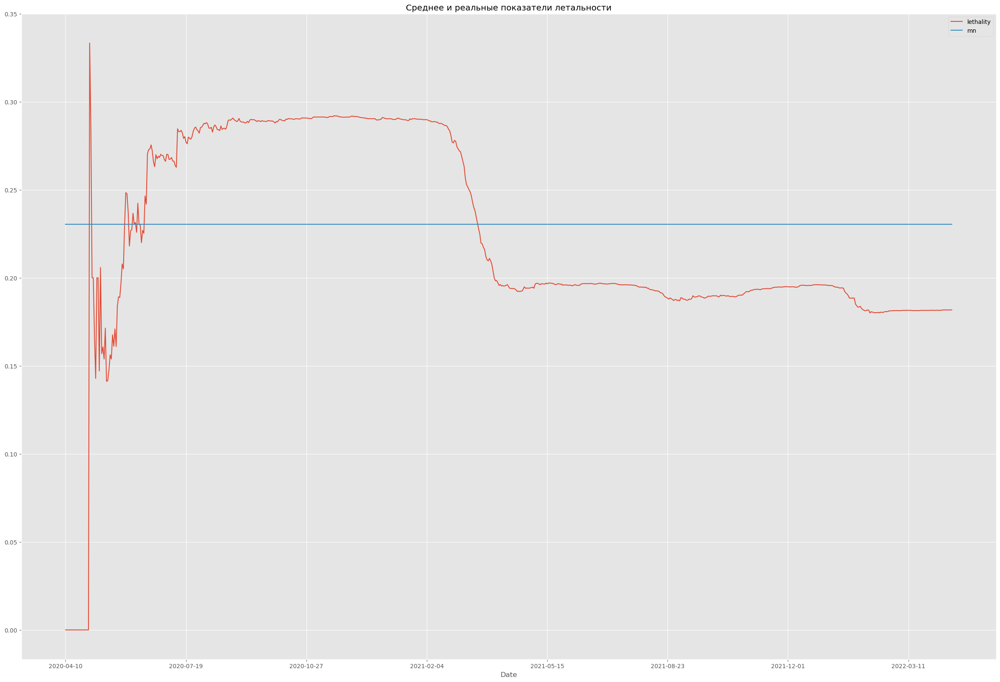

In [ ]:
dfyemen1.plot(kind='line', x='Date', y=['lethality', 'mn'])
plt.title('Среднее и реальные показатели летальности')

Text(0.5, 1.0, 'Тренировочная выборка и прогноз')

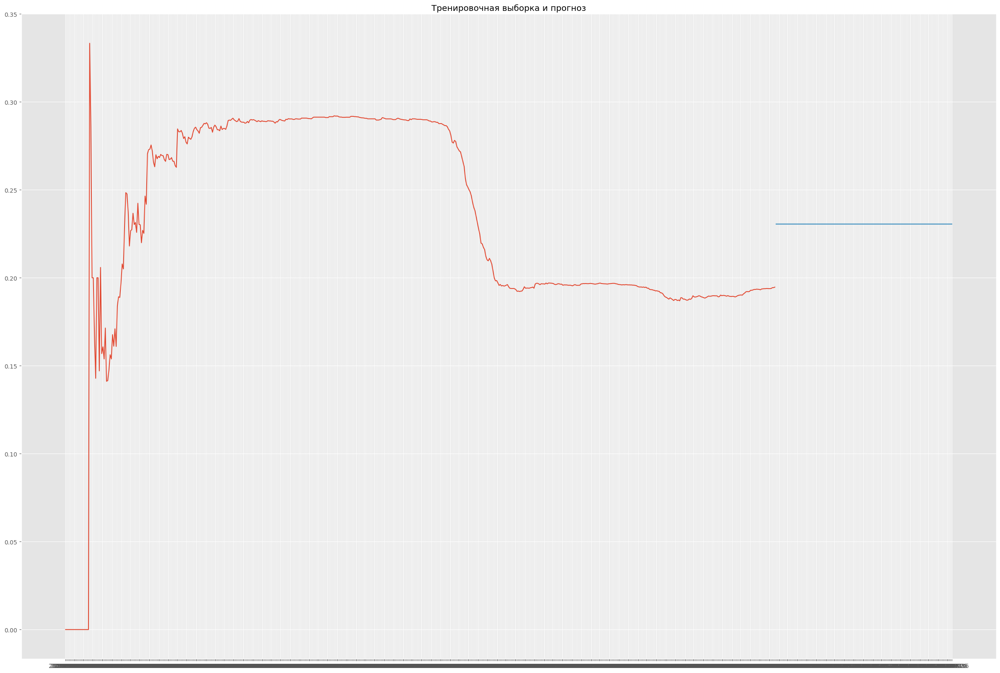

In [ ]:
plt.plot(trainye1.Date, trainye1.lethality)
plt.plot(testye1.Date, testye1.mn)
plt.title('Тренировочная выборка и прогноз')

Для Йемена прогноз хуже, чем для двух предыдущих стран

In [ ]:
mnye1rmse = RMSE(testye1.mn, testye1.lethality)
mnye1rmse

0.043722986120194846

In [ ]:
dfres.loc[0,'Yemen_RMSE'] = mnye1rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04


Другой временной промежуток

In [ ]:
mnru2 = trainru2.lethality.mean()

In [ ]:
mnru2ar = list()
for i in range(testru2.shape[0]):
    mnru2ar.append(mnru2)
testru2['mn'] = mnru2ar
dfrussia2['mn'] = mnru2
mnru2ar

[0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167,
 0.026281563536940167]

Text(0.5, 1.0, 'Среднее и реальные показатели летальности')

<Figure size 1000x2000 with 0 Axes>

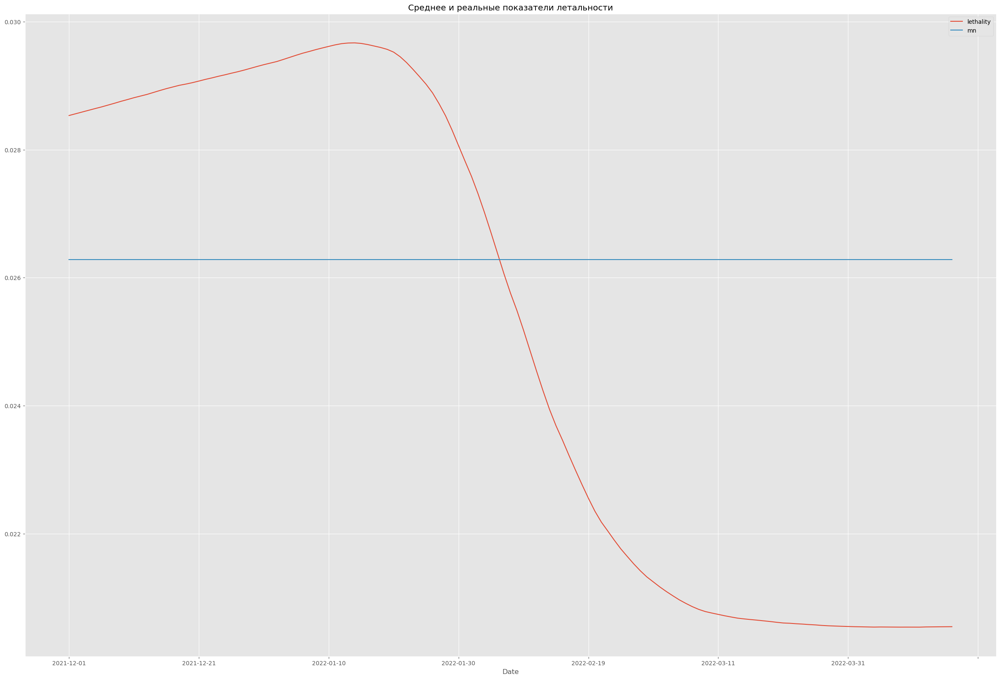

In [ ]:
plt.figure(figsize=(10, 20))
dfrussia2.plot(kind='line', x='Date', y=['lethality', 'mn'])
plt.title('Среднее и реальные показатели летальности')

Text(0.5, 1.0, 'Тренировочная выборка и прогноз')

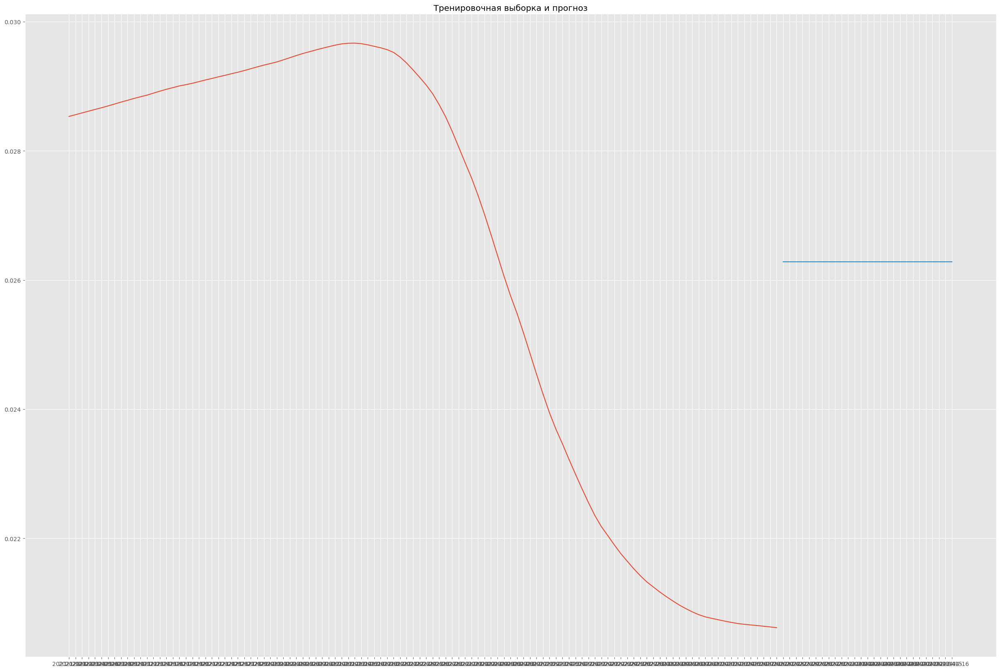

In [ ]:
plt.plot(trainru2.Date, trainru2.lethality)
plt.plot(testru2.Date, testru2.mn)
plt.title('Тренировочная выборка и прогноз')

In [ ]:
mnru2rmse = RMSE(testru2.mn, testru2.lethality)
mnru2rmse

0.005724702485752163

In [ ]:
dfres.loc[1,'Model'] = 'Mean2'
dfres.loc[1,'Russia_RMSE'] = mnru2rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,NaN,NaN


In [ ]:
mnind2 = trainind2.lethality.mean()

In [ ]:
mnind2ar = list()
for i in range(testind2.shape[0]):
    mnind2ar.append(mnind2)
testind2['mn'] = mnind2ar
dfindia2['mn'] = mnind2
mnind2ar

[0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244,
 0.01274082990579244]

Text(0.5, 1.0, 'Среднее и реальные показатели летальности')

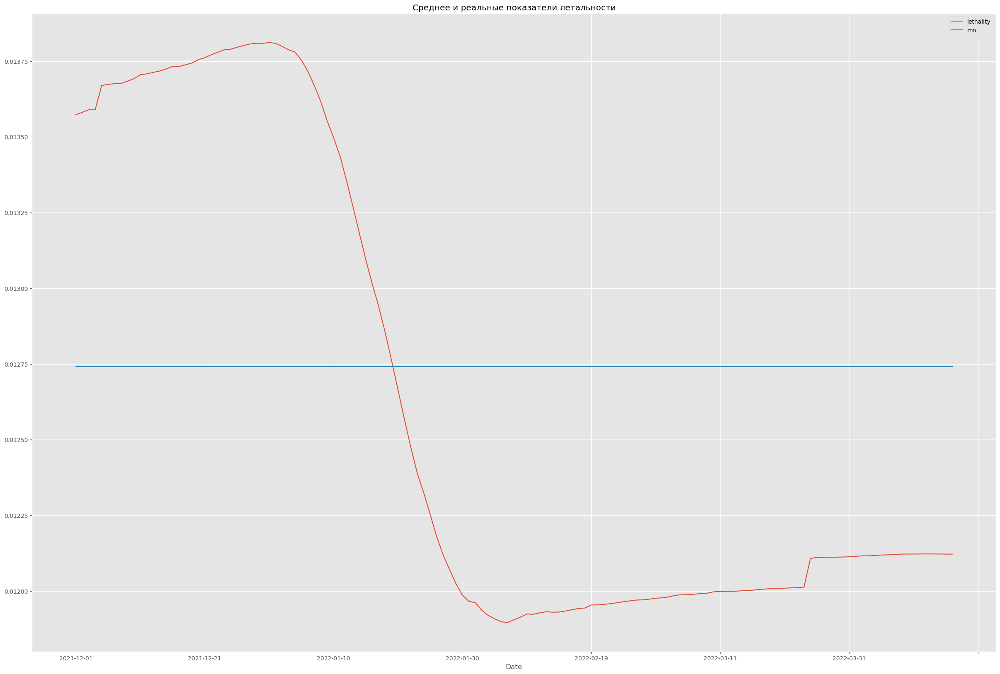

In [ ]:
dfindia2.plot(kind='line', x='Date', y=['lethality', 'mn'])
plt.title('Среднее и реальные показатели летальности')

Text(0.5, 1.0, 'Тренировочная выборка и прогноз')

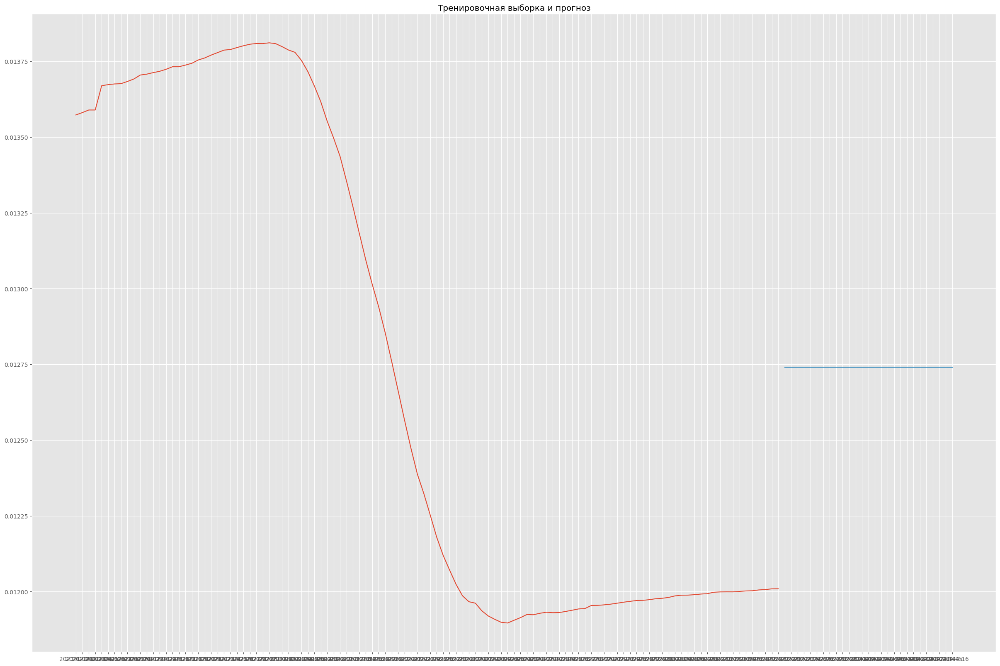

In [ ]:
plt.plot(trainind2.Date, trainind2.lethality)
plt.plot(testind2.Date, testind2.mn)
plt.title('Тренировочная выборка и прогноз')

In [ ]:
mnind2rmse = RMSE(testind2.mn, testind2.lethality)
mnind2rmse

0.0006401849313407285

In [ ]:
dfres.loc[1,'India_RMSE'] = mnind2rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,NaN


In [ ]:
mnye2 = trainye2.lethality.mean()

In [ ]:
mnye2ar = list()
for i in range(testye2.shape[0]):
    mnye2ar.append(mnye2)
testye2['mn'] = mnye2ar
dfyemen2['mn'] = mnye2
mnye2ar

[0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183,
 0.18803364655804183]

Text(0.5, 1.0, 'Среднее и реальные показатели летальности')

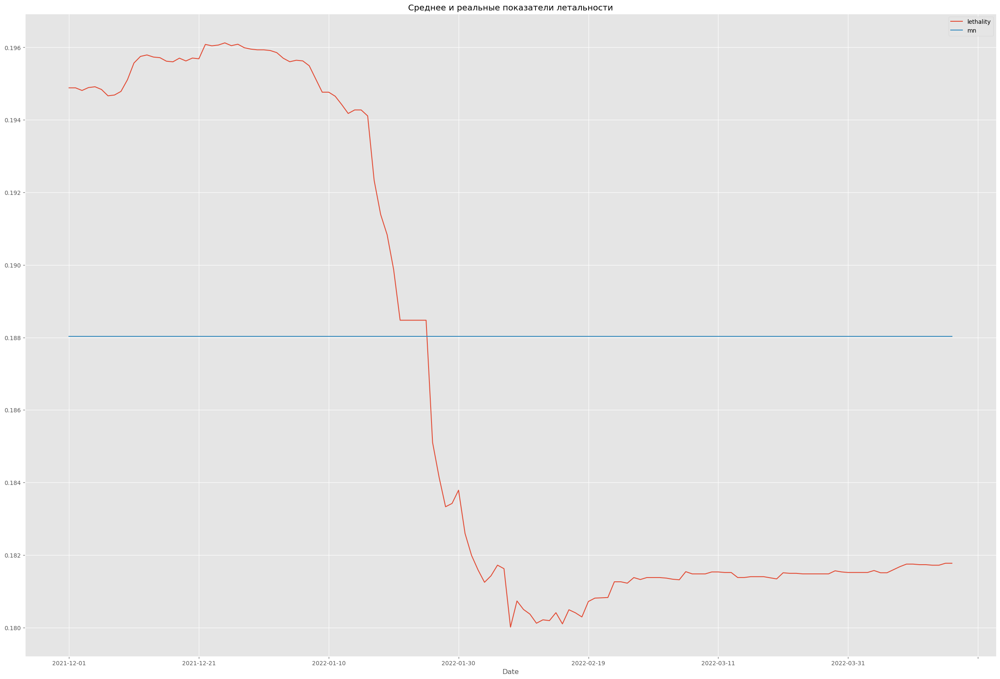

In [ ]:
dfyemen2.plot(kind='line', x='Date', y=['lethality', 'mn'])
plt.title('Среднее и реальные показатели летальности')

Text(0.5, 1.0, 'Тренировочная выборка и прогноз')

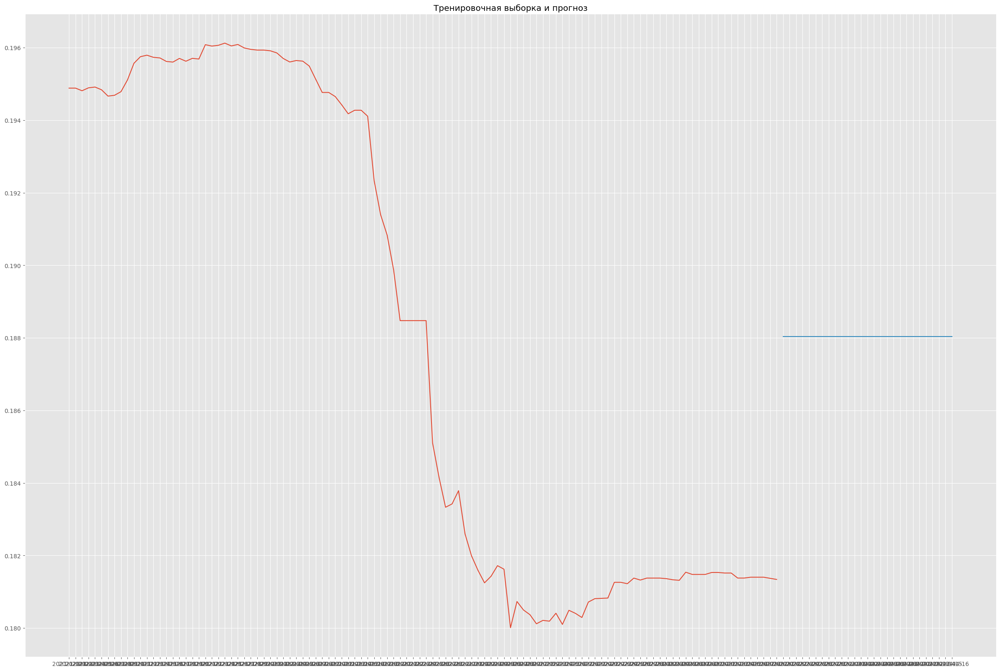

In [ ]:
plt.plot(trainye2.Date, trainye2.lethality)
plt.plot(testye2.Date, testye2.mn)
plt.title('Тренировочная выборка и прогноз')

In [ ]:
mnye2rmse = RMSE(testye2.mn, testye2.lethality)
mnye2rmse

0.006446538764160259

In [ ]:
dfres.loc[1,'Yemen_RMSE'] = mnye2rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01


Для более   меньшего периода на удивление плохо прогнозирует везде(

#### 3.2. Линейная модель (Linear Trend Model) (5 баллов)

Осуществите предсказание с помощью линейного тренда

In [ ]:
dfrussia1.Date.min()

'2020-01-31'

In [ ]:
dfrussia1.Date = pd.DatetimeIndex(dfrussia1.Date)

In [ ]:
dfrussia1['timeindex'] = (dfrussia1.Date - dfrussia1.Date.min()).astype(int)
trainru1 = dfrussia1.iloc[:646, :]
testru1 = dfrussia1.iloc[646:, :]

In [ ]:
moru1 = smf.ols('lethality ~ timeindex', data = trainru1).fit()
moru1.predict(testru1)

178543   0.03
178544   0.03
178545   0.03
178546   0.03
178547   0.03
         ... 
178699   0.04
178700   0.04
178701   0.04
178702   0.04
178703   0.04
Length: 161, dtype: float64

In [ ]:
predictionru1 = moru1.predict(testru1).values

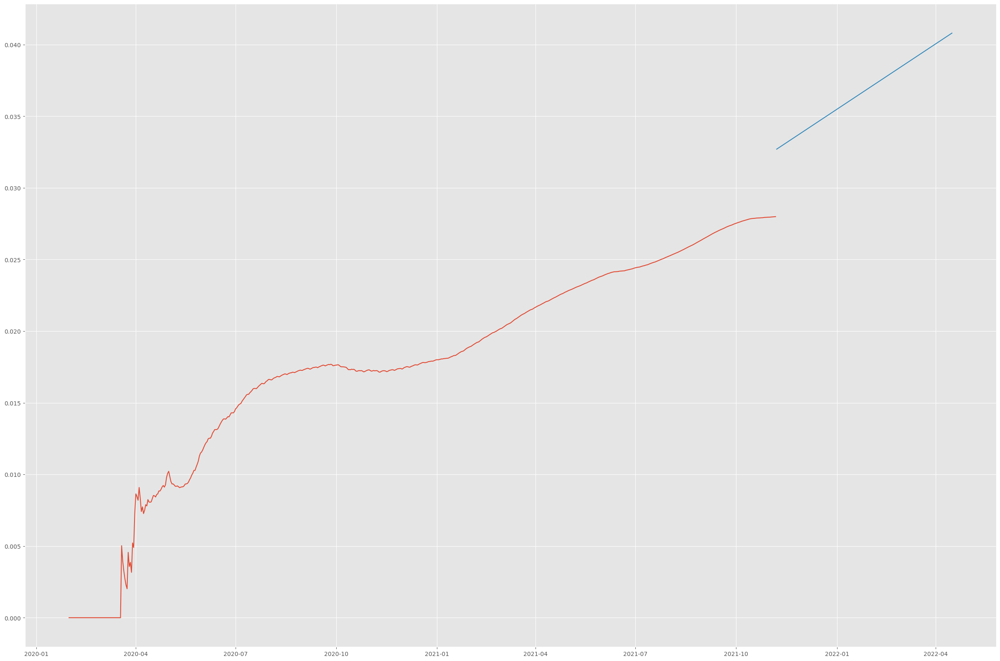

In [ ]:
plt.plot(trainru1.Date, trainru1['lethality'])
plt.plot(testru1.Date, predictionru1)

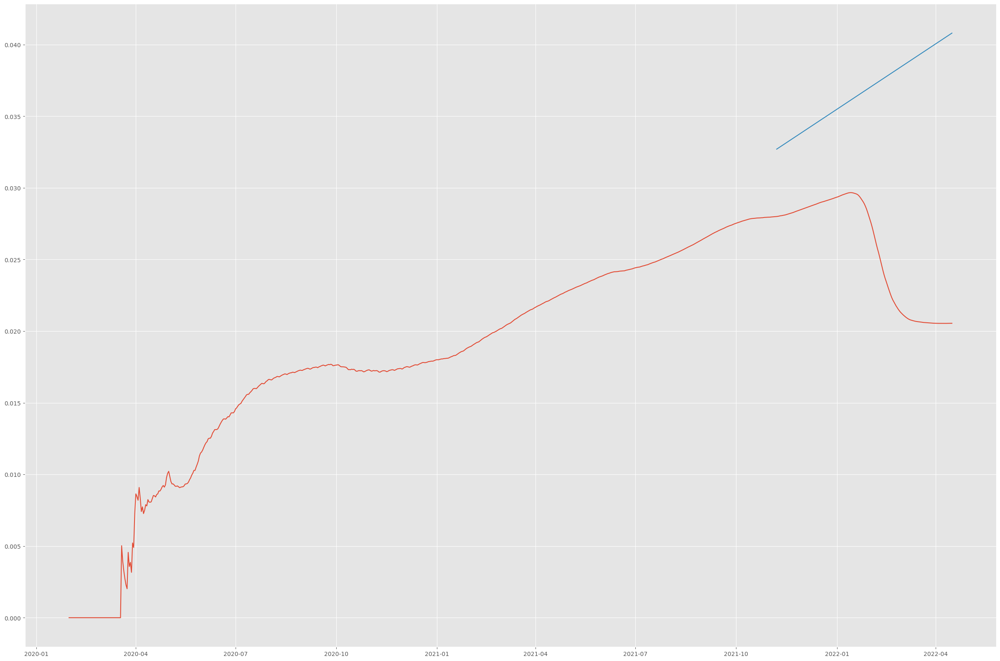

In [ ]:
plt.plot(dfrussia1.Date, dfrussia1['lethality'])
plt.plot(testru1.Date, predictionru1)

Как мы видим, предсказали не очень, поскольку никто не ожидал, что будет спад(

In [ ]:
lru1rmse = RMSE(predictionru1, testru1.lethality)
lru1rmse

0.012611996866269974

In [ ]:
dfres.loc[2,'Model'] = 'Linear1'
dfres.loc[2,'Russia_RMSE'] = lru1rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01
2,Linear1,0.01,NaN,NaN


In [ ]:
dfindia1.Date.min()

'2020-01-30'

In [ ]:
dfindia1.Date = pd.DatetimeIndex(dfindia1.Date)
dfindia1['timeindex'] = (dfindia1.Date - dfindia1.Date.min()).astype(int)
trainind1 = dfindia1.iloc[:646, :]
testind1 = dfindia1.iloc[646:, :]

In [ ]:
moind1 = smf.ols('lethality ~ timeindex', data = trainind1).fit()
moind1.predict(testind1)

121422   0.02
121423   0.02
121424   0.02
121425   0.02
121426   0.02
         ... 
121579   0.03
121580   0.03
121581   0.03
121582   0.03
121583   0.03
Length: 162, dtype: float64

In [ ]:
predictionind1 = moind1.predict(testind1).values

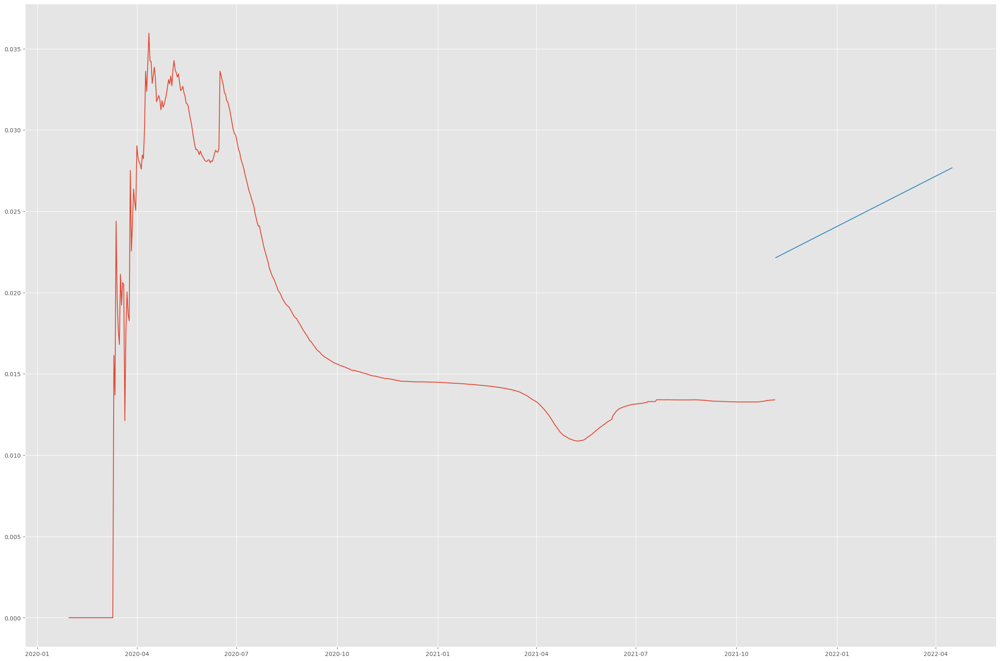

In [ ]:
plt.plot(trainind1.Date, trainind1['lethality'])
plt.plot(testind1.Date, predictionind1)

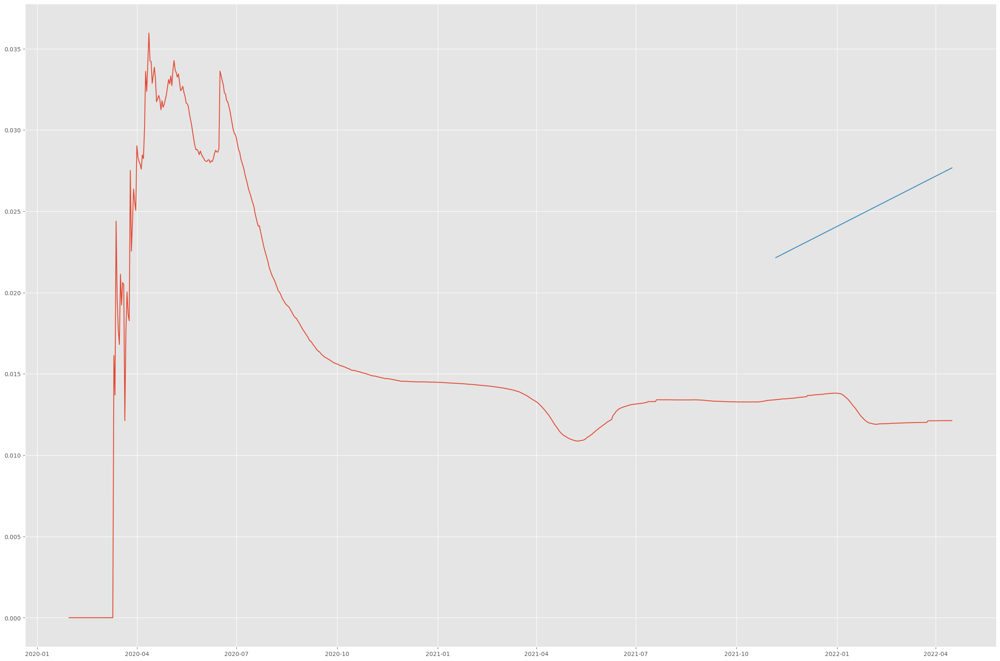

In [ ]:
plt.plot(dfindia1.Date, dfindia1['lethality'])
plt.plot(testind1.Date, predictionind1)

Предсказали не очень хорошо, был скорее спад и стабильность, чем сильный рост

In [ ]:
lind1rmse = RMSE(predictionind1, testind1.lethality)
lind1rmse

0.012374603338965872

In [ ]:
dfres.loc[2,'India_RMSE'] = lind1rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01
2,Linear1,0.01,0.01,NaN


In [ ]:
dfyemen1.Date.min()

'2020-04-10'

In [ ]:
dfyemen1.Date = pd.DatetimeIndex(dfyemen1.Date)
dfyemen1['timeindex'] = (dfyemen1.Date - dfyemen1.Date.min()).astype(int)
trainye1 = dfyemen1.iloc[:590, :]
testye1 = dfyemen1.iloc[590:, :]

In [ ]:
moye1 = smf.ols('lethality ~ timeindex', data = trainye1).fit()
moye1.predict(testye1)

229965   0.34
229966   0.34
229967   0.34
229968   0.34
229969   0.34
         ... 
230107   0.42
230108   0.42
230109   0.42
230110   0.42
230111   0.42
Length: 147, dtype: float64

In [ ]:
predictionye1 = moye1.predict(testye1).values

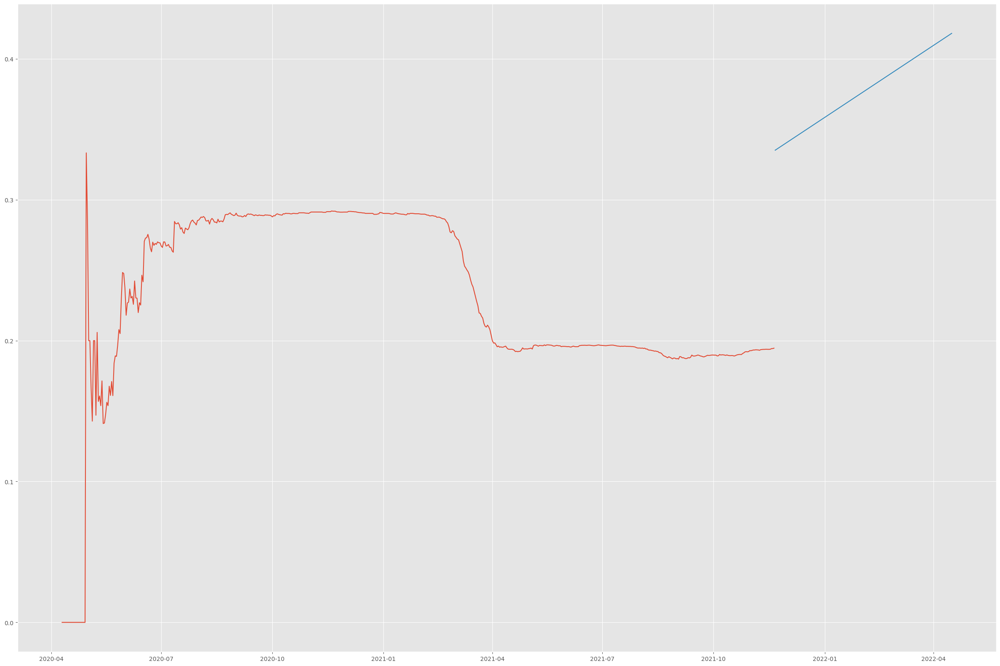

In [ ]:
plt.plot(trainye1.Date, trainye1['lethality'])
plt.plot(testye1.Date, predictionye1)

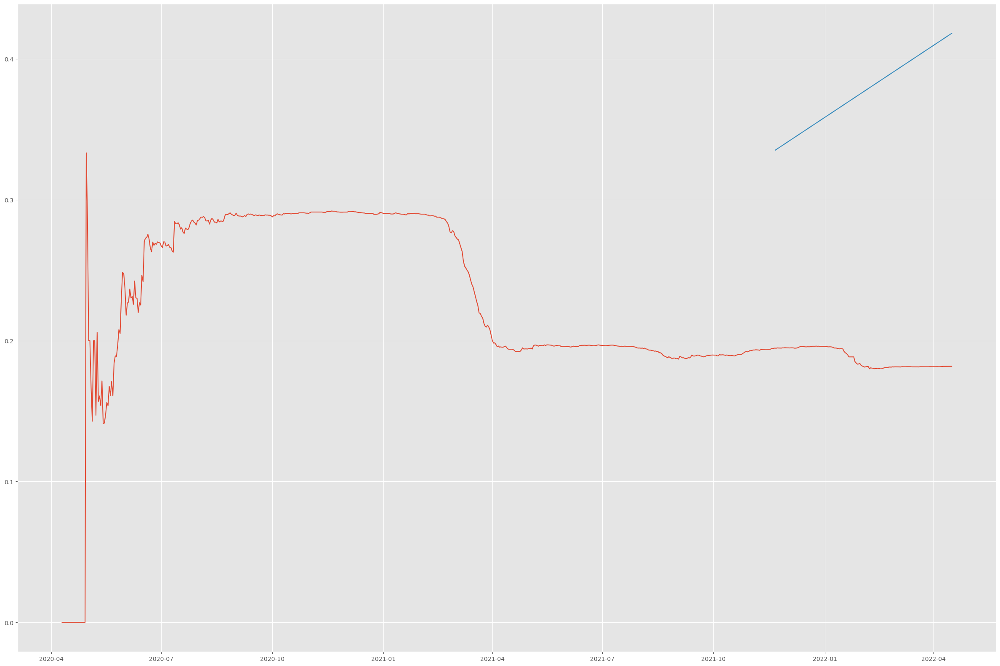

In [ ]:
plt.plot(dfyemen1.Date, dfyemen1['lethality'])
plt.plot(testye1.Date, predictionye1)

Снова не очень предсказали, опять скорее стабильность

In [ ]:
lye1rmse = RMSE(predictionye1, testye1.lethality)
lye1rmse

0.19176598852628873

In [ ]:
dfres.loc[2,'Yemen_RMSE'] = lye1rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01
2,Linear1,0.01,0.01,0.19


In [ ]:
dfrussia2.Date.min()

'2021-12-01'

In [ ]:
dfrussia2.Date = pd.DatetimeIndex(dfrussia2.Date)
dfrussia2['timeindex'] = (dfrussia2.Date - dfrussia2.Date.min()).astype(int)
trainru2 = dfrussia2.iloc[:110, :]
testru2 = dfrussia2.iloc[110:, :]

In [ ]:
moru2 = smf.ols('lethality ~ timeindex', data = trainru2).fit()
moru2.predict(testru2)

178677   0.04
178678   0.04
178679   0.04
178680   0.04
178681   0.04
178682   0.04
178683   0.04
178684   0.04
178685   0.04
178686   0.04
178687   0.04
178688   0.04
178689   0.04
178690   0.04
178691   0.04
178692   0.04
178693   0.04
178694   0.04
178695   0.04
178696   0.04
178697   0.04
178698   0.04
178699   0.04
178700   0.04
178701   0.04
178702   0.05
178703   0.05
dtype: float64

In [ ]:
predictionru2 = moru2.predict(testru2).values

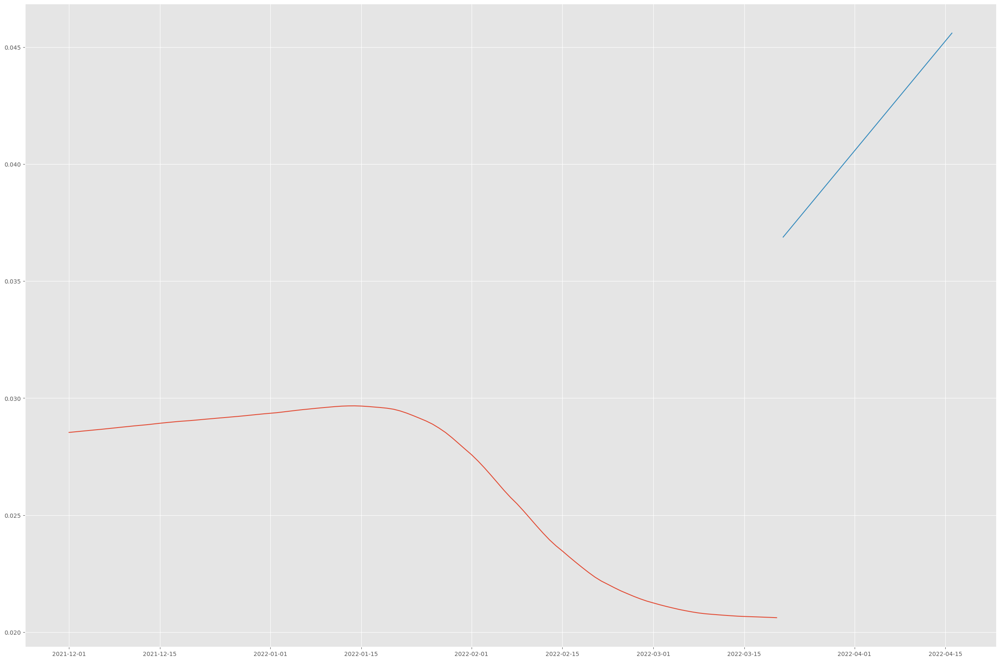

In [ ]:
plt.plot(trainru2.Date, trainru2['lethality'])
plt.plot(testru2.Date, predictionru2)

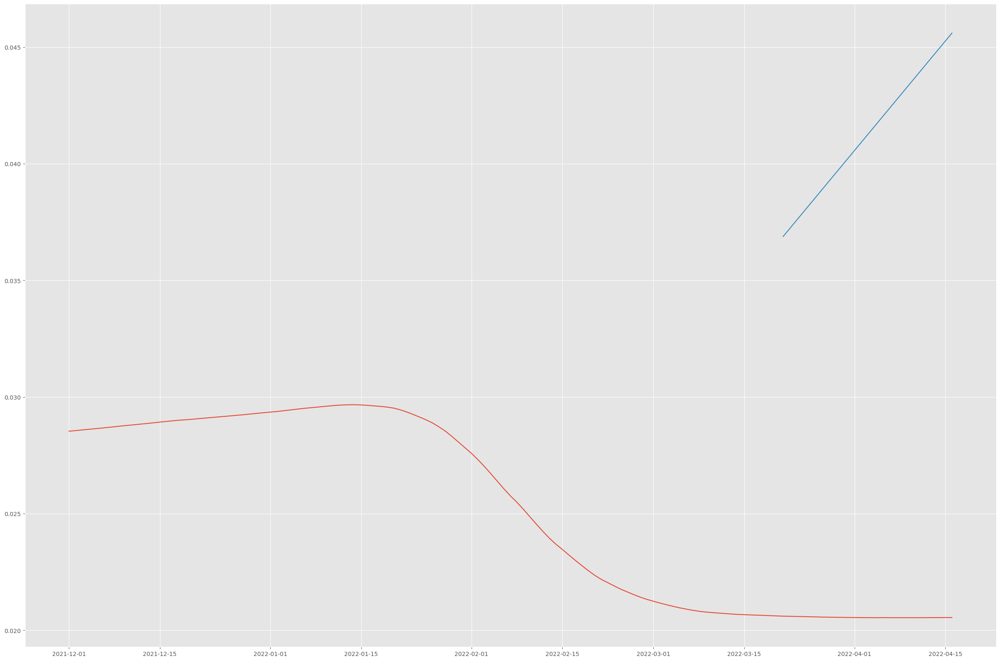

In [ ]:
plt.plot(dfrussia2.Date, dfrussia2['lethality'])
plt.plot(testru2.Date, predictionru2)

In [ ]:
lru2rmse = RMSE(predictionru2, testru2.lethality)
lru2rmse

0.020847062274069333

In [ ]:
dfres.loc[3,'Model'] = 'Linear2'
dfres.loc[3,'Russia_RMSE'] = lru2rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01
2,Linear1,0.01,0.01,0.19
3,Linear2,0.02,NaN,NaN


Предсказали не очень хорошо, вообще не попали

In [ ]:
dfindia2.Date.min()

'2021-12-01'

In [ ]:
dfindia2.Date = pd.DatetimeIndex(dfindia2.Date)
dfindia2['timeindex'] = (dfindia2.Date - dfindia2.Date.min()).astype(int)
trainind2 = dfindia2.iloc[:110, :]
testind2 = dfindia2.iloc[110:, :]

In [ ]:
moind2 = smf.ols('lethality ~ timeindex', data = trainind2).fit()
moind2.predict(testind2)

121557   0.02
121558   0.02
121559   0.02
121560   0.02
121561   0.02
121562   0.02
121563   0.02
121564   0.02
121565   0.02
121566   0.02
121567   0.02
121568   0.02
121569   0.02
121570   0.02
121571   0.02
121572   0.02
121573   0.02
121574   0.02
121575   0.02
121576   0.02
121577   0.02
121578   0.02
121579   0.02
121580   0.02
121581   0.02
121582   0.02
121583   0.02
dtype: float64

In [ ]:
predictionind2 = moind2.predict(testind2).values

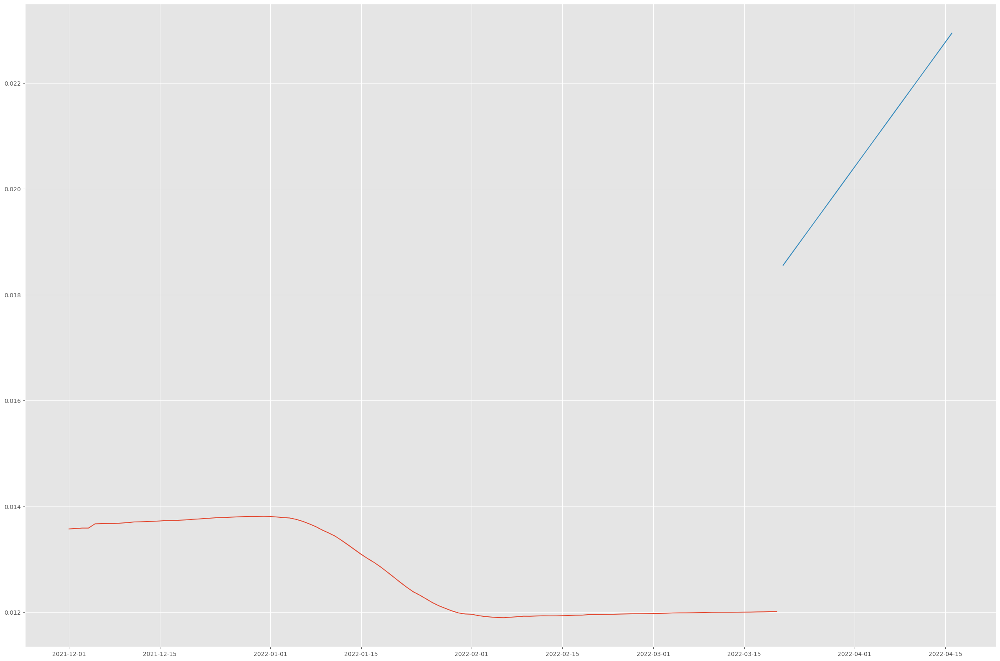

In [ ]:
plt.plot(trainind2.Date, trainind2['lethality'])
plt.plot(testind2.Date, predictionind2)

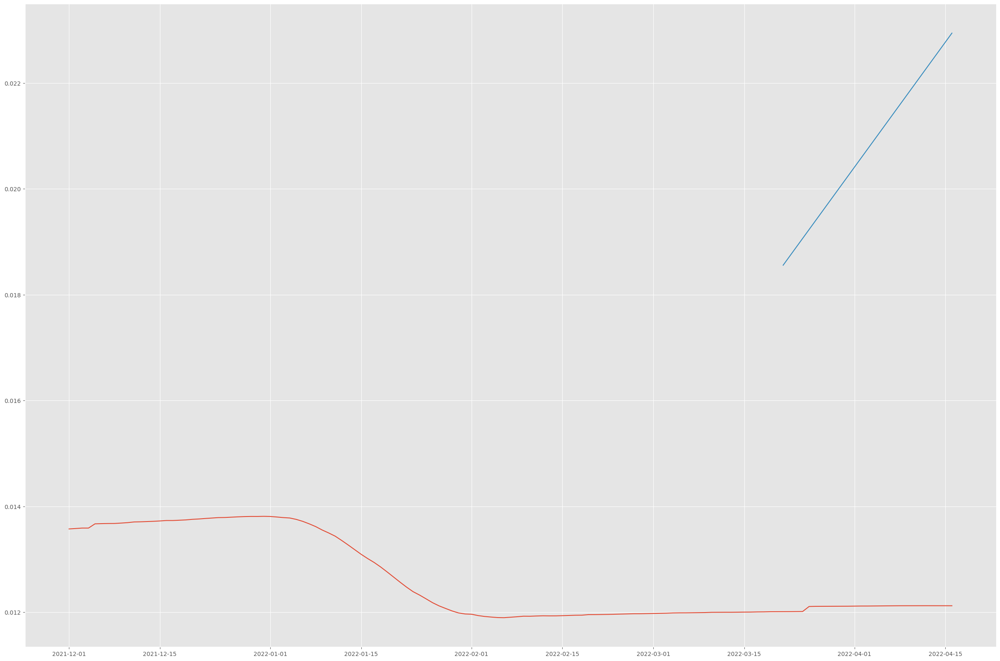

In [ ]:
plt.plot(dfindia2.Date, dfindia2['lethality'])
plt.plot(testind2.Date, predictionind2)

In [ ]:
lind2rmse = RMSE(predictionind2, testind2.lethality)
lind2rmse

0.00874253736285196

In [ ]:
dfres.loc[3,'India_RMSE'] = lind2rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01
2,Linear1,0.01,0.01,0.19
3,Linear2,0.02,0.01,NaN


Будем честны снова - вообще мимо

In [ ]:
dfyemen2.Date.min()

'2021-12-01'

In [ ]:
dfyemen2.Date = pd.DatetimeIndex(dfyemen2.Date)
dfyemen2['timeindex'] = (dfyemen2.Date - dfyemen2.Date.min()).astype(int)
trainye2 = dfyemen2.iloc[:110, :]
testye2 = dfyemen2.iloc[110:, :]

In [ ]:
moye2 = smf.ols('lethality ~ timeindex', data = trainye2).fit()
moye2.predict(testye2)

230085   0.28
230086   0.28
230087   0.28
230088   0.29
230089   0.29
230090   0.29
230091   0.29
230092   0.30
230093   0.30
230094   0.30
230095   0.30
230096   0.31
230097   0.31
230098   0.31
230099   0.31
230100   0.32
230101   0.32
230102   0.32
230103   0.32
230104   0.33
230105   0.33
230106   0.33
230107   0.33
230108   0.34
230109   0.34
230110   0.34
230111   0.34
dtype: float64

In [ ]:
predictionye2 = moye2.predict(testye2).values

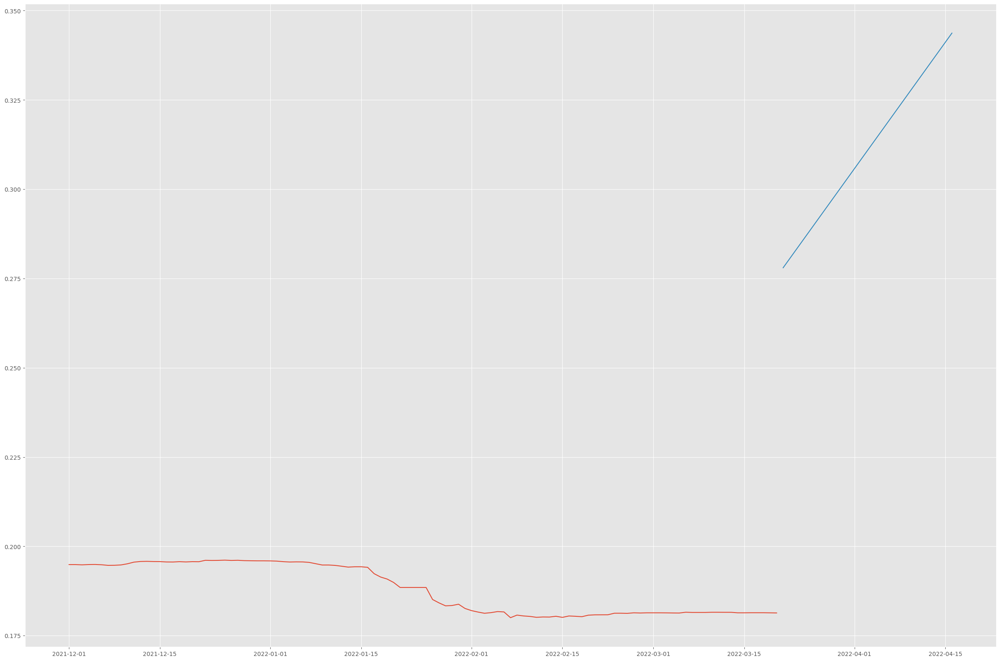

In [ ]:
plt.plot(trainye2.Date, trainye2['lethality'])
plt.plot(testye2.Date, predictionye2)

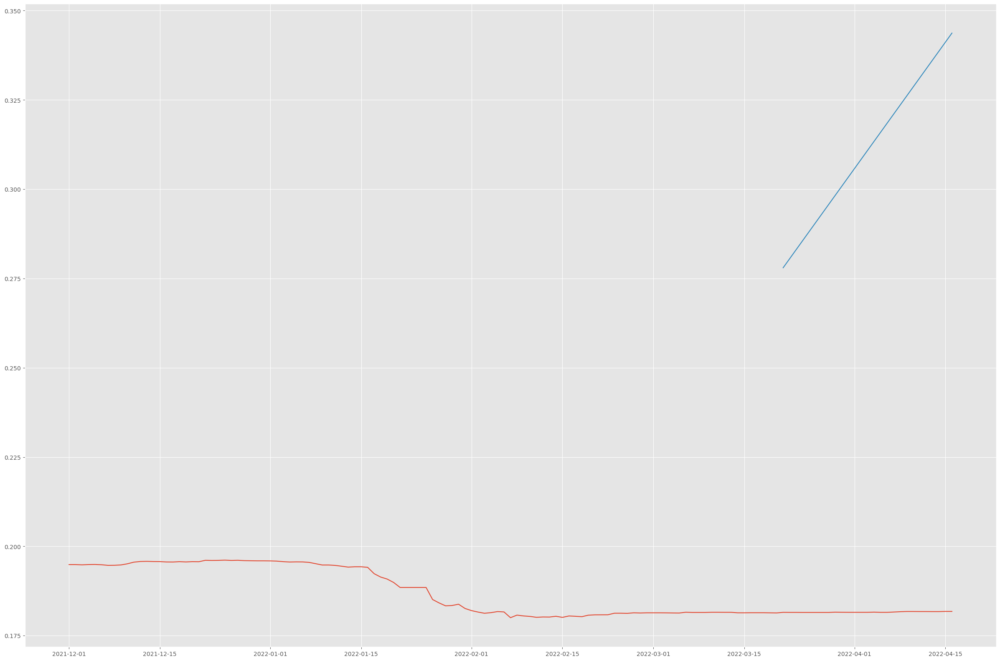

In [ ]:
plt.plot(dfyemen2.Date, dfyemen2['lethality'])
plt.plot(testye2.Date, predictionye2)

In [ ]:
lye2rmse = RMSE(predictionye2, testye2.lethality)
lye2rmse

0.1307417237689493

In [ ]:
dfres.loc[3,'Yemen_RMSE'] = lye2rmse
dfres.head()

,Model,Russia_RMSE,India_RMSE,Yemen_RMSE
0,Mean1,0.01,0.00,0.04
1,Mean2,0.01,0.00,0.01
2,Linear1,0.01,0.01,0.19
3,Linear2,0.02,0.01,0.13


Мимо мимо снова мимо, даже по rmse видно

#### 3.3. Скользящее среднее (MA - Moving average) (5 баллов)

Постройте предсказание с помощью модели MA. Обязательно поэкспериментируйте с гиперпараметрами модели (и опишите, что вы делаете)

#### 3.4. Авторегрессионная модель (AR - Autoregressive model) (5 баллов)

Постройте предсказание с помощью модели AR. Обязательно поэкспериментируйте с гиперпараметрами модели (и опишите, что вы делаете)

In [ ]:
# Ваш код здесь

#### 3.5. ARMA (5 баллов)

Постройте предсказание, скомбинировав модели AR и MA. Обязательно поэкспериментируйте с гиперпараметрами модели (и опишите, что вы делаете)

In [ ]:
# Ваш код здесь

#### 3.6. Интегрированная модель авторегрессии — скользящего среднего (Auto Regressive Integrated Moving Average) - ARIMA (5 баллов)

Постройте предсказание, модернизировав модель ARMA и добавив интегрирующую компоненту. Обязательно поэкспериментируйте с гиперпараметрами модели (и опишите, что вы делаете)

In [ ]:
from statsmodels.tsa.arima.model import ARIMA

#### 3.7. SARIMA (Seasonal Auto Regressive Integrated Moving Average) (5 баллов и 5 бонусных баллов)

Постройте предсказание, модернизировав модель ARIMA и добавив сезонную составляющую. Обязательно поэкспериментируйте с гиперпараметрами модели (и опишите, что вы делаете).

Бонусные баллы за это задание выставляются как совокупность за все задания по классам SARIMA (3.3 - 3.7), в случае если ваши модели получились хорошие, точные и вы верно настроили гиперпараметры, хорошо описав ваши действия.

*Примечание. Вы можете также почитать про Алгоритм Хиндмана-Хандакара для настройки SARIMA. Возможно, он сможет вам помочь и улучшить качество моделей*

In [ ]:
# Ваш код здесь

#### 3.8. ETS - Экспоненциальное сглаживание (Exponential smoothing) (15 баллов и 15 бонусных баллов)

Задание на основные баллы:

- Поработайте с классом моделей ETS (Exponential smoothing), подробно рассматривавшемся на лекции. Примените ETS(ANN), ETS(AAA) и еще минимум 3 любые (на ваш выбор) модели ETS. Осуществите настройку гиперпараметров во всех моделях. Сравните результаты между ними. Попробуйте объяснить, почему модели показывают такие результаты и такую разницу в результатах. Сделайте выводы.

Задания на бонусные баллы:

- Попробуйте теперь обучить ETS с автоматическим выбором по AIC (`AutoETS` в `sktime`). Что делает этот алгоритм? Что такое AIC? Какие результаты получаются? Сделайте выводы.

- Попробуйте также применить Double exponential smoothing и Triple exponential smoothing. Что это за модели? Какие результаты показывают они? Почему? Сделайте выводы.

- Нарисуйте для наилучшей модели предсказания **с доверительным интервалом** (если модель выдает его) и наложите их на истинные значения. В `sktime` `ETS` модель не выдает доверительные интервалы сразу, но при желании до них можно дотянуться!

In [ ]:
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.ets import AutoETS

In [ ]:
# Ваш код здесь

#### 3.9. KTR из orbit (8 бонусных баллов).

Попробуйте использовать модель KTR из библиотеки orbit для предсказания временных рядов.



In [ ]:
from orbit.models.ktrlite import KTRLite

In [ ]:
# Ваш код здесь

#### 3.10. Библиотека Prophet (10 бонусных баллов)
Попробуйте использовать библиотеку Prophet для предсказания временных рядов. [Документация](https://facebook.github.io/prophet/docs/quick_start.html).

Нарисуйте для наилучшей модели предсказания с доверительным интервалом (если модель выдает его) и наложите их на истинные значения.


In [ ]:
from prophet import Prophet

In [ ]:
# Ваш код здесь

#### 3.11 Линейная модель с регрессией (Linear Regression Model) (5 баллов и 10 бонусных баллов)

Примените линейную модель с регрессией для предсказания временных рядов.
Какие признаки оказались наиболее значимыми? Почему? Как вы это интерпретируете? Какие выводы можно сделать?

*Примечание. Это задание идет в тесной связке с заданием 1.8.*



In [ ]:
# Ваш код здесь

#### 3.12. Дополнительная модель (10 бонусных баллов)

Используйте еще одну какую-нибудь любую другую известную вам модель для предсказания временных рядов и заработайте дополнительные бонусные баллы!

In [ ]:
# Ваш код здесь

#### 3.13 Выводы (5 баллов)

Выведите все построенные вами модели на одних осях. Выведите общую сравнительную табличку по всем моделям, которые вы оценивали. Какие выводы вы можете сделать? Какая модель показала себя лучше всего? Как вы думаете почему? Одинаковые ли результаты эффективности получились у моделей на разных временных рядах? Какие итоги вы можете подвести по сравнению моделей друг с другом?


Вывод: почему-то метод по среднему почти везде лучше апроксимирует, чем линейный и оба работают менее точно для более маленькой выборки

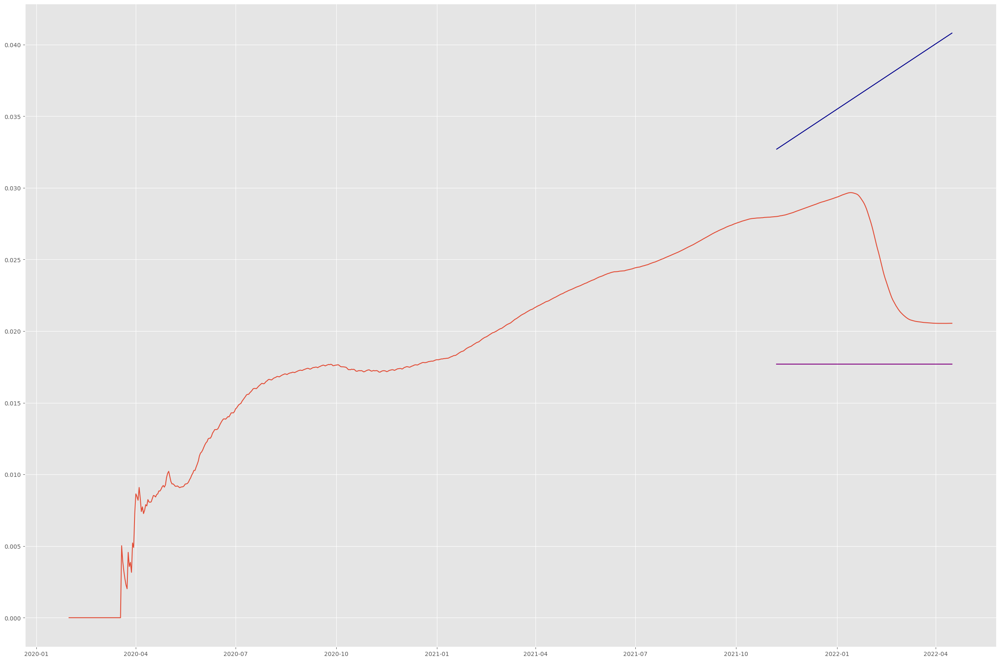

In [ ]:
plt.plot(dfrussia1.Date, dfrussia1['lethality'])
plt.plot(testru1.Date, predictionru1, color='darkblue')
plt.plot(testru1.Date, testru1.mn, color='purple')

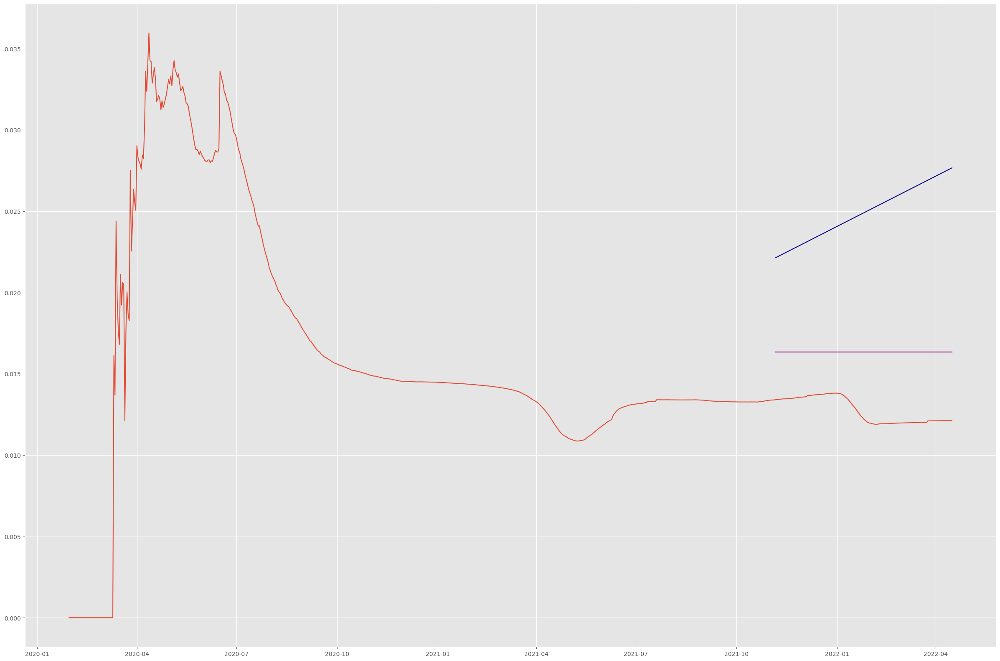

In [ ]:
plt.plot(dfindia1.Date, dfindia1['lethality'])
plt.plot(testind1.Date, predictionind1, color='darkblue')
plt.plot(testind1.Date, testind1.mn, color='purple')

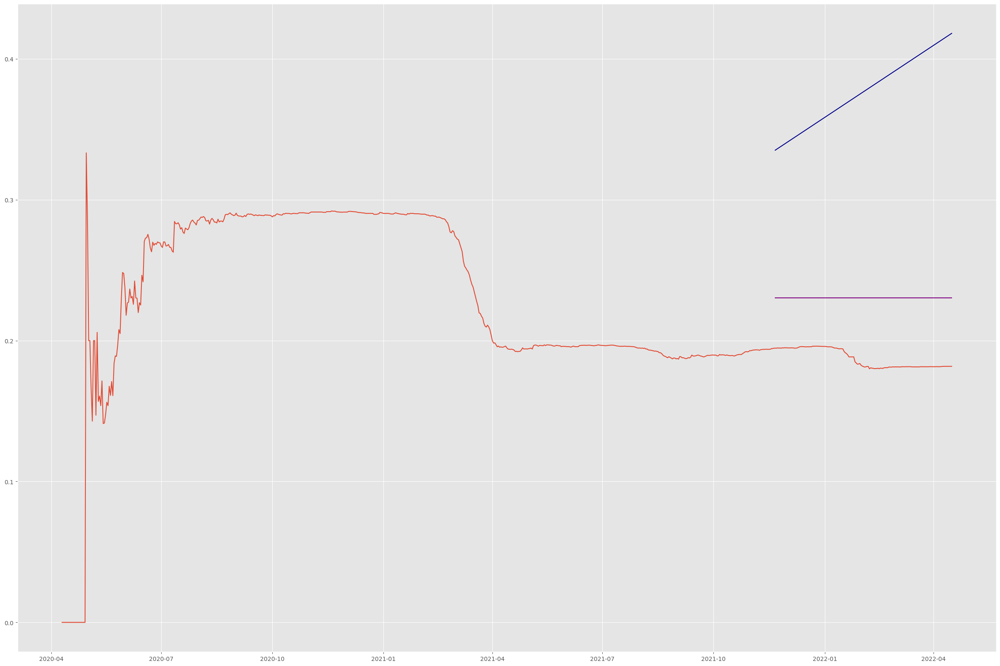

In [ ]:
plt.plot(dfyemen1.Date, dfyemen1['lethality'])
plt.plot(testye1.Date, predictionye1, color='darkblue')
plt.plot(testye1.Date, testye1.mn, color='purple')

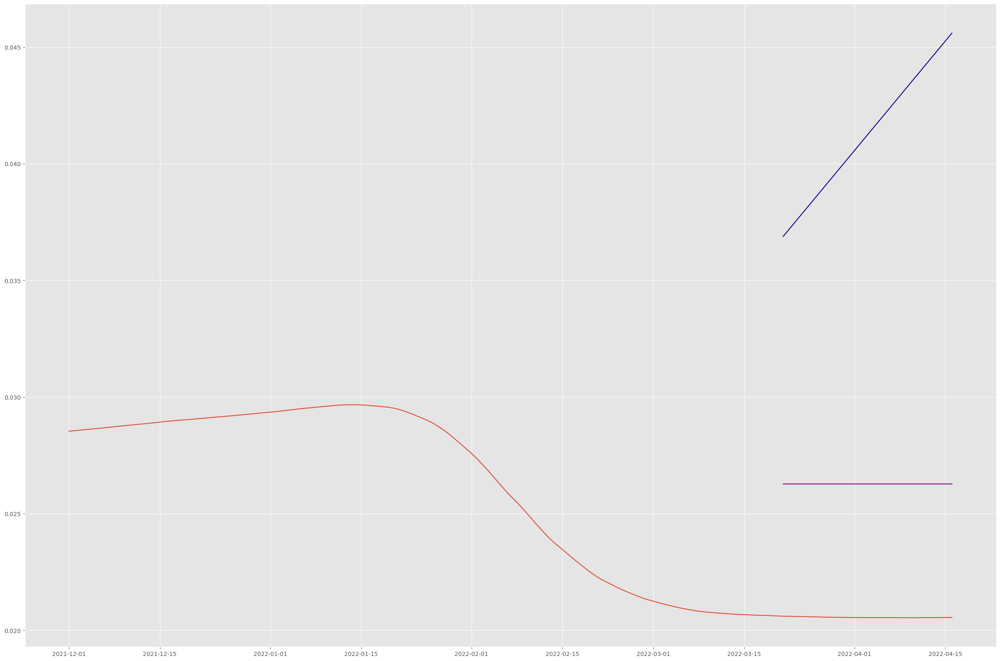

In [ ]:
plt.plot(dfrussia2.Date, dfrussia2['lethality'])
plt.plot(testru2.Date, predictionru2, color='darkblue')
plt.plot(testru2.Date, testru2.mn, color='purple')

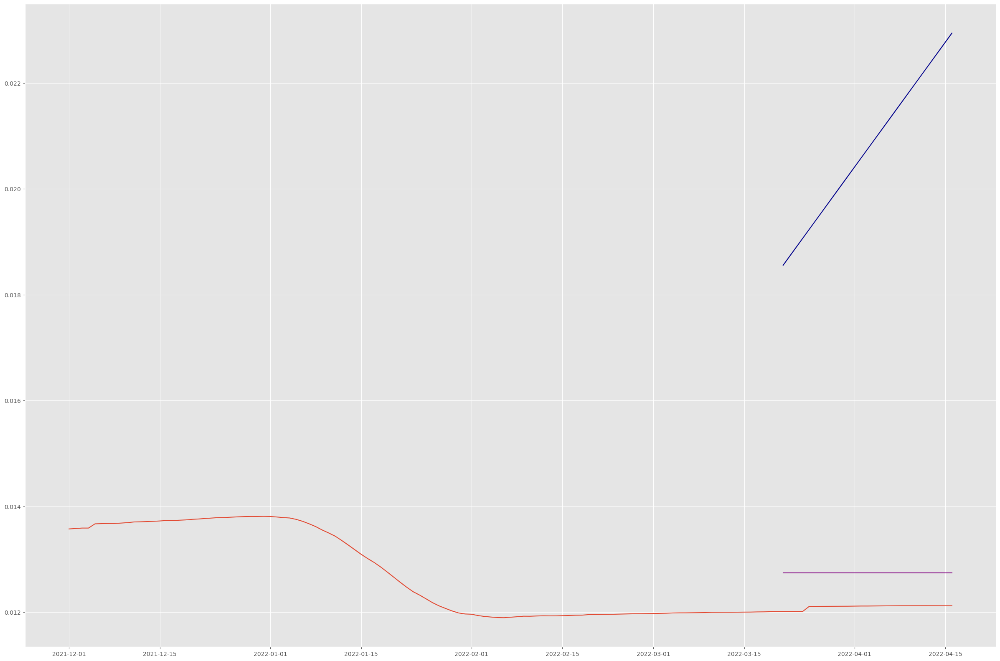

In [ ]:
plt.plot(dfindia2.Date, dfindia2['lethality'])
plt.plot(testind2.Date, predictionind2, color='darkblue')
plt.plot(testind2.Date, testind2.mn, color='purple')

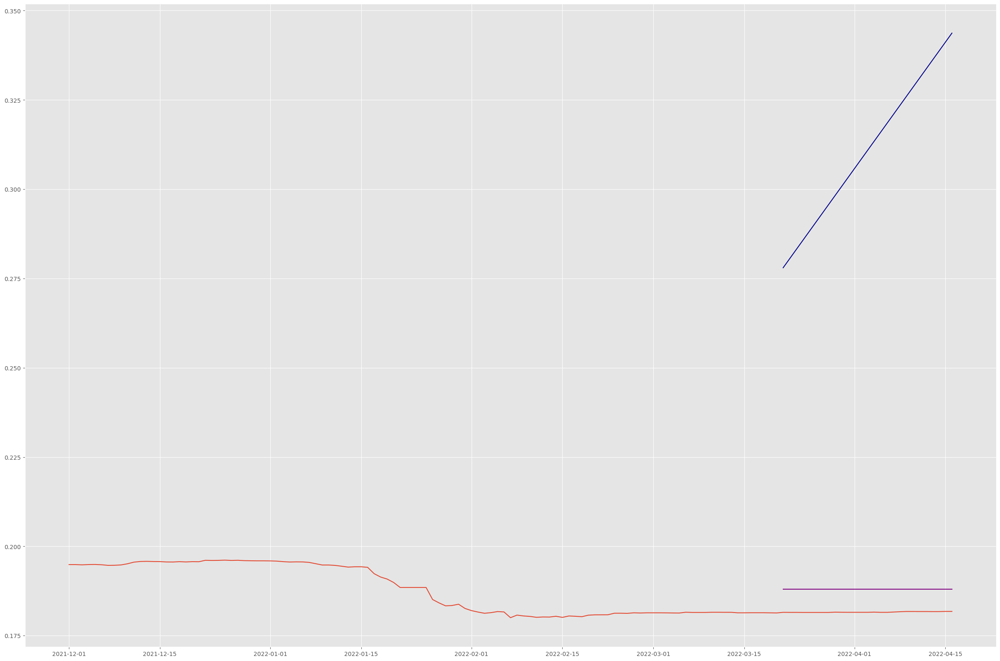

In [ ]:
plt.plot(dfyemen2.Date, dfyemen2['lethality'])
plt.plot(testye2.Date, predictionye2, color='darkblue')
plt.plot(testye2.Date, testye2.mn, color='purple')

## Выводы по работе (5 баллов)

Напишите итоговые выводы по всему проделанному исследованию. С какими данными (временными рядами) вам понравилось работать, а с какими нет? Какие модели показались вам простыми и удобными, а какие менее понравились? Выявили ли вы какие-то закономерности в применимости моделей? Если в ходе работы, вы пробовали где-то разные варианты, разные подходы, и это не попало в описание предыдущих действий, опишите их тут. Что можно сказать в целом о том, как мы решили задачу, изначально поставленную перед нами? Подведите окончательные итоги

🥰🤪🤩🥲🫡

Ну коронавирус быстро развивался , много людей болело....
Если серьезно, то по графикам подтверждения случаев можно наблюдать характерные скачки и спады, которые формируют "волны" пандемии в каждой стране.

Летальность выше всего в Южной Америке и Азии, в Европе он начал распространяться так же быстро как и в Азии, но к концу рассматриваемого периода почти все европейские страны уступили места странам с других континетов.


Несмотря на то, что пандемия началась в Китае, там ее распространение не такое быстрое как в той же Индии.

Прогнозировать средним и линейной моделью летальность и прирост заболевших неприятно и практически невозможно, но среднее неплохо приближает конец периода, поскольку в тот момент почти во всех странах идет спад пандемии и значения не изменяются.

Понравилось работать с агрегирующей функцией и гроуп бай, потому что думать не надо, а когда не надо - всегда приятно. Вообще еще подбирать цвета на карте было интересным занятием

Модели одинаково алгоритмично применяются и даже по тому, когда пишешь код -  понятно, что линия среднего или апроксимирующая линия не будут нормально предсказывать(
